# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [1]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [2]:
!mkdir data

mkdir: cannot create directory ‘data’: File exists


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [3]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Testing Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [4]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

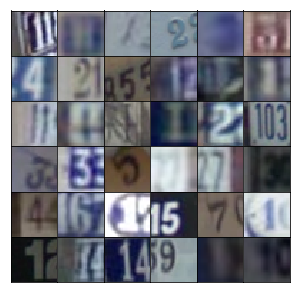

In [5]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [6]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [7]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs

Here, just creating some placeholders like normal.

In [8]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3. 

>**Exercise:** Build the transposed convolutional network for the generator in the function below. Be sure to use leaky ReLUs on all the layers except for the last tanh layer, as well as batch normalization on all the transposed convolutional layers except the last one.

In [9]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        # First fully connected layer
        x1 = tf.layers.dense(z, 4*4*512)
        # Reshape it to start the convolutional stack
        x1 = tf.reshape(x1, (-1, 4, 4, 512))
        x1 = tf.layers.batch_normalization(x1, training=training)
        x1 = tf.maximum(alpha * x1, x1)
        # 4x4x512 now
        
        x2 = tf.layers.conv2d_transpose(x1, 256, 5, strides=2, padding='same')
        x2 = tf.layers.batch_normalization(x2, training=training)
        x2 = tf.maximum(alpha * x2, x2)
        # 8x8x256 now
        
        x3 = tf.layers.conv2d_transpose(x2, 128, 5, strides=2, padding='same')
        x3 = tf.layers.batch_normalization(x3, training=training)
        x3 = tf.maximum(alpha * x3, x3)
        # 16x16x128 now
        
        # Output layer
        logits = tf.layers.conv2d_transpose(x3, output_dim, 5, strides=2, padding='same')
        # 32x32x3 now
        
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've built before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU.

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

>**Exercise:** Build the convolutional network for the discriminator. The input is a 32x32x3 images, the output is a sigmoid plus the logits. Again, use Leaky ReLU activations and batch normalization on all the layers except the first.

In [10]:
def discriminator(x, reuse=False, alpha=0.2):
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 32x32x3
        x1 = tf.layers.conv2d(x, 64, 5, strides=2, padding='same')
        relu1 = tf.maximum(alpha * x1, x1)
        # 16x16x64
        
        x2 = tf.layers.conv2d(relu1, 128, 5, strides=2, padding='same')
        bn2 = tf.layers.batch_normalization(x2, training=True)
        relu2 = tf.maximum(alpha * bn2, bn2)
        # 8x8x128
        
        x3 = tf.layers.conv2d(relu2, 256, 5, strides=2, padding='same')
        bn3 = tf.layers.batch_normalization(x3, training=True)
        relu3 = tf.maximum(alpha * bn3, bn3)
        # 4x4x256

        # Flatten it
        flat = tf.reshape(relu3, (-1, 4*4*256))
        logits = tf.layers.dense(flat, 1)
        out = tf.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [11]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [12]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [13]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=0.2)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

Here is a function for displaying generated images.

In [14]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an error without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [15]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very sensitive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

>**Exercise:** Find hyperparameters to train this GAN. The values found in the DCGAN paper work well, or you can experiment on your own. In general, you want the discriminator loss to be around 0.3, this means it is correctly classifying images as fake or real about 50% of the time.

In [ ]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.0002
batch_size = 128
epochs = 25
alpha = 0.2
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/25... Discriminator Loss: 1.0932... Generator Loss: 0.9761
Epoch 1/25... Discriminator Loss: 0.3748... Generator Loss: 1.9569
Epoch 1/25... Discriminator Loss: 0.1022... Generator Loss: 3.8119
Epoch 1/25... Discriminator Loss: 0.1322... Generator Loss: 2.7757
Epoch 1/25... Discriminator Loss: 0.1484... Generator Loss: 2.9962
Epoch 1/25... Discriminator Loss: 0.1203... Generator Loss: 2.7670
Epoch 1/25... Discriminator Loss: 0.1088... Generator Loss: 3.2197
Epoch 1/25... Discriminator Loss: 0.1100... Generator Loss: 3.3774
Epoch 1/25... Discriminator Loss: 0.0744... Generator Loss: 3.5813
Epoch 1/25... Discriminator Loss: 0.5907... Generator Loss: 1.2033


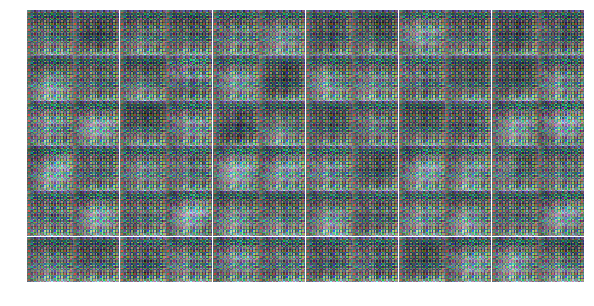

Epoch 1/25... Discriminator Loss: 1.4819... Generator Loss: 0.9238
Epoch 1/25... Discriminator Loss: 0.6320... Generator Loss: 1.5258
Epoch 1/25... Discriminator Loss: 0.6826... Generator Loss: 1.1982
Epoch 1/25... Discriminator Loss: 0.5934... Generator Loss: 1.1281
Epoch 1/25... Discriminator Loss: 0.7625... Generator Loss: 1.2568
Epoch 1/25... Discriminator Loss: 0.6903... Generator Loss: 1.5580
Epoch 1/25... Discriminator Loss: 0.4608... Generator Loss: 1.9528
Epoch 1/25... Discriminator Loss: 0.9580... Generator Loss: 0.6802
Epoch 1/25... Discriminator Loss: 0.3581... Generator Loss: 2.0004
Epoch 1/25... Discriminator Loss: 1.3792... Generator Loss: 3.3202


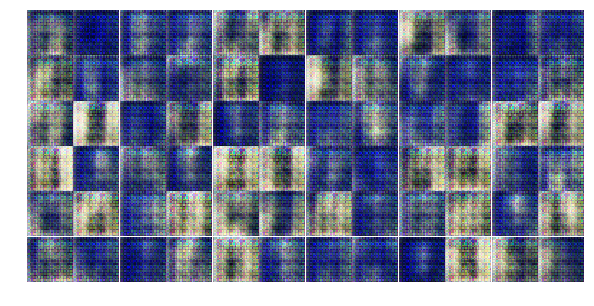

Epoch 1/25... Discriminator Loss: 0.3476... Generator Loss: 2.2835
Epoch 1/25... Discriminator Loss: 0.4237... Generator Loss: 2.6055
Epoch 1/25... Discriminator Loss: 0.6693... Generator Loss: 1.0578
Epoch 1/25... Discriminator Loss: 0.1543... Generator Loss: 2.6084
Epoch 1/25... Discriminator Loss: 2.4378... Generator Loss: 7.0369
Epoch 1/25... Discriminator Loss: 0.2740... Generator Loss: 2.9607
Epoch 1/25... Discriminator Loss: 0.5767... Generator Loss: 1.8755
Epoch 1/25... Discriminator Loss: 0.6565... Generator Loss: 2.7629
Epoch 1/25... Discriminator Loss: 0.9918... Generator Loss: 0.9378
Epoch 1/25... Discriminator Loss: 0.3880... Generator Loss: 2.2578


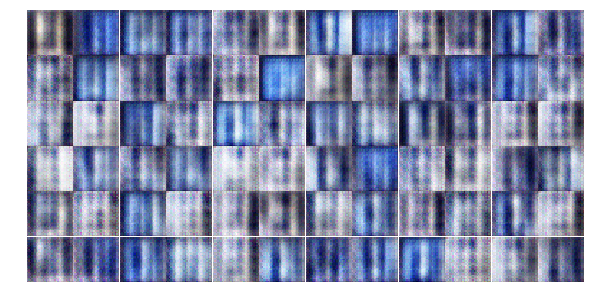

Epoch 1/25... Discriminator Loss: 0.4289... Generator Loss: 1.7876
Epoch 1/25... Discriminator Loss: 0.3359... Generator Loss: 2.0822
Epoch 1/25... Discriminator Loss: 0.3675... Generator Loss: 1.9036
Epoch 1/25... Discriminator Loss: 0.8577... Generator Loss: 0.9828
Epoch 1/25... Discriminator Loss: 0.5702... Generator Loss: 1.5416
Epoch 1/25... Discriminator Loss: 0.4075... Generator Loss: 2.3421
Epoch 1/25... Discriminator Loss: 1.2632... Generator Loss: 0.4807
Epoch 1/25... Discriminator Loss: 0.5605... Generator Loss: 1.9565
Epoch 1/25... Discriminator Loss: 0.5080... Generator Loss: 2.0252
Epoch 1/25... Discriminator Loss: 0.4424... Generator Loss: 1.7940


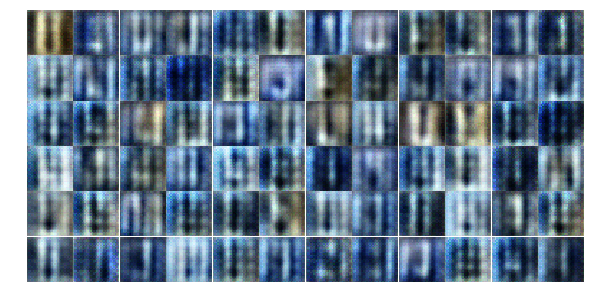

Epoch 1/25... Discriminator Loss: 0.4761... Generator Loss: 2.4423
Epoch 1/25... Discriminator Loss: 0.7092... Generator Loss: 1.1234
Epoch 1/25... Discriminator Loss: 0.4344... Generator Loss: 2.2649
Epoch 1/25... Discriminator Loss: 0.4928... Generator Loss: 1.6559
Epoch 1/25... Discriminator Loss: 0.8179... Generator Loss: 1.1973
Epoch 1/25... Discriminator Loss: 0.8660... Generator Loss: 0.8342
Epoch 1/25... Discriminator Loss: 0.7631... Generator Loss: 1.3368
Epoch 1/25... Discriminator Loss: 0.5891... Generator Loss: 1.7695
Epoch 1/25... Discriminator Loss: 0.5037... Generator Loss: 1.9760
Epoch 1/25... Discriminator Loss: 0.5271... Generator Loss: 1.8902


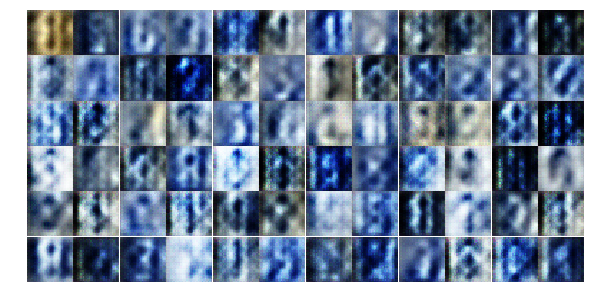

Epoch 1/25... Discriminator Loss: 0.4821... Generator Loss: 1.6741
Epoch 1/25... Discriminator Loss: 1.6705... Generator Loss: 0.3315
Epoch 1/25... Discriminator Loss: 0.5562... Generator Loss: 1.8282
Epoch 1/25... Discriminator Loss: 0.7623... Generator Loss: 1.1377
Epoch 1/25... Discriminator Loss: 0.4249... Generator Loss: 1.6550
Epoch 1/25... Discriminator Loss: 0.6503... Generator Loss: 1.6141
Epoch 1/25... Discriminator Loss: 0.6344... Generator Loss: 1.8906
Epoch 2/25... Discriminator Loss: 0.9858... Generator Loss: 1.5343
Epoch 2/25... Discriminator Loss: 0.8060... Generator Loss: 2.0517
Epoch 2/25... Discriminator Loss: 0.9377... Generator Loss: 0.8080


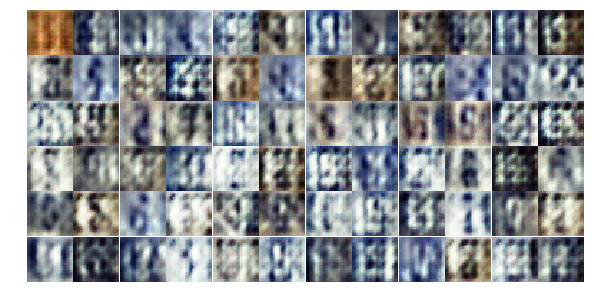

Epoch 2/25... Discriminator Loss: 1.0758... Generator Loss: 0.6961
Epoch 2/25... Discriminator Loss: 1.1280... Generator Loss: 1.0914
Epoch 2/25... Discriminator Loss: 1.0453... Generator Loss: 0.8745
Epoch 2/25... Discriminator Loss: 0.7644... Generator Loss: 1.4360
Epoch 2/25... Discriminator Loss: 0.9440... Generator Loss: 1.0418
Epoch 2/25... Discriminator Loss: 1.2057... Generator Loss: 0.8998
Epoch 2/25... Discriminator Loss: 1.1538... Generator Loss: 1.0832
Epoch 2/25... Discriminator Loss: 0.8641... Generator Loss: 1.2981
Epoch 2/25... Discriminator Loss: 0.7783... Generator Loss: 1.2733
Epoch 2/25... Discriminator Loss: 0.9641... Generator Loss: 0.9924


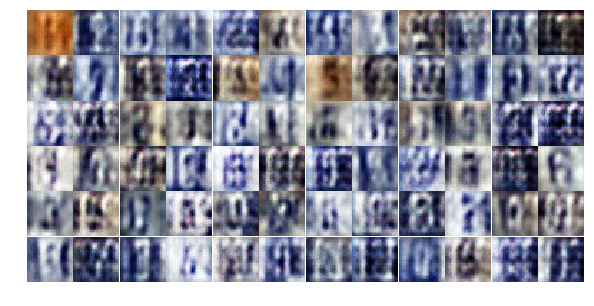

Epoch 2/25... Discriminator Loss: 1.4053... Generator Loss: 0.5643
Epoch 2/25... Discriminator Loss: 0.7484... Generator Loss: 1.6799
Epoch 2/25... Discriminator Loss: 0.7481... Generator Loss: 1.6967
Epoch 2/25... Discriminator Loss: 0.8784... Generator Loss: 1.1550
Epoch 2/25... Discriminator Loss: 0.9533... Generator Loss: 1.3933
Epoch 2/25... Discriminator Loss: 1.2398... Generator Loss: 0.8399
Epoch 2/25... Discriminator Loss: 1.2761... Generator Loss: 0.7693
Epoch 2/25... Discriminator Loss: 1.3582... Generator Loss: 0.8268
Epoch 2/25... Discriminator Loss: 1.1315... Generator Loss: 0.9179
Epoch 2/25... Discriminator Loss: 1.0142... Generator Loss: 0.7338


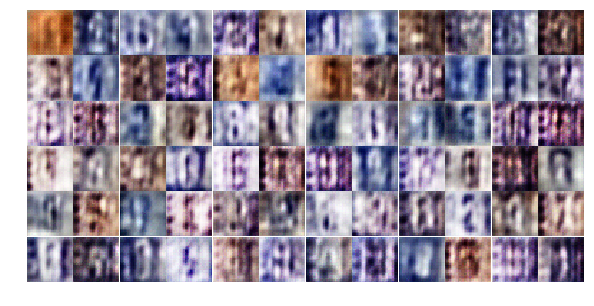

Epoch 2/25... Discriminator Loss: 1.0587... Generator Loss: 0.9296
Epoch 2/25... Discriminator Loss: 0.8188... Generator Loss: 1.2914
Epoch 2/25... Discriminator Loss: 0.9941... Generator Loss: 0.9781
Epoch 2/25... Discriminator Loss: 0.7383... Generator Loss: 1.0705
Epoch 2/25... Discriminator Loss: 0.8068... Generator Loss: 1.4927
Epoch 2/25... Discriminator Loss: 1.1025... Generator Loss: 0.7846
Epoch 2/25... Discriminator Loss: 0.9584... Generator Loss: 0.7528
Epoch 2/25... Discriminator Loss: 1.0483... Generator Loss: 0.8413
Epoch 2/25... Discriminator Loss: 1.3087... Generator Loss: 0.9262
Epoch 2/25... Discriminator Loss: 1.1662... Generator Loss: 1.0372


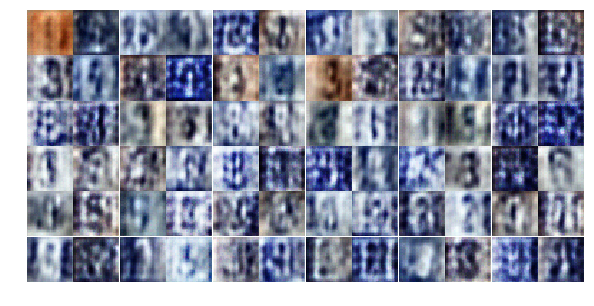

Epoch 2/25... Discriminator Loss: 1.0295... Generator Loss: 0.7794
Epoch 2/25... Discriminator Loss: 1.0553... Generator Loss: 1.1466
Epoch 2/25... Discriminator Loss: 1.1801... Generator Loss: 0.8770
Epoch 2/25... Discriminator Loss: 1.3072... Generator Loss: 0.6023
Epoch 2/25... Discriminator Loss: 0.7270... Generator Loss: 1.4779
Epoch 2/25... Discriminator Loss: 0.7614... Generator Loss: 1.1916
Epoch 2/25... Discriminator Loss: 1.1006... Generator Loss: 0.9386
Epoch 2/25... Discriminator Loss: 0.8278... Generator Loss: 1.1786
Epoch 2/25... Discriminator Loss: 1.0092... Generator Loss: 1.0999
Epoch 2/25... Discriminator Loss: 1.0356... Generator Loss: 1.0243


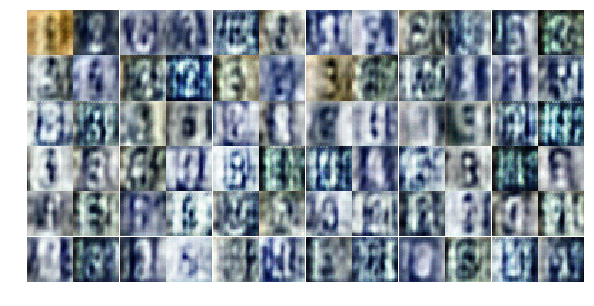

Epoch 2/25... Discriminator Loss: 0.8063... Generator Loss: 1.3265
Epoch 2/25... Discriminator Loss: 1.0988... Generator Loss: 0.7470
Epoch 2/25... Discriminator Loss: 0.9453... Generator Loss: 0.9037
Epoch 2/25... Discriminator Loss: 1.6816... Generator Loss: 0.3534
Epoch 2/25... Discriminator Loss: 1.0730... Generator Loss: 0.8669
Epoch 2/25... Discriminator Loss: 1.6287... Generator Loss: 0.3992
Epoch 2/25... Discriminator Loss: 0.8958... Generator Loss: 1.0273
Epoch 2/25... Discriminator Loss: 0.7914... Generator Loss: 1.1769
Epoch 2/25... Discriminator Loss: 0.7399... Generator Loss: 1.6360
Epoch 2/25... Discriminator Loss: 1.1754... Generator Loss: 0.7921


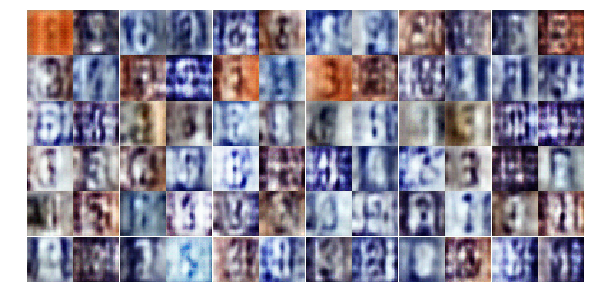

Epoch 2/25... Discriminator Loss: 0.9322... Generator Loss: 1.3526
Epoch 2/25... Discriminator Loss: 0.8333... Generator Loss: 1.1097
Epoch 2/25... Discriminator Loss: 0.7735... Generator Loss: 1.0015
Epoch 2/25... Discriminator Loss: 0.8777... Generator Loss: 1.0805
Epoch 3/25... Discriminator Loss: 0.9290... Generator Loss: 1.2764
Epoch 3/25... Discriminator Loss: 0.6476... Generator Loss: 1.3766
Epoch 3/25... Discriminator Loss: 0.8439... Generator Loss: 1.6800
Epoch 3/25... Discriminator Loss: 0.8611... Generator Loss: 0.9259
Epoch 3/25... Discriminator Loss: 0.8839... Generator Loss: 1.5298
Epoch 3/25... Discriminator Loss: 0.5680... Generator Loss: 1.7223


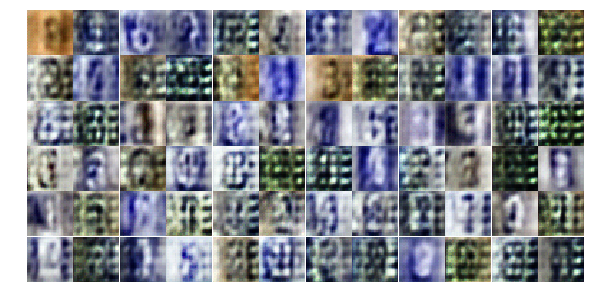

Epoch 3/25... Discriminator Loss: 0.9621... Generator Loss: 0.6985
Epoch 3/25... Discriminator Loss: 0.6292... Generator Loss: 1.5747
Epoch 3/25... Discriminator Loss: 0.8924... Generator Loss: 0.7869
Epoch 3/25... Discriminator Loss: 0.5482... Generator Loss: 1.4272
Epoch 3/25... Discriminator Loss: 1.2323... Generator Loss: 1.5636
Epoch 3/25... Discriminator Loss: 0.9327... Generator Loss: 0.8779
Epoch 3/25... Discriminator Loss: 0.7742... Generator Loss: 1.8084
Epoch 3/25... Discriminator Loss: 0.5018... Generator Loss: 1.6687
Epoch 3/25... Discriminator Loss: 0.9529... Generator Loss: 0.7549
Epoch 3/25... Discriminator Loss: 0.7024... Generator Loss: 1.4067


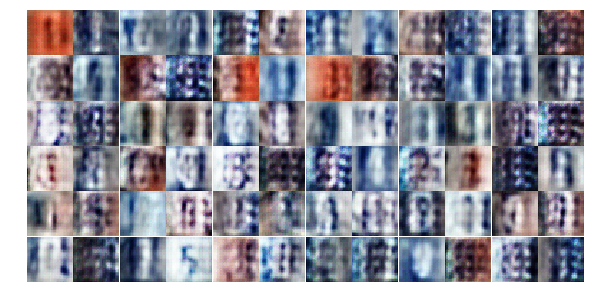

Epoch 3/25... Discriminator Loss: 0.9080... Generator Loss: 0.9995
Epoch 3/25... Discriminator Loss: 0.7483... Generator Loss: 1.6389
Epoch 3/25... Discriminator Loss: 0.8098... Generator Loss: 0.9524
Epoch 3/25... Discriminator Loss: 0.5031... Generator Loss: 2.0994
Epoch 3/25... Discriminator Loss: 1.0362... Generator Loss: 0.8088
Epoch 3/25... Discriminator Loss: 0.9173... Generator Loss: 1.0402
Epoch 3/25... Discriminator Loss: 0.5147... Generator Loss: 1.8717
Epoch 3/25... Discriminator Loss: 0.5908... Generator Loss: 1.2413
Epoch 3/25... Discriminator Loss: 0.5025... Generator Loss: 1.5390
Epoch 3/25... Discriminator Loss: 0.6335... Generator Loss: 1.2588


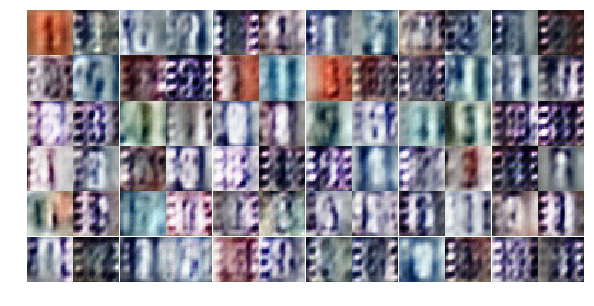

Epoch 3/25... Discriminator Loss: 0.7397... Generator Loss: 1.5995
Epoch 3/25... Discriminator Loss: 0.8019... Generator Loss: 1.3175
Epoch 3/25... Discriminator Loss: 0.8757... Generator Loss: 1.1626
Epoch 3/25... Discriminator Loss: 0.6876... Generator Loss: 1.2744
Epoch 3/25... Discriminator Loss: 0.5447... Generator Loss: 1.3636
Epoch 3/25... Discriminator Loss: 0.7223... Generator Loss: 1.4806
Epoch 3/25... Discriminator Loss: 1.4174... Generator Loss: 0.3698
Epoch 3/25... Discriminator Loss: 0.6998... Generator Loss: 1.3323
Epoch 3/25... Discriminator Loss: 0.3836... Generator Loss: 1.9986
Epoch 3/25... Discriminator Loss: 0.7062... Generator Loss: 2.5558


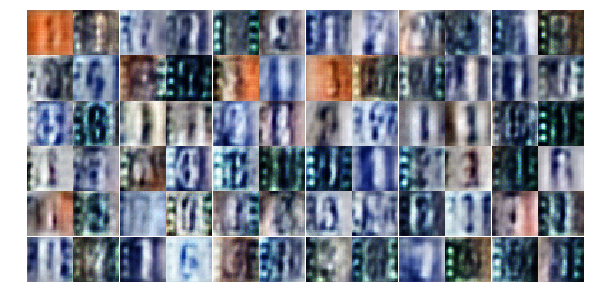

Epoch 3/25... Discriminator Loss: 0.4864... Generator Loss: 2.0657
Epoch 3/25... Discriminator Loss: 0.9869... Generator Loss: 2.9215
Epoch 3/25... Discriminator Loss: 0.5433... Generator Loss: 2.0571
Epoch 3/25... Discriminator Loss: 0.5929... Generator Loss: 1.1601
Epoch 3/25... Discriminator Loss: 0.5269... Generator Loss: 1.4679
Epoch 3/25... Discriminator Loss: 0.4138... Generator Loss: 2.0824
Epoch 3/25... Discriminator Loss: 0.6093... Generator Loss: 1.2890
Epoch 3/25... Discriminator Loss: 0.4585... Generator Loss: 1.4528
Epoch 3/25... Discriminator Loss: 1.2731... Generator Loss: 0.6162
Epoch 3/25... Discriminator Loss: 0.6440... Generator Loss: 1.8033


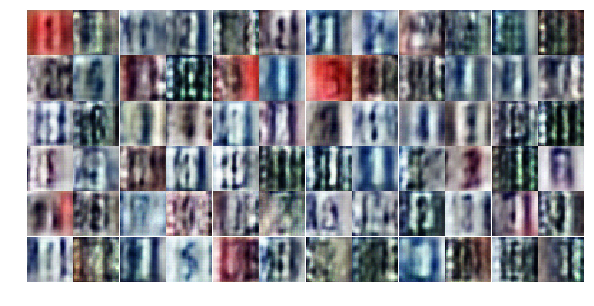

Epoch 3/25... Discriminator Loss: 0.4730... Generator Loss: 1.6556
Epoch 3/25... Discriminator Loss: 0.9868... Generator Loss: 2.6678
Epoch 3/25... Discriminator Loss: 0.7014... Generator Loss: 0.9966
Epoch 3/25... Discriminator Loss: 0.6733... Generator Loss: 1.4281
Epoch 3/25... Discriminator Loss: 0.9130... Generator Loss: 1.7891
Epoch 3/25... Discriminator Loss: 0.7061... Generator Loss: 1.5335
Epoch 3/25... Discriminator Loss: 0.7296... Generator Loss: 1.9475
Epoch 3/25... Discriminator Loss: 0.4842... Generator Loss: 1.7323
Epoch 3/25... Discriminator Loss: 0.7099... Generator Loss: 1.2485
Epoch 3/25... Discriminator Loss: 0.4222... Generator Loss: 1.8175


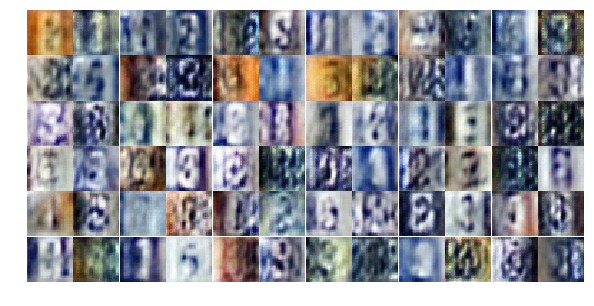

Epoch 3/25... Discriminator Loss: 0.9561... Generator Loss: 0.8105
Epoch 4/25... Discriminator Loss: 0.5871... Generator Loss: 1.2649
Epoch 4/25... Discriminator Loss: 0.6347... Generator Loss: 1.9192
Epoch 4/25... Discriminator Loss: 1.2776... Generator Loss: 0.4507
Epoch 4/25... Discriminator Loss: 0.5891... Generator Loss: 1.5452
Epoch 4/25... Discriminator Loss: 0.6296... Generator Loss: 1.6775
Epoch 4/25... Discriminator Loss: 0.7376... Generator Loss: 1.5268
Epoch 4/25... Discriminator Loss: 0.8802... Generator Loss: 0.9376
Epoch 4/25... Discriminator Loss: 0.4086... Generator Loss: 1.8986
Epoch 4/25... Discriminator Loss: 0.5319... Generator Loss: 1.4282


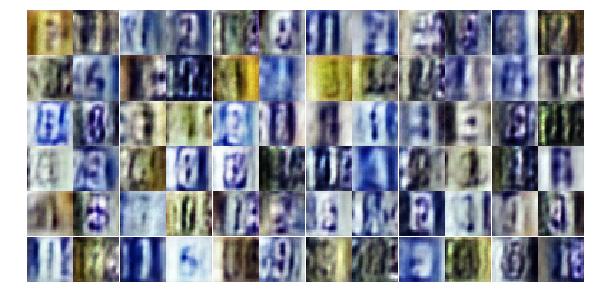

Epoch 4/25... Discriminator Loss: 0.5814... Generator Loss: 1.2637
Epoch 4/25... Discriminator Loss: 0.7078... Generator Loss: 1.2478
Epoch 4/25... Discriminator Loss: 1.0062... Generator Loss: 0.8701
Epoch 4/25... Discriminator Loss: 0.9936... Generator Loss: 0.8176
Epoch 4/25... Discriminator Loss: 0.9465... Generator Loss: 0.8850
Epoch 4/25... Discriminator Loss: 0.9176... Generator Loss: 0.9107
Epoch 4/25... Discriminator Loss: 0.5011... Generator Loss: 1.5139
Epoch 4/25... Discriminator Loss: 0.9187... Generator Loss: 0.6951
Epoch 4/25... Discriminator Loss: 0.6530... Generator Loss: 1.4271
Epoch 4/25... Discriminator Loss: 0.5829... Generator Loss: 1.5259


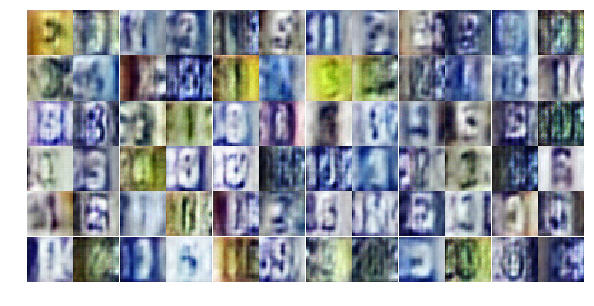

Epoch 4/25... Discriminator Loss: 0.7544... Generator Loss: 1.2840
Epoch 4/25... Discriminator Loss: 0.9979... Generator Loss: 2.1954
Epoch 4/25... Discriminator Loss: 0.8198... Generator Loss: 0.8460
Epoch 4/25... Discriminator Loss: 0.7037... Generator Loss: 1.0695
Epoch 4/25... Discriminator Loss: 0.5680... Generator Loss: 1.5065
Epoch 4/25... Discriminator Loss: 0.4557... Generator Loss: 2.7162
Epoch 4/25... Discriminator Loss: 1.1252... Generator Loss: 0.5553
Epoch 4/25... Discriminator Loss: 0.5504... Generator Loss: 1.5138
Epoch 4/25... Discriminator Loss: 0.4897... Generator Loss: 1.9352
Epoch 4/25... Discriminator Loss: 0.4643... Generator Loss: 2.6248


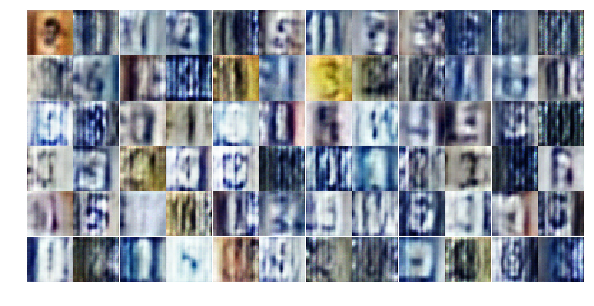

Epoch 4/25... Discriminator Loss: 0.4376... Generator Loss: 1.6400
Epoch 4/25... Discriminator Loss: 0.5055... Generator Loss: 1.9741
Epoch 4/25... Discriminator Loss: 0.5757... Generator Loss: 1.1406
Epoch 4/25... Discriminator Loss: 0.5239... Generator Loss: 1.4476
Epoch 4/25... Discriminator Loss: 0.4511... Generator Loss: 2.7648
Epoch 4/25... Discriminator Loss: 0.6025... Generator Loss: 1.1698
Epoch 4/25... Discriminator Loss: 0.4388... Generator Loss: 3.1557
Epoch 4/25... Discriminator Loss: 0.6916... Generator Loss: 0.9999
Epoch 4/25... Discriminator Loss: 0.5987... Generator Loss: 1.1738
Epoch 4/25... Discriminator Loss: 0.5406... Generator Loss: 1.7480


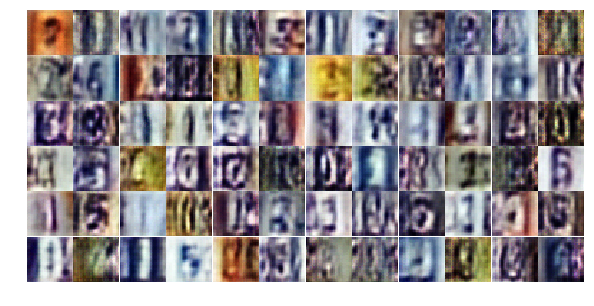

Epoch 4/25... Discriminator Loss: 0.6594... Generator Loss: 1.1066
Epoch 4/25... Discriminator Loss: 0.3000... Generator Loss: 1.8251
Epoch 4/25... Discriminator Loss: 1.6025... Generator Loss: 0.3220
Epoch 4/25... Discriminator Loss: 0.8611... Generator Loss: 2.4772
Epoch 4/25... Discriminator Loss: 0.7929... Generator Loss: 1.0975
Epoch 4/25... Discriminator Loss: 0.7087... Generator Loss: 1.0238
Epoch 4/25... Discriminator Loss: 0.5473... Generator Loss: 1.2523
Epoch 4/25... Discriminator Loss: 0.4983... Generator Loss: 1.5620
Epoch 4/25... Discriminator Loss: 0.4085... Generator Loss: 1.7937
Epoch 4/25... Discriminator Loss: 0.5045... Generator Loss: 2.2573


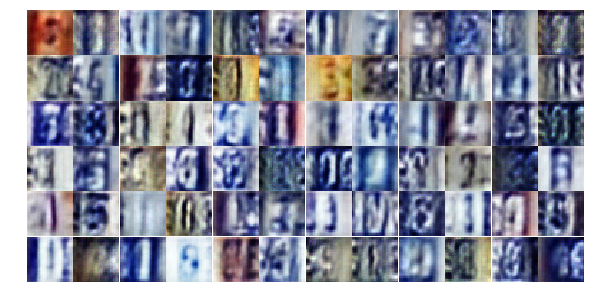

Epoch 4/25... Discriminator Loss: 0.4110... Generator Loss: 1.8026
Epoch 4/25... Discriminator Loss: 0.3694... Generator Loss: 1.6799
Epoch 4/25... Discriminator Loss: 0.4988... Generator Loss: 3.3165
Epoch 4/25... Discriminator Loss: 0.9671... Generator Loss: 2.8705
Epoch 4/25... Discriminator Loss: 0.5325... Generator Loss: 1.4354
Epoch 4/25... Discriminator Loss: 0.5481... Generator Loss: 1.3250
Epoch 4/25... Discriminator Loss: 0.4126... Generator Loss: 1.5638
Epoch 4/25... Discriminator Loss: 0.8471... Generator Loss: 0.8669
Epoch 4/25... Discriminator Loss: 0.7241... Generator Loss: 2.3430
Epoch 5/25... Discriminator Loss: 0.6893... Generator Loss: 2.9267


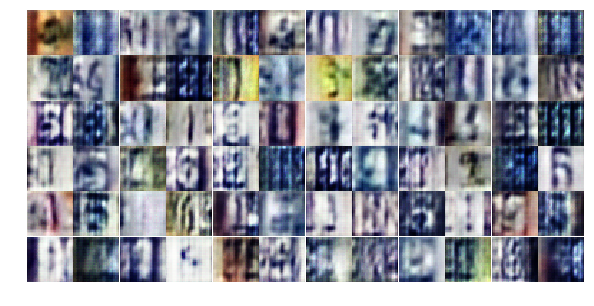

Epoch 5/25... Discriminator Loss: 0.4587... Generator Loss: 1.8496
Epoch 5/25... Discriminator Loss: 0.5928... Generator Loss: 1.1179
Epoch 5/25... Discriminator Loss: 0.6570... Generator Loss: 1.3476
Epoch 5/25... Discriminator Loss: 0.7599... Generator Loss: 0.9543
Epoch 5/25... Discriminator Loss: 0.2808... Generator Loss: 2.2486
Epoch 5/25... Discriminator Loss: 0.8961... Generator Loss: 0.7791
Epoch 5/25... Discriminator Loss: 0.6177... Generator Loss: 1.0786
Epoch 5/25... Discriminator Loss: 0.4174... Generator Loss: 1.6198
Epoch 5/25... Discriminator Loss: 0.5162... Generator Loss: 1.3137
Epoch 5/25... Discriminator Loss: 1.1228... Generator Loss: 0.5350


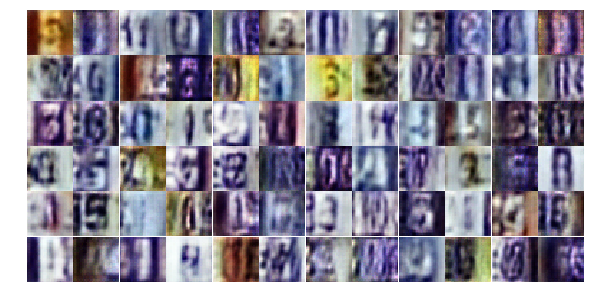

Epoch 5/25... Discriminator Loss: 1.3546... Generator Loss: 3.4275
Epoch 5/25... Discriminator Loss: 0.4300... Generator Loss: 1.8281
Epoch 5/25... Discriminator Loss: 0.3928... Generator Loss: 1.8025
Epoch 5/25... Discriminator Loss: 1.2376... Generator Loss: 0.5061
Epoch 5/25... Discriminator Loss: 1.0408... Generator Loss: 3.4204
Epoch 5/25... Discriminator Loss: 0.7718... Generator Loss: 1.0115
Epoch 5/25... Discriminator Loss: 0.5439... Generator Loss: 1.4710
Epoch 5/25... Discriminator Loss: 0.4391... Generator Loss: 1.6107
Epoch 5/25... Discriminator Loss: 0.4035... Generator Loss: 1.8172
Epoch 5/25... Discriminator Loss: 0.4673... Generator Loss: 1.9516


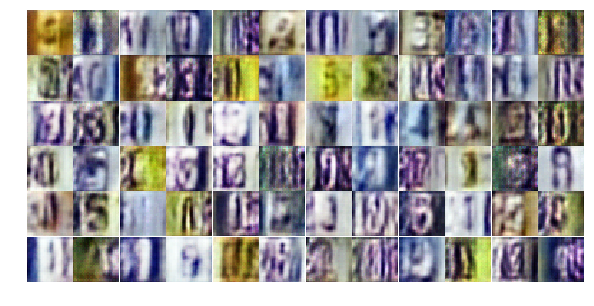

Epoch 5/25... Discriminator Loss: 0.5110... Generator Loss: 1.3314
Epoch 5/25... Discriminator Loss: 1.0908... Generator Loss: 0.5687
Epoch 5/25... Discriminator Loss: 1.0392... Generator Loss: 2.8206
Epoch 5/25... Discriminator Loss: 0.6158... Generator Loss: 1.1792
Epoch 5/25... Discriminator Loss: 1.2976... Generator Loss: 0.4179
Epoch 5/25... Discriminator Loss: 0.6433... Generator Loss: 1.2223
Epoch 5/25... Discriminator Loss: 1.0074... Generator Loss: 0.6020
Epoch 5/25... Discriminator Loss: 0.6795... Generator Loss: 1.0550
Epoch 5/25... Discriminator Loss: 0.7180... Generator Loss: 1.6507
Epoch 5/25... Discriminator Loss: 0.3144... Generator Loss: 1.8880


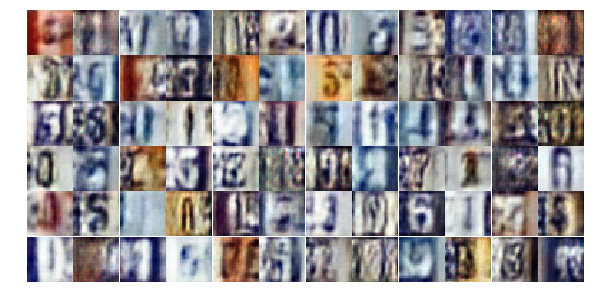

Epoch 5/25... Discriminator Loss: 0.5378... Generator Loss: 1.4928
Epoch 5/25... Discriminator Loss: 0.3606... Generator Loss: 1.8314
Epoch 5/25... Discriminator Loss: 0.4607... Generator Loss: 1.4459
Epoch 5/25... Discriminator Loss: 0.5233... Generator Loss: 1.1514
Epoch 5/25... Discriminator Loss: 2.3076... Generator Loss: 0.1909
Epoch 5/25... Discriminator Loss: 0.5453... Generator Loss: 2.1028
Epoch 5/25... Discriminator Loss: 1.4467... Generator Loss: 0.4891
Epoch 5/25... Discriminator Loss: 0.6542... Generator Loss: 1.0668
Epoch 5/25... Discriminator Loss: 1.0710... Generator Loss: 0.5601
Epoch 5/25... Discriminator Loss: 1.1800... Generator Loss: 0.5542


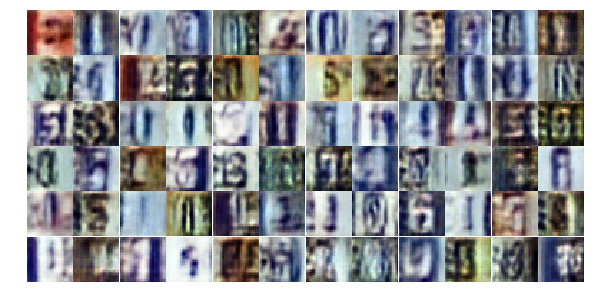

Epoch 5/25... Discriminator Loss: 0.4664... Generator Loss: 1.5972
Epoch 5/25... Discriminator Loss: 0.8337... Generator Loss: 0.7460
Epoch 5/25... Discriminator Loss: 0.7714... Generator Loss: 1.1143
Epoch 5/25... Discriminator Loss: 0.6789... Generator Loss: 1.0094
Epoch 5/25... Discriminator Loss: 0.8117... Generator Loss: 1.1768
Epoch 5/25... Discriminator Loss: 0.7118... Generator Loss: 1.0079
Epoch 5/25... Discriminator Loss: 3.1410... Generator Loss: 5.7320
Epoch 5/25... Discriminator Loss: 0.6145... Generator Loss: 1.4978
Epoch 5/25... Discriminator Loss: 1.2657... Generator Loss: 0.4747
Epoch 5/25... Discriminator Loss: 0.5688... Generator Loss: 1.3047


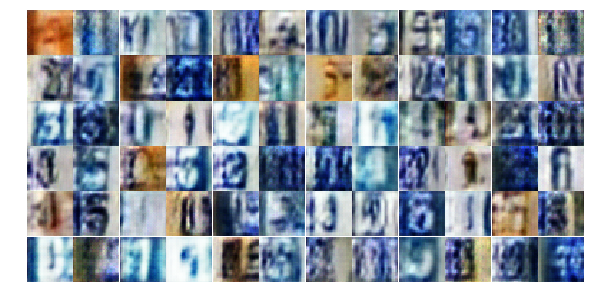

Epoch 5/25... Discriminator Loss: 0.6419... Generator Loss: 1.2129
Epoch 5/25... Discriminator Loss: 0.6004... Generator Loss: 1.1678
Epoch 5/25... Discriminator Loss: 0.8669... Generator Loss: 0.7401
Epoch 5/25... Discriminator Loss: 0.6037... Generator Loss: 1.2108
Epoch 5/25... Discriminator Loss: 1.0406... Generator Loss: 0.6000
Epoch 5/25... Discriminator Loss: 0.7223... Generator Loss: 1.2136
Epoch 6/25... Discriminator Loss: 1.0087... Generator Loss: 0.6113
Epoch 6/25... Discriminator Loss: 0.5595... Generator Loss: 1.2950
Epoch 6/25... Discriminator Loss: 0.7917... Generator Loss: 0.8160
Epoch 6/25... Discriminator Loss: 0.7200... Generator Loss: 0.8927


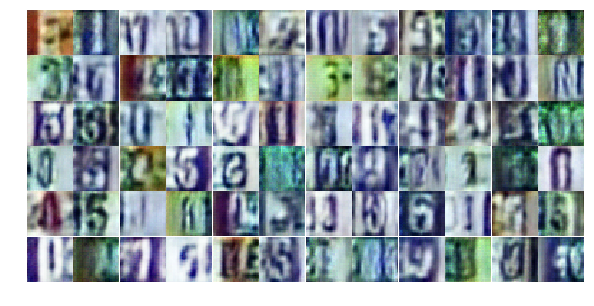

Epoch 6/25... Discriminator Loss: 1.7238... Generator Loss: 0.2855
Epoch 6/25... Discriminator Loss: 0.8810... Generator Loss: 0.9016
Epoch 6/25... Discriminator Loss: 0.6902... Generator Loss: 3.4356
Epoch 6/25... Discriminator Loss: 0.8211... Generator Loss: 1.1876
Epoch 6/25... Discriminator Loss: 1.0877... Generator Loss: 0.5564
Epoch 6/25... Discriminator Loss: 0.4379... Generator Loss: 1.4697
Epoch 6/25... Discriminator Loss: 0.4779... Generator Loss: 1.7970
Epoch 6/25... Discriminator Loss: 1.1220... Generator Loss: 0.5232
Epoch 6/25... Discriminator Loss: 0.7613... Generator Loss: 0.8005
Epoch 6/25... Discriminator Loss: 0.6800... Generator Loss: 1.4606


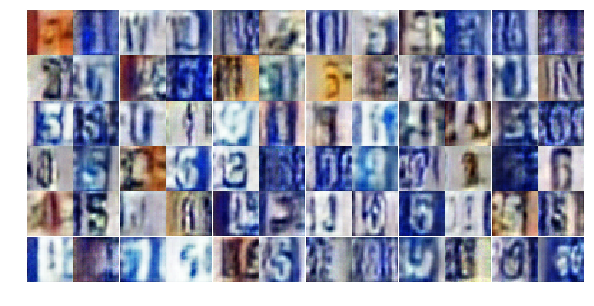

Epoch 6/25... Discriminator Loss: 0.5349... Generator Loss: 1.7589
Epoch 6/25... Discriminator Loss: 0.8028... Generator Loss: 1.3566
Epoch 6/25... Discriminator Loss: 1.0762... Generator Loss: 0.5498
Epoch 6/25... Discriminator Loss: 0.6007... Generator Loss: 1.0819
Epoch 6/25... Discriminator Loss: 0.4579... Generator Loss: 1.6553
Epoch 6/25... Discriminator Loss: 0.5083... Generator Loss: 1.3309
Epoch 6/25... Discriminator Loss: 0.6280... Generator Loss: 1.0948
Epoch 6/25... Discriminator Loss: 0.4805... Generator Loss: 1.4287
Epoch 6/25... Discriminator Loss: 0.4959... Generator Loss: 2.3692
Epoch 6/25... Discriminator Loss: 0.6475... Generator Loss: 1.9529


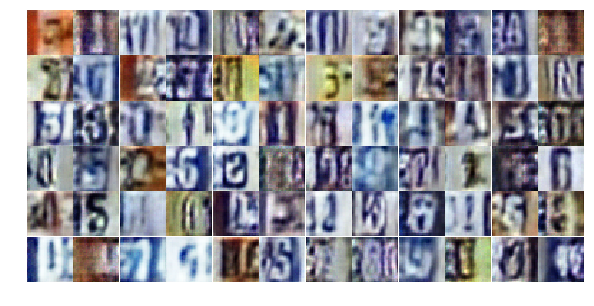

Epoch 6/25... Discriminator Loss: 1.6352... Generator Loss: 3.7429
Epoch 6/25... Discriminator Loss: 0.7609... Generator Loss: 1.2188
Epoch 6/25... Discriminator Loss: 0.7084... Generator Loss: 1.0945
Epoch 6/25... Discriminator Loss: 1.0368... Generator Loss: 0.5863
Epoch 6/25... Discriminator Loss: 0.7727... Generator Loss: 2.6410
Epoch 6/25... Discriminator Loss: 1.0160... Generator Loss: 0.6549
Epoch 6/25... Discriminator Loss: 0.6375... Generator Loss: 1.1741
Epoch 6/25... Discriminator Loss: 0.4562... Generator Loss: 1.4395
Epoch 6/25... Discriminator Loss: 0.4406... Generator Loss: 1.7691
Epoch 6/25... Discriminator Loss: 0.6018... Generator Loss: 2.1539


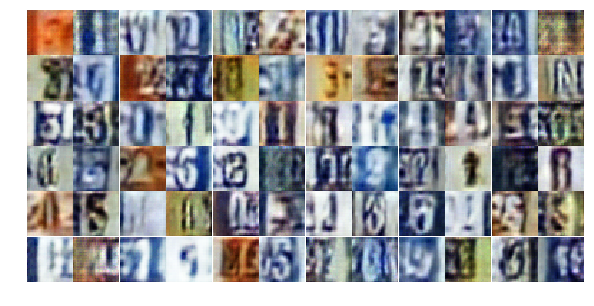

Epoch 6/25... Discriminator Loss: 0.8106... Generator Loss: 0.8398
Epoch 6/25... Discriminator Loss: 0.5255... Generator Loss: 1.3660
Epoch 6/25... Discriminator Loss: 1.1293... Generator Loss: 0.5880
Epoch 6/25... Discriminator Loss: 0.6577... Generator Loss: 1.0787
Epoch 6/25... Discriminator Loss: 0.4974... Generator Loss: 1.7035
Epoch 6/25... Discriminator Loss: 0.7649... Generator Loss: 0.9312
Epoch 6/25... Discriminator Loss: 0.5370... Generator Loss: 1.3643
Epoch 6/25... Discriminator Loss: 0.4787... Generator Loss: 1.7409
Epoch 6/25... Discriminator Loss: 0.9372... Generator Loss: 0.7156
Epoch 6/25... Discriminator Loss: 0.5647... Generator Loss: 1.1912


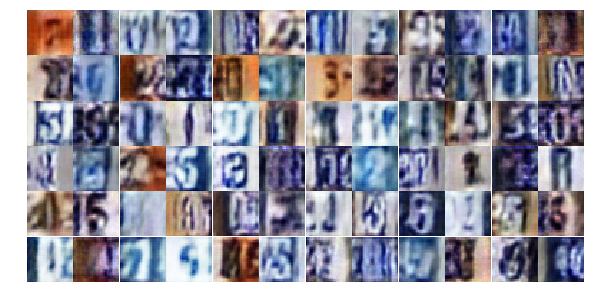

Epoch 6/25... Discriminator Loss: 0.4908... Generator Loss: 1.9238
Epoch 6/25... Discriminator Loss: 0.7473... Generator Loss: 1.2555
Epoch 6/25... Discriminator Loss: 1.7296... Generator Loss: 0.3181
Epoch 6/25... Discriminator Loss: 0.5244... Generator Loss: 1.5469
Epoch 6/25... Discriminator Loss: 0.5780... Generator Loss: 1.9629
Epoch 6/25... Discriminator Loss: 0.5590... Generator Loss: 1.2291
Epoch 6/25... Discriminator Loss: 0.6195... Generator Loss: 1.1268
Epoch 6/25... Discriminator Loss: 0.6334... Generator Loss: 1.0619
Epoch 6/25... Discriminator Loss: 1.0295... Generator Loss: 0.6309
Epoch 6/25... Discriminator Loss: 1.0099... Generator Loss: 1.1398


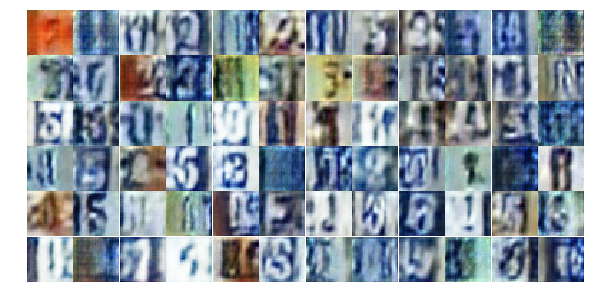

Epoch 6/25... Discriminator Loss: 0.7676... Generator Loss: 1.8027
Epoch 6/25... Discriminator Loss: 0.4305... Generator Loss: 1.5255
Epoch 6/25... Discriminator Loss: 0.5279... Generator Loss: 1.3916
Epoch 7/25... Discriminator Loss: 0.5261... Generator Loss: 1.8750
Epoch 7/25... Discriminator Loss: 0.5631... Generator Loss: 1.3109
Epoch 7/25... Discriminator Loss: 0.5457... Generator Loss: 1.5311
Epoch 7/25... Discriminator Loss: 0.5215... Generator Loss: 1.2957
Epoch 7/25... Discriminator Loss: 0.6845... Generator Loss: 0.9469
Epoch 7/25... Discriminator Loss: 0.3978... Generator Loss: 1.8806
Epoch 7/25... Discriminator Loss: 0.8481... Generator Loss: 0.7645


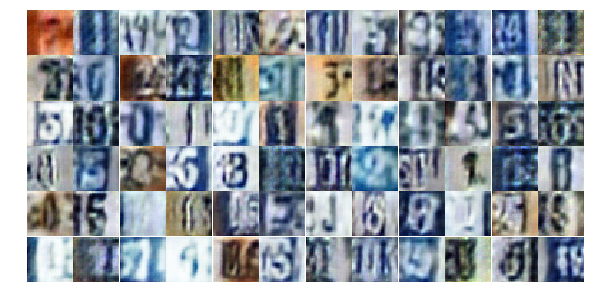

Epoch 7/25... Discriminator Loss: 0.5056... Generator Loss: 1.8510
Epoch 7/25... Discriminator Loss: 0.7044... Generator Loss: 0.8638
Epoch 7/25... Discriminator Loss: 0.5688... Generator Loss: 1.4230
Epoch 7/25... Discriminator Loss: 0.8268... Generator Loss: 2.4400
Epoch 7/25... Discriminator Loss: 0.4628... Generator Loss: 1.7360
Epoch 7/25... Discriminator Loss: 0.5199... Generator Loss: 1.2698
Epoch 7/25... Discriminator Loss: 2.0573... Generator Loss: 0.2737
Epoch 7/25... Discriminator Loss: 0.7418... Generator Loss: 1.6359
Epoch 7/25... Discriminator Loss: 0.6035... Generator Loss: 1.3124
Epoch 7/25... Discriminator Loss: 0.6369... Generator Loss: 1.2928


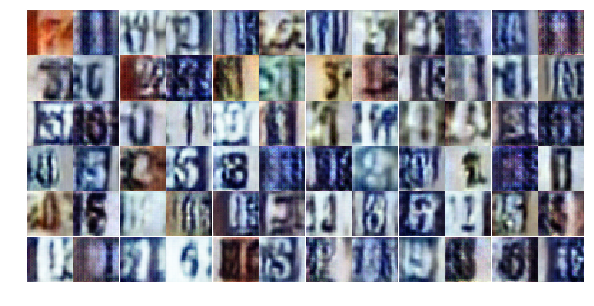

Epoch 7/25... Discriminator Loss: 0.6499... Generator Loss: 1.4542
Epoch 7/25... Discriminator Loss: 0.4176... Generator Loss: 1.7306
Epoch 7/25... Discriminator Loss: 0.9051... Generator Loss: 0.7567
Epoch 7/25... Discriminator Loss: 0.6861... Generator Loss: 1.2269
Epoch 7/25... Discriminator Loss: 0.5355... Generator Loss: 1.3264
Epoch 7/25... Discriminator Loss: 0.5320... Generator Loss: 1.4993
Epoch 7/25... Discriminator Loss: 0.7371... Generator Loss: 0.9060
Epoch 7/25... Discriminator Loss: 1.2244... Generator Loss: 0.4789
Epoch 7/25... Discriminator Loss: 0.3483... Generator Loss: 2.0510
Epoch 7/25... Discriminator Loss: 0.4774... Generator Loss: 1.5442


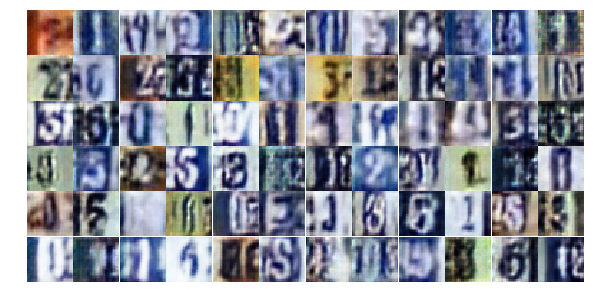

Epoch 7/25... Discriminator Loss: 0.5256... Generator Loss: 1.3452
Epoch 7/25... Discriminator Loss: 0.8017... Generator Loss: 0.8571
Epoch 7/25... Discriminator Loss: 0.3886... Generator Loss: 1.5460
Epoch 7/25... Discriminator Loss: 1.1013... Generator Loss: 0.5801
Epoch 7/25... Discriminator Loss: 0.7770... Generator Loss: 1.0697
Epoch 7/25... Discriminator Loss: 0.6302... Generator Loss: 1.2783
Epoch 7/25... Discriminator Loss: 0.4294... Generator Loss: 1.5734
Epoch 7/25... Discriminator Loss: 0.6083... Generator Loss: 1.1476
Epoch 7/25... Discriminator Loss: 1.2097... Generator Loss: 0.4807
Epoch 7/25... Discriminator Loss: 0.5854... Generator Loss: 2.4356


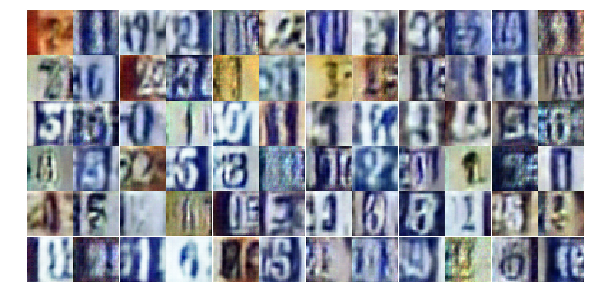

Epoch 7/25... Discriminator Loss: 1.1059... Generator Loss: 0.6170
Epoch 7/25... Discriminator Loss: 0.7125... Generator Loss: 1.1558
Epoch 7/25... Discriminator Loss: 0.5311... Generator Loss: 2.4438
Epoch 7/25... Discriminator Loss: 0.5859... Generator Loss: 1.6568
Epoch 7/25... Discriminator Loss: 0.6745... Generator Loss: 0.9650
Epoch 7/25... Discriminator Loss: 0.4215... Generator Loss: 2.2280
Epoch 7/25... Discriminator Loss: 0.4184... Generator Loss: 2.0523
Epoch 7/25... Discriminator Loss: 2.9865... Generator Loss: 0.3922
Epoch 7/25... Discriminator Loss: 1.0112... Generator Loss: 2.2451
Epoch 7/25... Discriminator Loss: 0.9463... Generator Loss: 0.9880


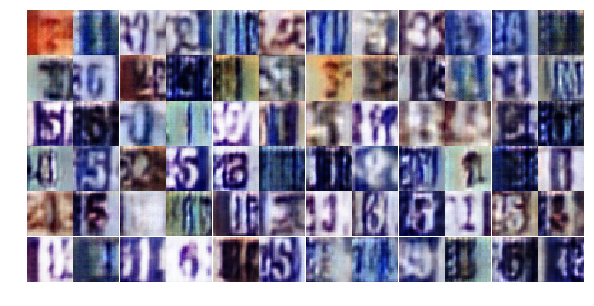

Epoch 7/25... Discriminator Loss: 0.5411... Generator Loss: 1.3385
Epoch 7/25... Discriminator Loss: 0.8088... Generator Loss: 0.8601
Epoch 7/25... Discriminator Loss: 0.7369... Generator Loss: 0.9671
Epoch 7/25... Discriminator Loss: 0.6568... Generator Loss: 1.0199
Epoch 7/25... Discriminator Loss: 0.6150... Generator Loss: 1.1055
Epoch 7/25... Discriminator Loss: 0.6949... Generator Loss: 1.0126
Epoch 7/25... Discriminator Loss: 1.3305... Generator Loss: 0.3954
Epoch 7/25... Discriminator Loss: 0.7449... Generator Loss: 1.0992
Epoch 7/25... Discriminator Loss: 0.7540... Generator Loss: 0.9787
Epoch 7/25... Discriminator Loss: 0.5509... Generator Loss: 1.2059


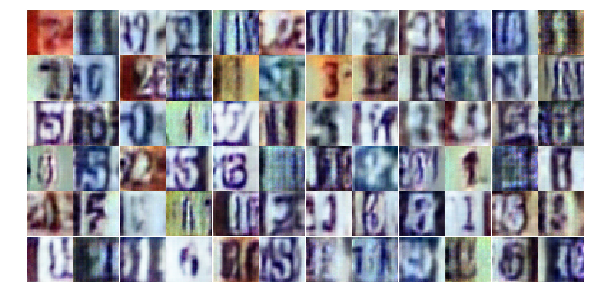

Epoch 7/25... Discriminator Loss: 0.4816... Generator Loss: 2.1004
Epoch 8/25... Discriminator Loss: 0.3956... Generator Loss: 1.6523
Epoch 8/25... Discriminator Loss: 0.9377... Generator Loss: 0.6288
Epoch 8/25... Discriminator Loss: 0.8021... Generator Loss: 0.8241
Epoch 8/25... Discriminator Loss: 0.4990... Generator Loss: 1.5217
Epoch 8/25... Discriminator Loss: 0.6645... Generator Loss: 1.7873
Epoch 8/25... Discriminator Loss: 1.2737... Generator Loss: 0.4524
Epoch 8/25... Discriminator Loss: 0.4983... Generator Loss: 2.2709
Epoch 8/25... Discriminator Loss: 0.6828... Generator Loss: 1.1238
Epoch 8/25... Discriminator Loss: 0.6391... Generator Loss: 1.1221


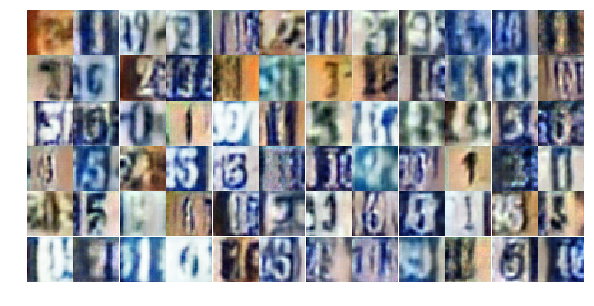

Epoch 8/25... Discriminator Loss: 0.4665... Generator Loss: 1.5869
Epoch 8/25... Discriminator Loss: 0.5358... Generator Loss: 1.8811
Epoch 8/25... Discriminator Loss: 0.7184... Generator Loss: 1.0146
Epoch 8/25... Discriminator Loss: 0.5185... Generator Loss: 2.0385
Epoch 8/25... Discriminator Loss: 0.8991... Generator Loss: 0.7577
Epoch 8/25... Discriminator Loss: 0.5216... Generator Loss: 1.8058
Epoch 8/25... Discriminator Loss: 0.6819... Generator Loss: 0.9938
Epoch 8/25... Discriminator Loss: 0.5499... Generator Loss: 1.2680
Epoch 8/25... Discriminator Loss: 0.6538... Generator Loss: 1.0257
Epoch 8/25... Discriminator Loss: 1.2455... Generator Loss: 1.4424


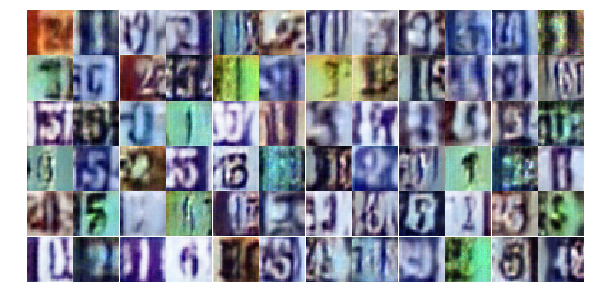

Epoch 8/25... Discriminator Loss: 0.4318... Generator Loss: 1.7726
Epoch 8/25... Discriminator Loss: 0.4330... Generator Loss: 2.1824
Epoch 8/25... Discriminator Loss: 0.6699... Generator Loss: 1.8718
Epoch 8/25... Discriminator Loss: 0.7438... Generator Loss: 2.7674
Epoch 8/25... Discriminator Loss: 0.9424... Generator Loss: 4.1355
Epoch 8/25... Discriminator Loss: 0.6239... Generator Loss: 1.1302
Epoch 8/25... Discriminator Loss: 0.6488... Generator Loss: 1.3630
Epoch 8/25... Discriminator Loss: 0.4151... Generator Loss: 1.6562
Epoch 8/25... Discriminator Loss: 0.7678... Generator Loss: 3.4043
Epoch 8/25... Discriminator Loss: 0.7647... Generator Loss: 0.9529


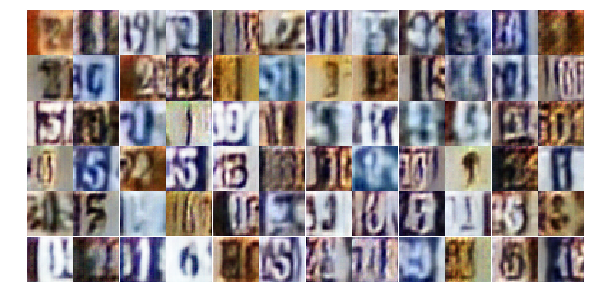

Epoch 8/25... Discriminator Loss: 0.8330... Generator Loss: 0.7640
Epoch 8/25... Discriminator Loss: 0.9947... Generator Loss: 0.6322
Epoch 8/25... Discriminator Loss: 0.6547... Generator Loss: 1.1093
Epoch 8/25... Discriminator Loss: 0.8187... Generator Loss: 1.0865
Epoch 8/25... Discriminator Loss: 0.7440... Generator Loss: 0.8536
Epoch 8/25... Discriminator Loss: 0.6309... Generator Loss: 1.1744
Epoch 8/25... Discriminator Loss: 0.5142... Generator Loss: 1.4571
Epoch 8/25... Discriminator Loss: 0.4544... Generator Loss: 1.6051
Epoch 8/25... Discriminator Loss: 0.5569... Generator Loss: 1.3274
Epoch 8/25... Discriminator Loss: 0.6635... Generator Loss: 1.0139


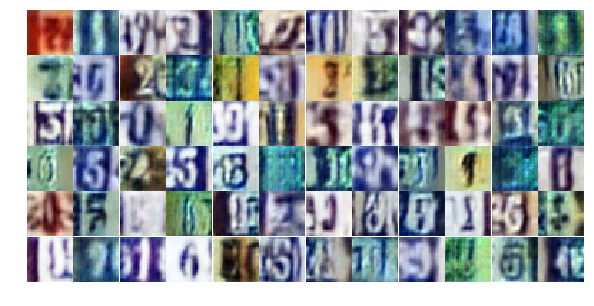

Epoch 8/25... Discriminator Loss: 0.4902... Generator Loss: 2.2060
Epoch 8/25... Discriminator Loss: 1.0511... Generator Loss: 0.6521
Epoch 8/25... Discriminator Loss: 0.4257... Generator Loss: 1.4917
Epoch 8/25... Discriminator Loss: 0.5437... Generator Loss: 1.2912
Epoch 8/25... Discriminator Loss: 0.9136... Generator Loss: 3.0156
Epoch 8/25... Discriminator Loss: 1.0781... Generator Loss: 0.5716
Epoch 8/25... Discriminator Loss: 0.4455... Generator Loss: 1.5068
Epoch 8/25... Discriminator Loss: 0.6540... Generator Loss: 1.0023
Epoch 8/25... Discriminator Loss: 0.7277... Generator Loss: 3.0494
Epoch 8/25... Discriminator Loss: 0.5430... Generator Loss: 1.3820


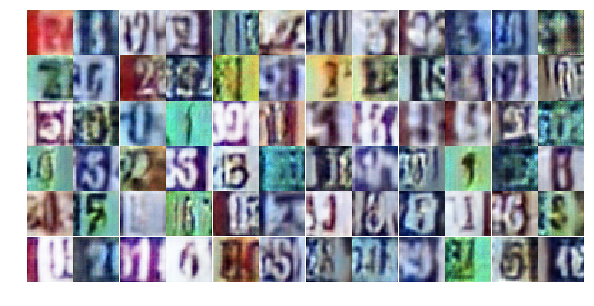

Epoch 8/25... Discriminator Loss: 0.4445... Generator Loss: 1.5260
Epoch 8/25... Discriminator Loss: 0.5375... Generator Loss: 1.4973
Epoch 8/25... Discriminator Loss: 0.3337... Generator Loss: 1.9770
Epoch 8/25... Discriminator Loss: 0.9513... Generator Loss: 2.4547
Epoch 8/25... Discriminator Loss: 0.4595... Generator Loss: 1.6461
Epoch 8/25... Discriminator Loss: 0.7491... Generator Loss: 0.9615
Epoch 8/25... Discriminator Loss: 0.5600... Generator Loss: 1.2820
Epoch 8/25... Discriminator Loss: 0.7278... Generator Loss: 1.2622
Epoch 9/25... Discriminator Loss: 0.7317... Generator Loss: 1.1189
Epoch 9/25... Discriminator Loss: 1.0311... Generator Loss: 0.5782


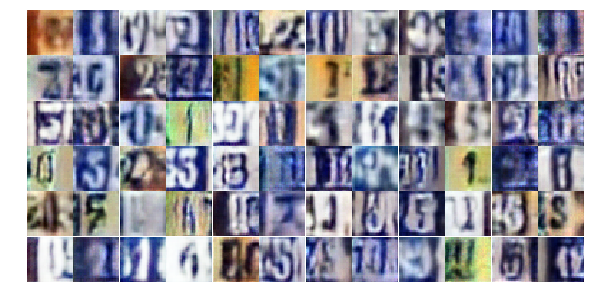

Epoch 9/25... Discriminator Loss: 0.6187... Generator Loss: 1.0340
Epoch 9/25... Discriminator Loss: 0.6129... Generator Loss: 1.1257
Epoch 9/25... Discriminator Loss: 1.1017... Generator Loss: 0.5552
Epoch 9/25... Discriminator Loss: 0.5101... Generator Loss: 1.4428
Epoch 9/25... Discriminator Loss: 1.1297... Generator Loss: 0.5346
Epoch 9/25... Discriminator Loss: 0.4092... Generator Loss: 1.9188
Epoch 9/25... Discriminator Loss: 0.7489... Generator Loss: 0.8943
Epoch 9/25... Discriminator Loss: 0.4475... Generator Loss: 1.3714
Epoch 9/25... Discriminator Loss: 0.7415... Generator Loss: 0.9061
Epoch 9/25... Discriminator Loss: 0.4835... Generator Loss: 2.2413


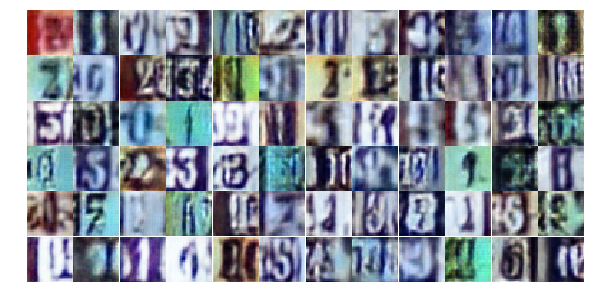

Epoch 9/25... Discriminator Loss: 0.6337... Generator Loss: 1.1408
Epoch 9/25... Discriminator Loss: 1.1463... Generator Loss: 0.5559
Epoch 9/25... Discriminator Loss: 0.7323... Generator Loss: 1.3771
Epoch 9/25... Discriminator Loss: 0.8733... Generator Loss: 0.7044
Epoch 9/25... Discriminator Loss: 0.3739... Generator Loss: 2.2978
Epoch 9/25... Discriminator Loss: 0.7617... Generator Loss: 1.0036
Epoch 9/25... Discriminator Loss: 1.0525... Generator Loss: 0.6084
Epoch 9/25... Discriminator Loss: 0.7501... Generator Loss: 0.8584
Epoch 9/25... Discriminator Loss: 1.1284... Generator Loss: 0.5293
Epoch 9/25... Discriminator Loss: 0.6030... Generator Loss: 1.1235


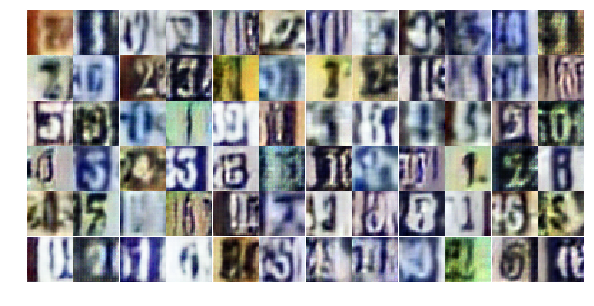

Epoch 9/25... Discriminator Loss: 0.8212... Generator Loss: 1.0077
Epoch 9/25... Discriminator Loss: 0.4577... Generator Loss: 1.4508
Epoch 9/25... Discriminator Loss: 0.4473... Generator Loss: 1.9190
Epoch 9/25... Discriminator Loss: 0.7876... Generator Loss: 0.8698
Epoch 9/25... Discriminator Loss: 0.7384... Generator Loss: 1.7682
Epoch 9/25... Discriminator Loss: 0.5601... Generator Loss: 1.3339
Epoch 9/25... Discriminator Loss: 0.4894... Generator Loss: 1.4410
Epoch 9/25... Discriminator Loss: 0.4979... Generator Loss: 1.4287
Epoch 9/25... Discriminator Loss: 0.5004... Generator Loss: 1.2721
Epoch 9/25... Discriminator Loss: 0.6169... Generator Loss: 1.0997


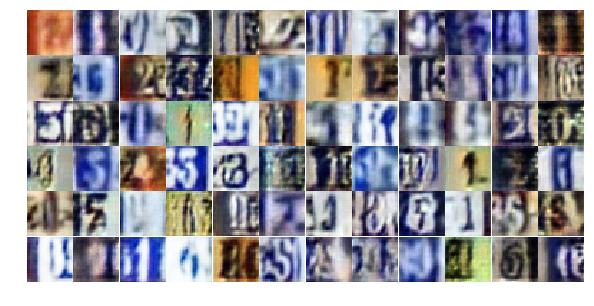

Epoch 9/25... Discriminator Loss: 0.4919... Generator Loss: 1.3389
Epoch 9/25... Discriminator Loss: 0.6262... Generator Loss: 1.1704
Epoch 9/25... Discriminator Loss: 0.6827... Generator Loss: 1.0212
Epoch 9/25... Discriminator Loss: 1.0877... Generator Loss: 0.5631
Epoch 9/25... Discriminator Loss: 0.4654... Generator Loss: 1.8787
Epoch 9/25... Discriminator Loss: 1.0362... Generator Loss: 2.0953
Epoch 9/25... Discriminator Loss: 0.6319... Generator Loss: 1.2803
Epoch 9/25... Discriminator Loss: 0.3250... Generator Loss: 1.9630
Epoch 9/25... Discriminator Loss: 1.3606... Generator Loss: 0.4321
Epoch 9/25... Discriminator Loss: 0.7657... Generator Loss: 0.8509


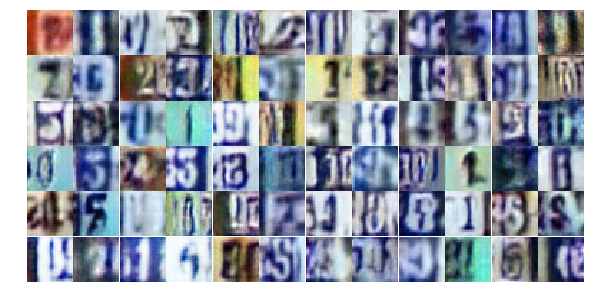

Epoch 9/25... Discriminator Loss: 0.5638... Generator Loss: 1.2008
Epoch 9/25... Discriminator Loss: 0.4041... Generator Loss: 2.0566
Epoch 9/25... Discriminator Loss: 0.8239... Generator Loss: 2.2716
Epoch 9/25... Discriminator Loss: 0.6447... Generator Loss: 1.5786
Epoch 9/25... Discriminator Loss: 0.4353... Generator Loss: 2.8873
Epoch 9/25... Discriminator Loss: 0.7821... Generator Loss: 0.8327
Epoch 9/25... Discriminator Loss: 0.6774... Generator Loss: 1.1608
Epoch 9/25... Discriminator Loss: 0.7700... Generator Loss: 0.9488
Epoch 9/25... Discriminator Loss: 0.5381... Generator Loss: 1.4315
Epoch 9/25... Discriminator Loss: 0.4934... Generator Loss: 2.1333


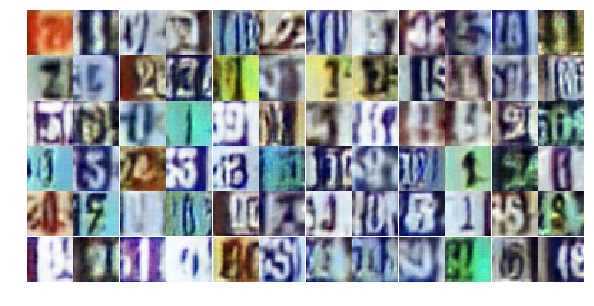

Epoch 9/25... Discriminator Loss: 2.1703... Generator Loss: 0.2907
Epoch 9/25... Discriminator Loss: 0.7491... Generator Loss: 1.7997
Epoch 9/25... Discriminator Loss: 0.5940... Generator Loss: 1.1184
Epoch 9/25... Discriminator Loss: 1.0895... Generator Loss: 0.5918
Epoch 9/25... Discriminator Loss: 0.5406... Generator Loss: 1.3028
Epoch 10/25... Discriminator Loss: 0.6379... Generator Loss: 1.0551
Epoch 10/25... Discriminator Loss: 0.5837... Generator Loss: 1.7102
Epoch 10/25... Discriminator Loss: 0.5680... Generator Loss: 1.3140
Epoch 10/25... Discriminator Loss: 0.7837... Generator Loss: 0.8599
Epoch 10/25... Discriminator Loss: 1.2475... Generator Loss: 0.4712


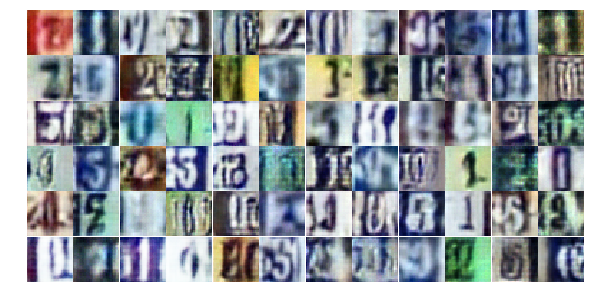

Epoch 10/25... Discriminator Loss: 0.6421... Generator Loss: 1.0263
Epoch 10/25... Discriminator Loss: 0.6000... Generator Loss: 1.1174
Epoch 10/25... Discriminator Loss: 0.5001... Generator Loss: 1.3664
Epoch 10/25... Discriminator Loss: 0.5850... Generator Loss: 1.7126
Epoch 10/25... Discriminator Loss: 0.5060... Generator Loss: 1.3175
Epoch 10/25... Discriminator Loss: 0.5744... Generator Loss: 1.3219
Epoch 10/25... Discriminator Loss: 0.3964... Generator Loss: 1.6316
Epoch 10/25... Discriminator Loss: 1.2456... Generator Loss: 0.5110
Epoch 10/25... Discriminator Loss: 1.3620... Generator Loss: 0.4151
Epoch 10/25... Discriminator Loss: 0.6389... Generator Loss: 1.0924


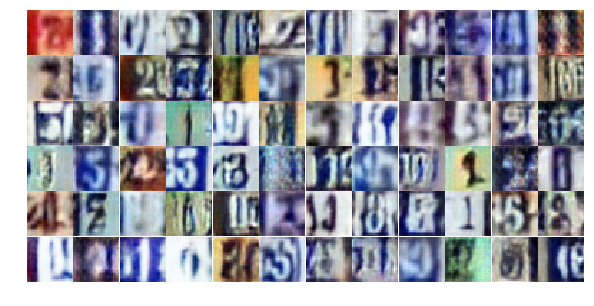

Epoch 10/25... Discriminator Loss: 0.8616... Generator Loss: 0.7826
Epoch 10/25... Discriminator Loss: 0.6326... Generator Loss: 1.0609
Epoch 10/25... Discriminator Loss: 0.7759... Generator Loss: 0.8397
Epoch 10/25... Discriminator Loss: 1.0525... Generator Loss: 0.6028
Epoch 10/25... Discriminator Loss: 0.4797... Generator Loss: 1.5265
Epoch 10/25... Discriminator Loss: 0.3875... Generator Loss: 1.9408
Epoch 10/25... Discriminator Loss: 0.5553... Generator Loss: 1.3135
Epoch 10/25... Discriminator Loss: 0.4502... Generator Loss: 1.6996
Epoch 10/25... Discriminator Loss: 0.7458... Generator Loss: 0.8724
Epoch 10/25... Discriminator Loss: 0.2939... Generator Loss: 2.3777


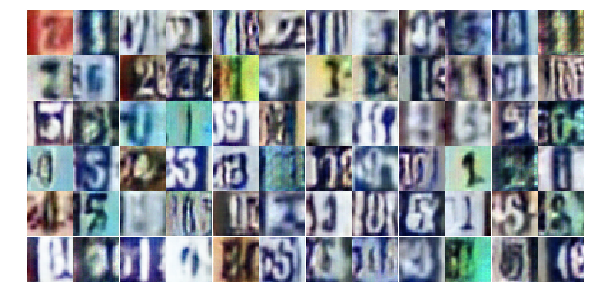

Epoch 10/25... Discriminator Loss: 0.9667... Generator Loss: 0.6907
Epoch 10/25... Discriminator Loss: 0.8479... Generator Loss: 0.8022
Epoch 10/25... Discriminator Loss: 0.4359... Generator Loss: 2.3339
Epoch 10/25... Discriminator Loss: 0.7455... Generator Loss: 3.1075
Epoch 10/25... Discriminator Loss: 1.2254... Generator Loss: 0.4595
Epoch 10/25... Discriminator Loss: 0.7299... Generator Loss: 0.9733
Epoch 10/25... Discriminator Loss: 0.3679... Generator Loss: 1.6805
Epoch 10/25... Discriminator Loss: 0.6844... Generator Loss: 1.0052
Epoch 10/25... Discriminator Loss: 0.5142... Generator Loss: 1.3035
Epoch 10/25... Discriminator Loss: 0.6058... Generator Loss: 1.7999


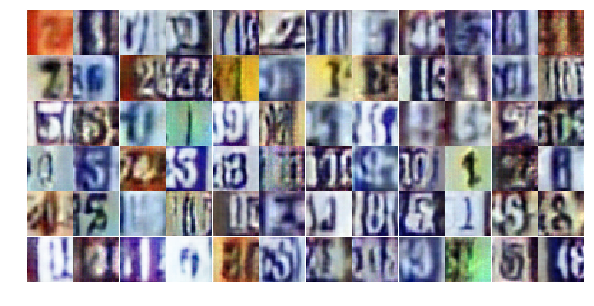

Epoch 10/25... Discriminator Loss: 0.5393... Generator Loss: 1.5396
Epoch 10/25... Discriminator Loss: 0.5428... Generator Loss: 1.4726
Epoch 10/25... Discriminator Loss: 0.5254... Generator Loss: 2.7828
Epoch 10/25... Discriminator Loss: 0.4306... Generator Loss: 2.1726
Epoch 10/25... Discriminator Loss: 0.6295... Generator Loss: 1.1240
Epoch 10/25... Discriminator Loss: 0.7918... Generator Loss: 1.0159
Epoch 10/25... Discriminator Loss: 0.8128... Generator Loss: 0.8757
Epoch 10/25... Discriminator Loss: 1.1232... Generator Loss: 0.5117
Epoch 10/25... Discriminator Loss: 0.4964... Generator Loss: 1.4998
Epoch 10/25... Discriminator Loss: 0.6958... Generator Loss: 1.1093


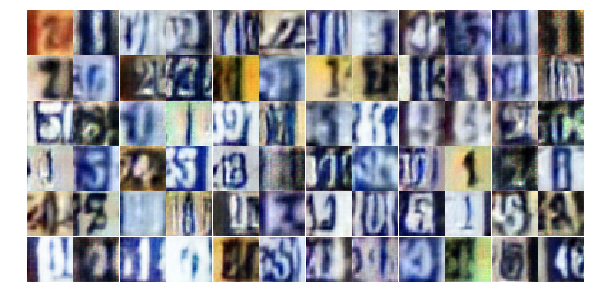

Epoch 10/25... Discriminator Loss: 0.6198... Generator Loss: 1.1614
Epoch 10/25... Discriminator Loss: 0.6896... Generator Loss: 1.0047
Epoch 10/25... Discriminator Loss: 0.7866... Generator Loss: 0.8216
Epoch 10/25... Discriminator Loss: 0.8672... Generator Loss: 0.9877
Epoch 10/25... Discriminator Loss: 0.6761... Generator Loss: 2.3017
Epoch 10/25... Discriminator Loss: 0.5932... Generator Loss: 1.0630
Epoch 10/25... Discriminator Loss: 0.5624... Generator Loss: 1.1927
Epoch 10/25... Discriminator Loss: 0.8260... Generator Loss: 3.4927
Epoch 10/25... Discriminator Loss: 0.5693... Generator Loss: 2.3131
Epoch 10/25... Discriminator Loss: 0.5691... Generator Loss: 1.7637


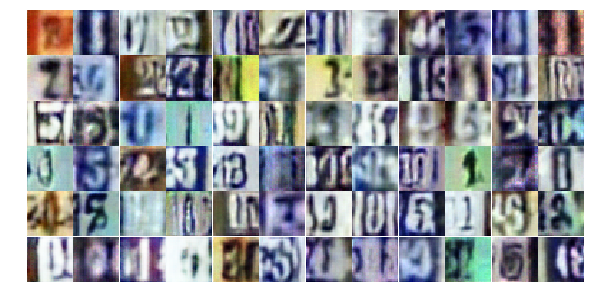

Epoch 10/25... Discriminator Loss: 0.7585... Generator Loss: 1.1562
Epoch 10/25... Discriminator Loss: 0.4343... Generator Loss: 1.5805
Epoch 10/25... Discriminator Loss: 0.4858... Generator Loss: 1.3701
Epoch 11/25... Discriminator Loss: 0.9632... Generator Loss: 0.6368
Epoch 11/25... Discriminator Loss: 0.6552... Generator Loss: 0.9923
Epoch 11/25... Discriminator Loss: 1.5678... Generator Loss: 0.3178
Epoch 11/25... Discriminator Loss: 0.9212... Generator Loss: 0.6334
Epoch 11/25... Discriminator Loss: 0.6583... Generator Loss: 1.1106
Epoch 11/25... Discriminator Loss: 1.1835... Generator Loss: 0.5887
Epoch 11/25... Discriminator Loss: 0.4174... Generator Loss: 2.0208


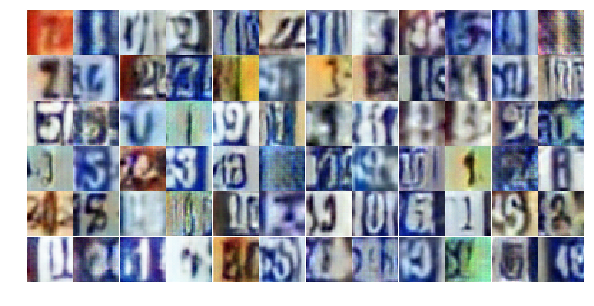

Epoch 11/25... Discriminator Loss: 0.4175... Generator Loss: 1.9370
Epoch 11/25... Discriminator Loss: 0.5752... Generator Loss: 1.2669
Epoch 11/25... Discriminator Loss: 0.4673... Generator Loss: 1.3750
Epoch 11/25... Discriminator Loss: 0.8348... Generator Loss: 0.8463
Epoch 11/25... Discriminator Loss: 0.7216... Generator Loss: 0.9360
Epoch 11/25... Discriminator Loss: 0.4339... Generator Loss: 1.8903
Epoch 11/25... Discriminator Loss: 0.6542... Generator Loss: 3.0356
Epoch 11/25... Discriminator Loss: 0.4565... Generator Loss: 1.8851
Epoch 11/25... Discriminator Loss: 0.6260... Generator Loss: 1.1276
Epoch 11/25... Discriminator Loss: 1.6671... Generator Loss: 0.3039


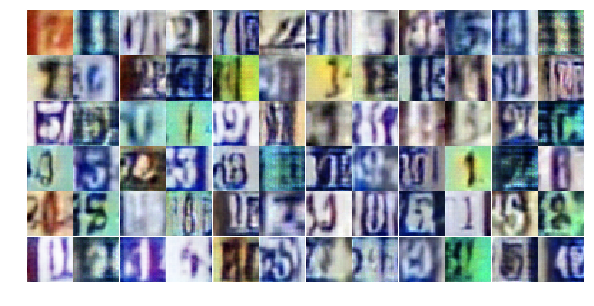

Epoch 11/25... Discriminator Loss: 1.2186... Generator Loss: 0.7768
Epoch 11/25... Discriminator Loss: 0.4710... Generator Loss: 1.8316
Epoch 11/25... Discriminator Loss: 0.8219... Generator Loss: 0.8013
Epoch 11/25... Discriminator Loss: 0.7217... Generator Loss: 1.0946
Epoch 11/25... Discriminator Loss: 0.4167... Generator Loss: 1.5794
Epoch 11/25... Discriminator Loss: 0.5172... Generator Loss: 1.4441
Epoch 11/25... Discriminator Loss: 0.5851... Generator Loss: 1.1801
Epoch 11/25... Discriminator Loss: 0.8795... Generator Loss: 0.8115
Epoch 11/25... Discriminator Loss: 0.3555... Generator Loss: 1.8170
Epoch 11/25... Discriminator Loss: 0.8074... Generator Loss: 0.7996


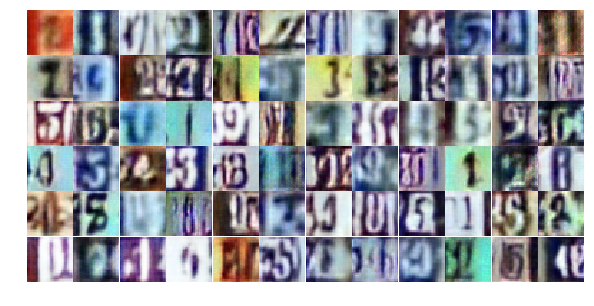

Epoch 11/25... Discriminator Loss: 0.7988... Generator Loss: 0.8298
Epoch 11/25... Discriminator Loss: 0.6305... Generator Loss: 1.9221
Epoch 11/25... Discriminator Loss: 0.7666... Generator Loss: 0.9616
Epoch 11/25... Discriminator Loss: 0.5474... Generator Loss: 1.2122
Epoch 11/25... Discriminator Loss: 0.7215... Generator Loss: 0.9533
Epoch 11/25... Discriminator Loss: 0.8753... Generator Loss: 0.7777
Epoch 11/25... Discriminator Loss: 1.2636... Generator Loss: 0.4819
Epoch 11/25... Discriminator Loss: 1.1296... Generator Loss: 0.5661
Epoch 11/25... Discriminator Loss: 0.6465... Generator Loss: 1.0783
Epoch 11/25... Discriminator Loss: 1.3137... Generator Loss: 0.4610


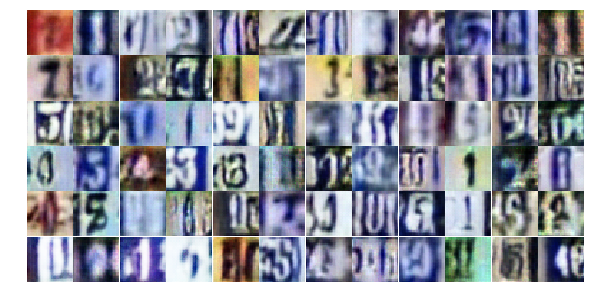

Epoch 11/25... Discriminator Loss: 0.4975... Generator Loss: 1.4678
Epoch 11/25... Discriminator Loss: 0.4486... Generator Loss: 1.5190
Epoch 11/25... Discriminator Loss: 0.7111... Generator Loss: 0.9425
Epoch 11/25... Discriminator Loss: 0.6030... Generator Loss: 1.0406
Epoch 11/25... Discriminator Loss: 1.0148... Generator Loss: 0.5958
Epoch 11/25... Discriminator Loss: 0.7105... Generator Loss: 0.9486
Epoch 11/25... Discriminator Loss: 0.3133... Generator Loss: 2.2645
Epoch 11/25... Discriminator Loss: 0.7115... Generator Loss: 0.9793
Epoch 11/25... Discriminator Loss: 1.6449... Generator Loss: 0.3041
Epoch 11/25... Discriminator Loss: 0.4269... Generator Loss: 1.5300


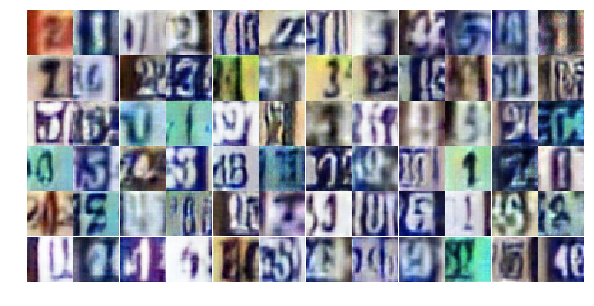

Epoch 11/25... Discriminator Loss: 0.7894... Generator Loss: 0.8725
Epoch 11/25... Discriminator Loss: 0.4716... Generator Loss: 1.4557
Epoch 11/25... Discriminator Loss: 0.5536... Generator Loss: 1.3767
Epoch 11/25... Discriminator Loss: 0.7446... Generator Loss: 0.8688
Epoch 11/25... Discriminator Loss: 1.3635... Generator Loss: 0.4221
Epoch 11/25... Discriminator Loss: 0.4945... Generator Loss: 1.4690
Epoch 11/25... Discriminator Loss: 1.0348... Generator Loss: 0.6202
Epoch 11/25... Discriminator Loss: 0.5486... Generator Loss: 2.0551
Epoch 11/25... Discriminator Loss: 1.2879... Generator Loss: 0.4735
Epoch 11/25... Discriminator Loss: 0.7189... Generator Loss: 1.0107


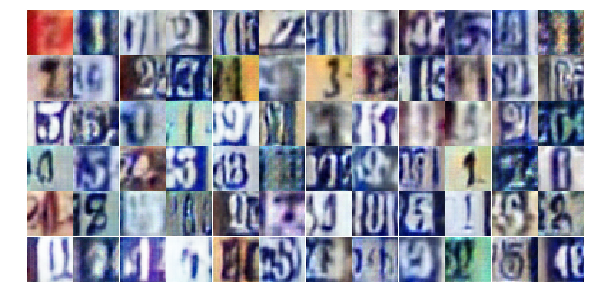

Epoch 12/25... Discriminator Loss: 1.5874... Generator Loss: 2.9582
Epoch 12/25... Discriminator Loss: 0.6345... Generator Loss: 1.9611
Epoch 12/25... Discriminator Loss: 0.8916... Generator Loss: 0.7533
Epoch 12/25... Discriminator Loss: 0.4537... Generator Loss: 1.6557
Epoch 12/25... Discriminator Loss: 0.5591... Generator Loss: 2.2280
Epoch 12/25... Discriminator Loss: 1.1352... Generator Loss: 0.5298
Epoch 12/25... Discriminator Loss: 0.5374... Generator Loss: 1.6024
Epoch 12/25... Discriminator Loss: 0.4642... Generator Loss: 1.9424
Epoch 12/25... Discriminator Loss: 0.5707... Generator Loss: 1.4012
Epoch 12/25... Discriminator Loss: 0.9265... Generator Loss: 0.7849


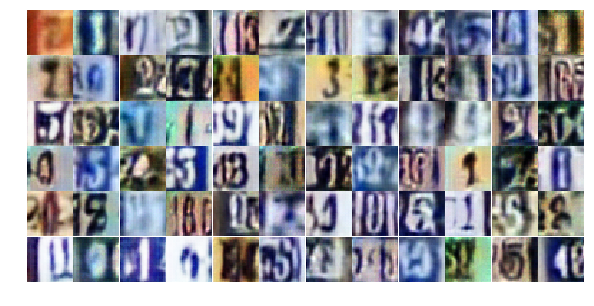

Epoch 12/25... Discriminator Loss: 0.4823... Generator Loss: 1.4180
Epoch 12/25... Discriminator Loss: 0.8898... Generator Loss: 0.7122
Epoch 12/25... Discriminator Loss: 4.1721... Generator Loss: 0.1148
Epoch 12/25... Discriminator Loss: 1.5616... Generator Loss: 2.3452
Epoch 12/25... Discriminator Loss: 0.6932... Generator Loss: 1.4170
Epoch 12/25... Discriminator Loss: 0.7137... Generator Loss: 0.9786
Epoch 12/25... Discriminator Loss: 1.5557... Generator Loss: 0.3585
Epoch 12/25... Discriminator Loss: 0.4416... Generator Loss: 1.9181
Epoch 12/25... Discriminator Loss: 0.7603... Generator Loss: 0.9750
Epoch 12/25... Discriminator Loss: 1.0517... Generator Loss: 0.5835


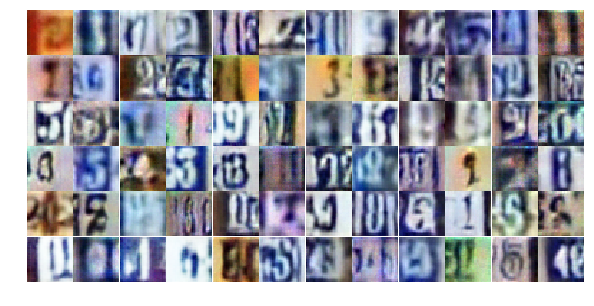

Epoch 12/25... Discriminator Loss: 0.3577... Generator Loss: 2.0019
Epoch 12/25... Discriminator Loss: 0.5464... Generator Loss: 1.2032
Epoch 12/25... Discriminator Loss: 0.6231... Generator Loss: 1.4678
Epoch 12/25... Discriminator Loss: 0.4620... Generator Loss: 1.7235
Epoch 12/25... Discriminator Loss: 0.4397... Generator Loss: 1.8745
Epoch 12/25... Discriminator Loss: 0.4581... Generator Loss: 1.4887
Epoch 12/25... Discriminator Loss: 0.6485... Generator Loss: 1.0443
Epoch 12/25... Discriminator Loss: 0.3327... Generator Loss: 2.0871
Epoch 12/25... Discriminator Loss: 0.6604... Generator Loss: 1.0027
Epoch 12/25... Discriminator Loss: 0.5759... Generator Loss: 1.1954


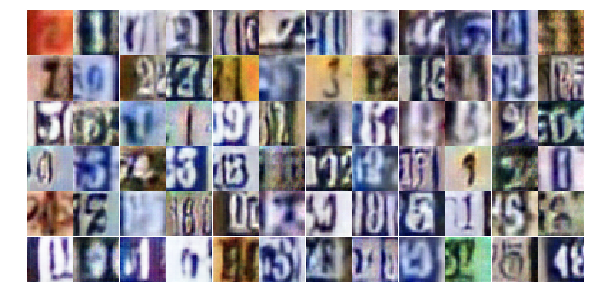

Epoch 12/25... Discriminator Loss: 0.6665... Generator Loss: 0.9523
Epoch 12/25... Discriminator Loss: 1.0022... Generator Loss: 0.6227
Epoch 12/25... Discriminator Loss: 0.8253... Generator Loss: 0.8117
Epoch 12/25... Discriminator Loss: 1.6544... Generator Loss: 0.2862
Epoch 12/25... Discriminator Loss: 0.4961... Generator Loss: 1.4973
Epoch 12/25... Discriminator Loss: 0.9833... Generator Loss: 0.6872
Epoch 12/25... Discriminator Loss: 0.8671... Generator Loss: 0.7683
Epoch 12/25... Discriminator Loss: 0.6145... Generator Loss: 1.3256
Epoch 12/25... Discriminator Loss: 0.4703... Generator Loss: 1.4485
Epoch 12/25... Discriminator Loss: 0.4229... Generator Loss: 1.4631


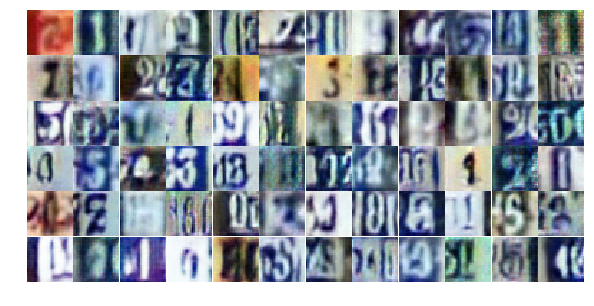

Epoch 12/25... Discriminator Loss: 0.5565... Generator Loss: 1.1342
Epoch 12/25... Discriminator Loss: 0.4342... Generator Loss: 1.8084
Epoch 12/25... Discriminator Loss: 0.3918... Generator Loss: 1.5601
Epoch 12/25... Discriminator Loss: 1.5017... Generator Loss: 0.3939
Epoch 12/25... Discriminator Loss: 0.6241... Generator Loss: 1.7025
Epoch 12/25... Discriminator Loss: 1.3758... Generator Loss: 0.4082
Epoch 12/25... Discriminator Loss: 1.1790... Generator Loss: 0.5505
Epoch 12/25... Discriminator Loss: 0.9384... Generator Loss: 0.7467
Epoch 12/25... Discriminator Loss: 0.5842... Generator Loss: 1.1550
Epoch 12/25... Discriminator Loss: 0.9075... Generator Loss: 0.7485


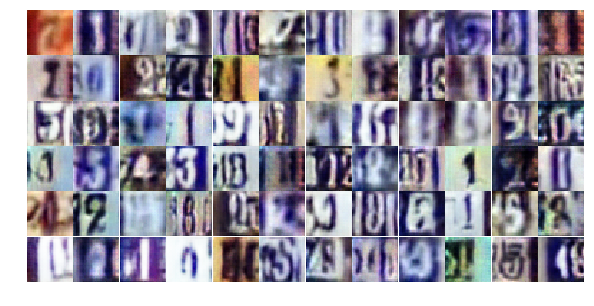

Epoch 12/25... Discriminator Loss: 1.2754... Generator Loss: 0.5851
Epoch 12/25... Discriminator Loss: 0.7703... Generator Loss: 0.8906
Epoch 12/25... Discriminator Loss: 0.5984... Generator Loss: 1.2213
Epoch 12/25... Discriminator Loss: 1.8368... Generator Loss: 0.2460
Epoch 12/25... Discriminator Loss: 0.5718... Generator Loss: 1.4642
Epoch 12/25... Discriminator Loss: 0.6452... Generator Loss: 2.3557
Epoch 12/25... Discriminator Loss: 0.7693... Generator Loss: 1.0559
Epoch 13/25... Discriminator Loss: 0.6054... Generator Loss: 1.3109
Epoch 13/25... Discriminator Loss: 0.5288... Generator Loss: 1.2767
Epoch 13/25... Discriminator Loss: 0.8688... Generator Loss: 0.7517


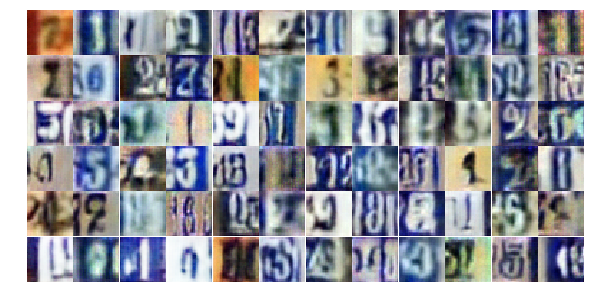

Epoch 13/25... Discriminator Loss: 0.4249... Generator Loss: 1.7181
Epoch 13/25... Discriminator Loss: 0.5882... Generator Loss: 2.0130
Epoch 13/25... Discriminator Loss: 0.9549... Generator Loss: 0.6768
Epoch 13/25... Discriminator Loss: 1.4134... Generator Loss: 0.4374
Epoch 13/25... Discriminator Loss: 0.7103... Generator Loss: 1.0866
Epoch 13/25... Discriminator Loss: 0.6013... Generator Loss: 1.2464
Epoch 13/25... Discriminator Loss: 0.3696... Generator Loss: 1.9071
Epoch 13/25... Discriminator Loss: 0.7294... Generator Loss: 0.8853
Epoch 13/25... Discriminator Loss: 0.5322... Generator Loss: 1.1797
Epoch 13/25... Discriminator Loss: 0.4810... Generator Loss: 1.6236


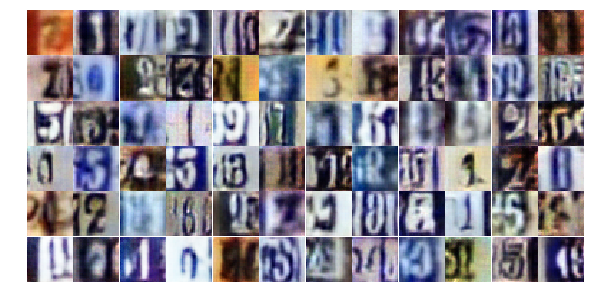

Epoch 13/25... Discriminator Loss: 1.0986... Generator Loss: 0.8706
Epoch 13/25... Discriminator Loss: 0.6492... Generator Loss: 1.1022
Epoch 13/25... Discriminator Loss: 0.9477... Generator Loss: 0.7112
Epoch 13/25... Discriminator Loss: 0.7020... Generator Loss: 0.9425
Epoch 13/25... Discriminator Loss: 0.4407... Generator Loss: 1.5997
Epoch 13/25... Discriminator Loss: 0.8883... Generator Loss: 1.4338
Epoch 13/25... Discriminator Loss: 0.6633... Generator Loss: 1.1012
Epoch 13/25... Discriminator Loss: 1.0728... Generator Loss: 0.5784
Epoch 13/25... Discriminator Loss: 0.4821... Generator Loss: 1.4549
Epoch 13/25... Discriminator Loss: 1.0085... Generator Loss: 0.6131


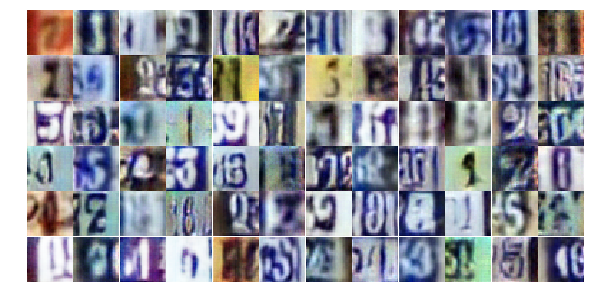

Epoch 13/25... Discriminator Loss: 0.8820... Generator Loss: 0.7608
Epoch 13/25... Discriminator Loss: 0.6580... Generator Loss: 1.1209
Epoch 13/25... Discriminator Loss: 0.9104... Generator Loss: 3.0582
Epoch 13/25... Discriminator Loss: 0.5625... Generator Loss: 1.2773
Epoch 13/25... Discriminator Loss: 0.5329... Generator Loss: 1.2654
Epoch 13/25... Discriminator Loss: 1.4429... Generator Loss: 0.4195
Epoch 13/25... Discriminator Loss: 0.8663... Generator Loss: 1.9938
Epoch 13/25... Discriminator Loss: 0.5429... Generator Loss: 1.3617
Epoch 13/25... Discriminator Loss: 0.5545... Generator Loss: 1.2356
Epoch 13/25... Discriminator Loss: 0.6368... Generator Loss: 1.0378


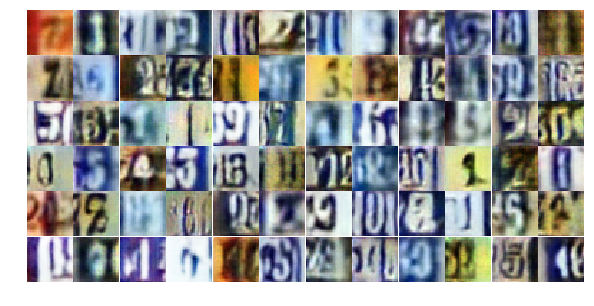

Epoch 13/25... Discriminator Loss: 1.2034... Generator Loss: 0.5083
Epoch 13/25... Discriminator Loss: 0.9430... Generator Loss: 1.1703
Epoch 13/25... Discriminator Loss: 0.9156... Generator Loss: 0.7529
Epoch 13/25... Discriminator Loss: 0.6884... Generator Loss: 1.0895
Epoch 13/25... Discriminator Loss: 0.5042... Generator Loss: 1.2701
Epoch 13/25... Discriminator Loss: 0.4782... Generator Loss: 1.5463
Epoch 13/25... Discriminator Loss: 0.4892... Generator Loss: 1.2974
Epoch 13/25... Discriminator Loss: 0.7010... Generator Loss: 1.2134
Epoch 13/25... Discriminator Loss: 0.5950... Generator Loss: 1.2072
Epoch 13/25... Discriminator Loss: 0.4565... Generator Loss: 2.0896


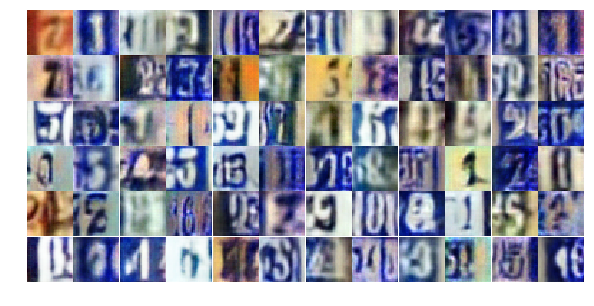

Epoch 13/25... Discriminator Loss: 0.6209... Generator Loss: 1.2807
Epoch 13/25... Discriminator Loss: 0.8908... Generator Loss: 0.7937
Epoch 13/25... Discriminator Loss: 0.8978... Generator Loss: 0.8380
Epoch 13/25... Discriminator Loss: 0.4647... Generator Loss: 1.6718
Epoch 13/25... Discriminator Loss: 1.1788... Generator Loss: 0.5218
Epoch 13/25... Discriminator Loss: 0.5306... Generator Loss: 1.2624
Epoch 13/25... Discriminator Loss: 0.8768... Generator Loss: 0.8115
Epoch 13/25... Discriminator Loss: 0.9813... Generator Loss: 0.6575
Epoch 13/25... Discriminator Loss: 0.8246... Generator Loss: 0.8626
Epoch 13/25... Discriminator Loss: 0.8243... Generator Loss: 0.7979


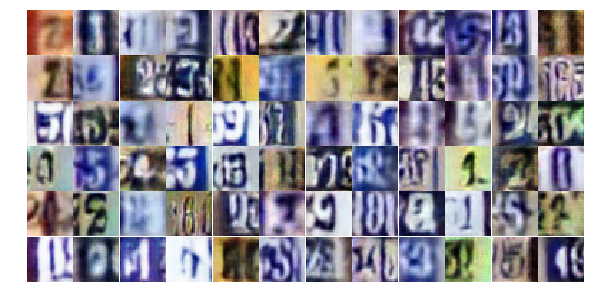

Epoch 13/25... Discriminator Loss: 0.2903... Generator Loss: 2.4550
Epoch 13/25... Discriminator Loss: 0.5943... Generator Loss: 1.2825
Epoch 13/25... Discriminator Loss: 0.9713... Generator Loss: 0.6823
Epoch 13/25... Discriminator Loss: 1.1207... Generator Loss: 0.5529
Epoch 14/25... Discriminator Loss: 1.0987... Generator Loss: 0.6759
Epoch 14/25... Discriminator Loss: 1.0805... Generator Loss: 0.5850
Epoch 14/25... Discriminator Loss: 0.9365... Generator Loss: 0.9027
Epoch 14/25... Discriminator Loss: 0.5901... Generator Loss: 1.1798
Epoch 14/25... Discriminator Loss: 0.4936... Generator Loss: 1.3170
Epoch 14/25... Discriminator Loss: 0.6370... Generator Loss: 1.1419


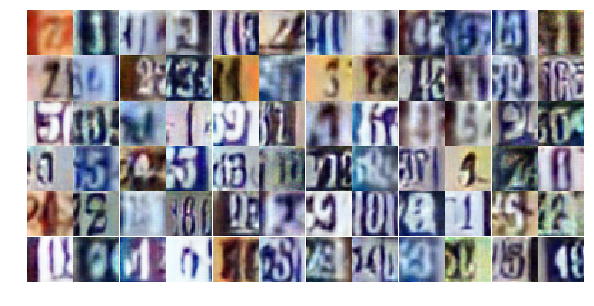

Epoch 14/25... Discriminator Loss: 0.7259... Generator Loss: 1.0667
Epoch 14/25... Discriminator Loss: 0.7877... Generator Loss: 0.8171
Epoch 14/25... Discriminator Loss: 0.6918... Generator Loss: 1.0011
Epoch 14/25... Discriminator Loss: 0.8095... Generator Loss: 0.7948
Epoch 14/25... Discriminator Loss: 0.9497... Generator Loss: 0.6587
Epoch 14/25... Discriminator Loss: 0.2487... Generator Loss: 2.0767
Epoch 14/25... Discriminator Loss: 0.3212... Generator Loss: 2.2026
Epoch 14/25... Discriminator Loss: 1.8132... Generator Loss: 0.2786
Epoch 14/25... Discriminator Loss: 1.3148... Generator Loss: 0.4925
Epoch 14/25... Discriminator Loss: 1.4269... Generator Loss: 0.3893


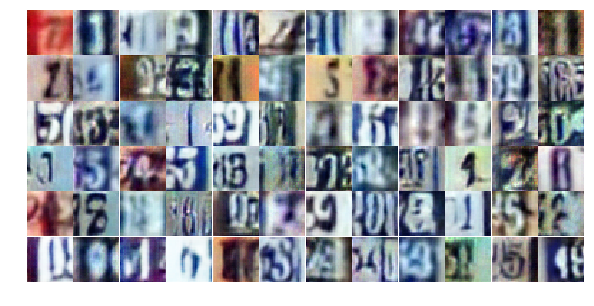

Epoch 14/25... Discriminator Loss: 0.6755... Generator Loss: 0.9556
Epoch 14/25... Discriminator Loss: 0.5930... Generator Loss: 1.5933
Epoch 14/25... Discriminator Loss: 0.6183... Generator Loss: 1.3958
Epoch 14/25... Discriminator Loss: 0.4462... Generator Loss: 1.7314
Epoch 14/25... Discriminator Loss: 0.9827... Generator Loss: 0.6935
Epoch 14/25... Discriminator Loss: 0.7034... Generator Loss: 1.0840
Epoch 14/25... Discriminator Loss: 0.6430... Generator Loss: 1.0627
Epoch 14/25... Discriminator Loss: 0.7667... Generator Loss: 0.9146
Epoch 14/25... Discriminator Loss: 0.5079... Generator Loss: 1.2326
Epoch 14/25... Discriminator Loss: 0.5143... Generator Loss: 1.5970


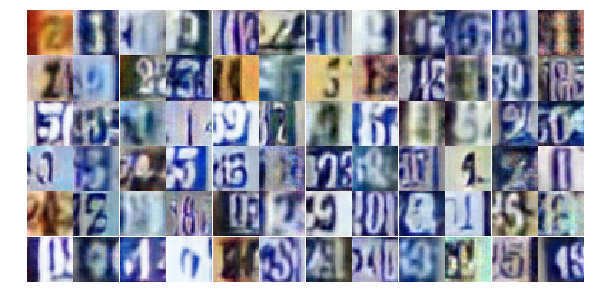

Epoch 14/25... Discriminator Loss: 1.6182... Generator Loss: 0.3154
Epoch 14/25... Discriminator Loss: 0.5370... Generator Loss: 2.4166
Epoch 14/25... Discriminator Loss: 0.6202... Generator Loss: 1.1617
Epoch 14/25... Discriminator Loss: 0.3862... Generator Loss: 1.5632
Epoch 14/25... Discriminator Loss: 0.5955... Generator Loss: 1.3606
Epoch 14/25... Discriminator Loss: 0.9075... Generator Loss: 0.6993
Epoch 14/25... Discriminator Loss: 0.8090... Generator Loss: 0.8482
Epoch 14/25... Discriminator Loss: 0.4762... Generator Loss: 1.4926
Epoch 14/25... Discriminator Loss: 0.3603... Generator Loss: 2.0465
Epoch 14/25... Discriminator Loss: 1.2421... Generator Loss: 2.2980


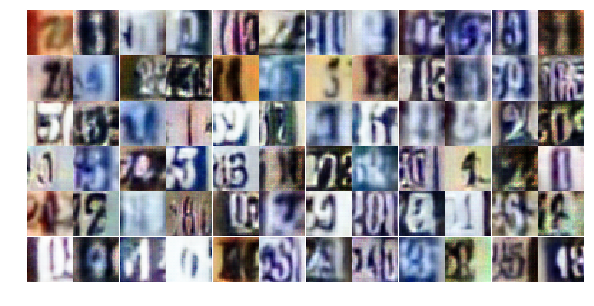

Epoch 14/25... Discriminator Loss: 0.9468... Generator Loss: 0.8495
Epoch 14/25... Discriminator Loss: 0.8594... Generator Loss: 0.7905
Epoch 14/25... Discriminator Loss: 0.9082... Generator Loss: 0.7316
Epoch 14/25... Discriminator Loss: 0.9503... Generator Loss: 0.6958
Epoch 14/25... Discriminator Loss: 0.8195... Generator Loss: 0.7830
Epoch 14/25... Discriminator Loss: 0.7018... Generator Loss: 1.0683
Epoch 14/25... Discriminator Loss: 0.7826... Generator Loss: 0.8956
Epoch 14/25... Discriminator Loss: 0.5183... Generator Loss: 1.4813
Epoch 14/25... Discriminator Loss: 2.1454... Generator Loss: 0.9590
Epoch 14/25... Discriminator Loss: 1.3839... Generator Loss: 0.4276


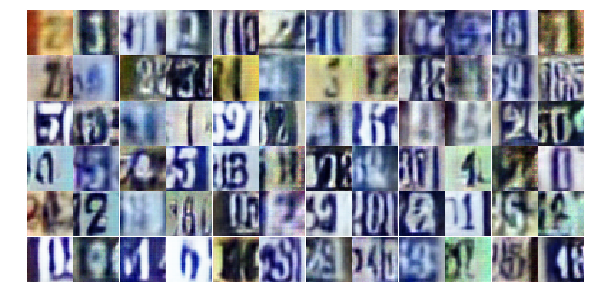

Epoch 14/25... Discriminator Loss: 0.9987... Generator Loss: 0.7762
Epoch 14/25... Discriminator Loss: 0.9940... Generator Loss: 0.7538
Epoch 14/25... Discriminator Loss: 0.7448... Generator Loss: 0.8916
Epoch 14/25... Discriminator Loss: 0.9899... Generator Loss: 0.6721
Epoch 14/25... Discriminator Loss: 0.8369... Generator Loss: 0.8008
Epoch 14/25... Discriminator Loss: 0.6904... Generator Loss: 0.9566
Epoch 14/25... Discriminator Loss: 0.8222... Generator Loss: 0.9374
Epoch 14/25... Discriminator Loss: 0.7229... Generator Loss: 0.9936
Epoch 14/25... Discriminator Loss: 1.3641... Generator Loss: 0.3964
Epoch 14/25... Discriminator Loss: 1.4595... Generator Loss: 0.3600


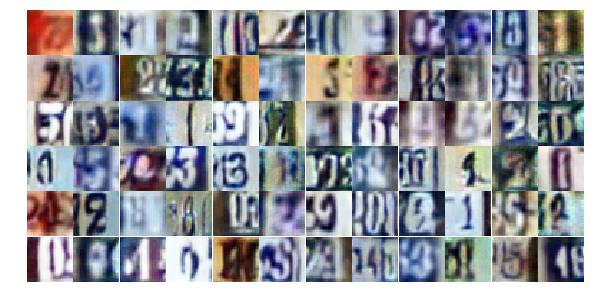

Epoch 14/25... Discriminator Loss: 0.7689... Generator Loss: 1.7042
Epoch 14/25... Discriminator Loss: 0.9808... Generator Loss: 0.6711
Epoch 15/25... Discriminator Loss: 0.7470... Generator Loss: 0.9801
Epoch 15/25... Discriminator Loss: 0.4294... Generator Loss: 1.7972
Epoch 15/25... Discriminator Loss: 0.5748... Generator Loss: 1.2140
Epoch 15/25... Discriminator Loss: 0.5519... Generator Loss: 1.2359
Epoch 15/25... Discriminator Loss: 1.1966... Generator Loss: 0.5025
Epoch 15/25... Discriminator Loss: 0.5892... Generator Loss: 1.2003
Epoch 15/25... Discriminator Loss: 0.9588... Generator Loss: 0.7055
Epoch 15/25... Discriminator Loss: 0.6867... Generator Loss: 0.9238


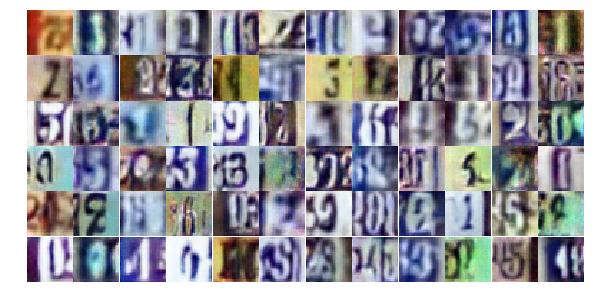

Epoch 15/25... Discriminator Loss: 0.6934... Generator Loss: 1.0123
Epoch 15/25... Discriminator Loss: 0.6887... Generator Loss: 1.1429
Epoch 15/25... Discriminator Loss: 0.8384... Generator Loss: 0.8108
Epoch 15/25... Discriminator Loss: 0.8077... Generator Loss: 0.7750
Epoch 15/25... Discriminator Loss: 1.0941... Generator Loss: 0.6030
Epoch 15/25... Discriminator Loss: 0.5211... Generator Loss: 1.7987
Epoch 15/25... Discriminator Loss: 1.0061... Generator Loss: 0.6467
Epoch 15/25... Discriminator Loss: 0.8950... Generator Loss: 0.8460
Epoch 15/25... Discriminator Loss: 0.5953... Generator Loss: 2.1723
Epoch 15/25... Discriminator Loss: 1.2836... Generator Loss: 0.5091


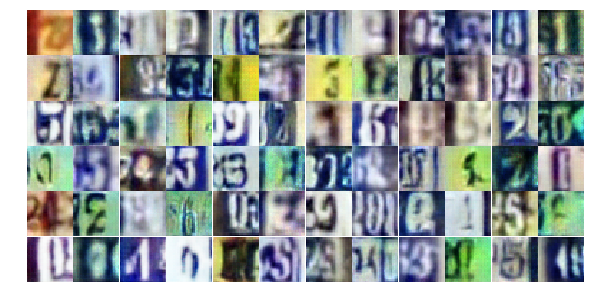

Epoch 15/25... Discriminator Loss: 1.1960... Generator Loss: 0.4907
Epoch 15/25... Discriminator Loss: 0.5050... Generator Loss: 1.3742
Epoch 15/25... Discriminator Loss: 0.4635... Generator Loss: 1.5724
Epoch 15/25... Discriminator Loss: 0.9153... Generator Loss: 0.7384
Epoch 15/25... Discriminator Loss: 0.8372... Generator Loss: 1.0379
Epoch 15/25... Discriminator Loss: 0.3893... Generator Loss: 1.9278
Epoch 15/25... Discriminator Loss: 0.6809... Generator Loss: 1.1060
Epoch 15/25... Discriminator Loss: 0.8205... Generator Loss: 0.8292
Epoch 15/25... Discriminator Loss: 0.4745... Generator Loss: 1.3389
Epoch 15/25... Discriminator Loss: 1.3795... Generator Loss: 0.4318


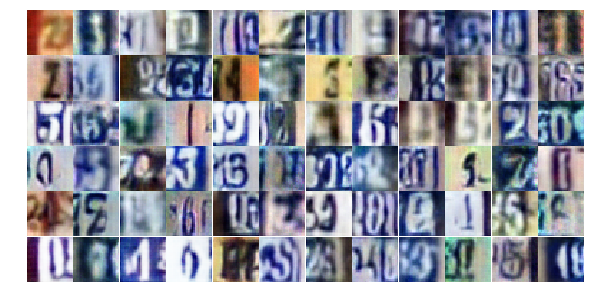

Epoch 15/25... Discriminator Loss: 0.6235... Generator Loss: 1.0975
Epoch 15/25... Discriminator Loss: 0.9219... Generator Loss: 0.6808
Epoch 15/25... Discriminator Loss: 0.4136... Generator Loss: 1.5313
Epoch 15/25... Discriminator Loss: 0.6738... Generator Loss: 1.3684
Epoch 15/25... Discriminator Loss: 0.5455... Generator Loss: 1.2140
Epoch 15/25... Discriminator Loss: 1.0906... Generator Loss: 2.4788
Epoch 15/25... Discriminator Loss: 0.5504... Generator Loss: 1.3131
Epoch 15/25... Discriminator Loss: 0.5521... Generator Loss: 1.3001
Epoch 15/25... Discriminator Loss: 0.5772... Generator Loss: 1.2289
Epoch 15/25... Discriminator Loss: 0.7762... Generator Loss: 1.1329


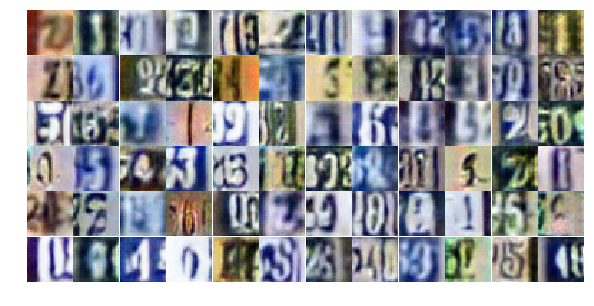

Epoch 15/25... Discriminator Loss: 0.5867... Generator Loss: 1.1281
Epoch 15/25... Discriminator Loss: 1.4686... Generator Loss: 0.3489
Epoch 15/25... Discriminator Loss: 0.8083... Generator Loss: 0.9093
Epoch 15/25... Discriminator Loss: 0.6562... Generator Loss: 0.9860
Epoch 15/25... Discriminator Loss: 0.5665... Generator Loss: 1.1282
Epoch 15/25... Discriminator Loss: 1.1858... Generator Loss: 0.4981
Epoch 15/25... Discriminator Loss: 0.5943... Generator Loss: 1.1006
Epoch 15/25... Discriminator Loss: 0.7535... Generator Loss: 1.7291
Epoch 15/25... Discriminator Loss: 0.7315... Generator Loss: 0.9004
Epoch 15/25... Discriminator Loss: 0.5752... Generator Loss: 1.6496


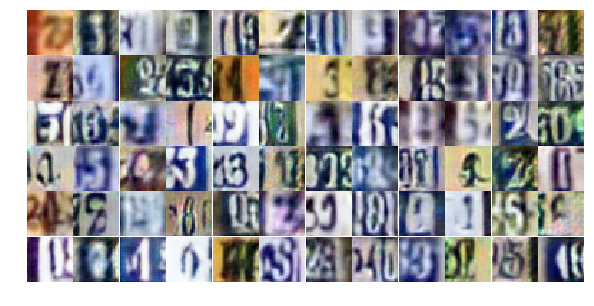

Epoch 15/25... Discriminator Loss: 1.2081... Generator Loss: 0.5172
Epoch 15/25... Discriminator Loss: 1.0841... Generator Loss: 0.6045
Epoch 15/25... Discriminator Loss: 0.7250... Generator Loss: 0.9040
Epoch 15/25... Discriminator Loss: 0.8358... Generator Loss: 0.8666
Epoch 15/25... Discriminator Loss: 0.6583... Generator Loss: 1.0739
Epoch 15/25... Discriminator Loss: 0.5253... Generator Loss: 1.5602
Epoch 15/25... Discriminator Loss: 0.8696... Generator Loss: 0.9064
Epoch 15/25... Discriminator Loss: 0.5315... Generator Loss: 1.5244
Epoch 15/25... Discriminator Loss: 1.4177... Generator Loss: 0.3835
Epoch 16/25... Discriminator Loss: 1.3552... Generator Loss: 0.4356


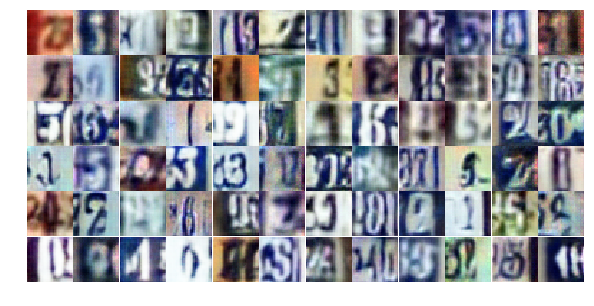

Epoch 16/25... Discriminator Loss: 0.6334... Generator Loss: 1.1612
Epoch 16/25... Discriminator Loss: 0.7511... Generator Loss: 0.9749
Epoch 16/25... Discriminator Loss: 1.3229... Generator Loss: 0.4314
Epoch 16/25... Discriminator Loss: 1.3245... Generator Loss: 0.5298
Epoch 16/25... Discriminator Loss: 1.5334... Generator Loss: 4.0268
Epoch 16/25... Discriminator Loss: 0.7492... Generator Loss: 0.9106
Epoch 16/25... Discriminator Loss: 1.3951... Generator Loss: 0.4428
Epoch 16/25... Discriminator Loss: 1.0042... Generator Loss: 0.6254
Epoch 16/25... Discriminator Loss: 0.5245... Generator Loss: 1.2059
Epoch 16/25... Discriminator Loss: 0.6512... Generator Loss: 0.9736


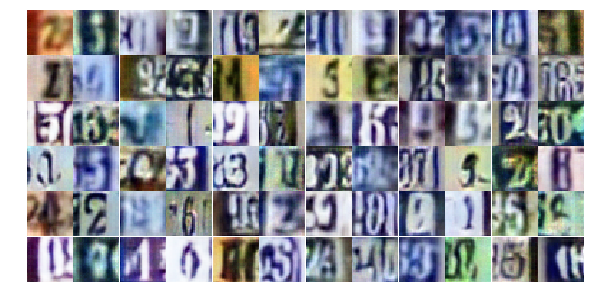

Epoch 16/25... Discriminator Loss: 1.1765... Generator Loss: 0.5379
Epoch 16/25... Discriminator Loss: 0.6511... Generator Loss: 1.8691
Epoch 16/25... Discriminator Loss: 0.6207... Generator Loss: 1.5596
Epoch 16/25... Discriminator Loss: 1.3714... Generator Loss: 0.4085
Epoch 16/25... Discriminator Loss: 0.5096... Generator Loss: 1.3710
Epoch 16/25... Discriminator Loss: 0.7673... Generator Loss: 0.9690
Epoch 16/25... Discriminator Loss: 1.3075... Generator Loss: 0.4716
Epoch 16/25... Discriminator Loss: 0.4485... Generator Loss: 1.5664
Epoch 16/25... Discriminator Loss: 0.4210... Generator Loss: 1.6010
Epoch 16/25... Discriminator Loss: 0.5283... Generator Loss: 1.3843


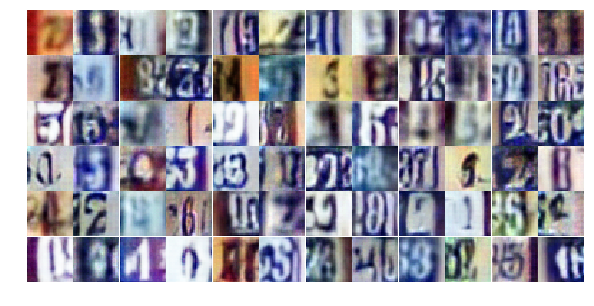

Epoch 16/25... Discriminator Loss: 0.6367... Generator Loss: 1.1615
Epoch 16/25... Discriminator Loss: 0.7014... Generator Loss: 1.6060
Epoch 16/25... Discriminator Loss: 0.7449... Generator Loss: 0.9049
Epoch 16/25... Discriminator Loss: 1.3307... Generator Loss: 0.4560
Epoch 16/25... Discriminator Loss: 0.6444... Generator Loss: 1.2338
Epoch 16/25... Discriminator Loss: 1.0059... Generator Loss: 0.6250
Epoch 16/25... Discriminator Loss: 1.0239... Generator Loss: 0.6019
Epoch 16/25... Discriminator Loss: 0.4726... Generator Loss: 2.0319
Epoch 16/25... Discriminator Loss: 0.8648... Generator Loss: 0.8911
Epoch 16/25... Discriminator Loss: 0.4667... Generator Loss: 1.4843


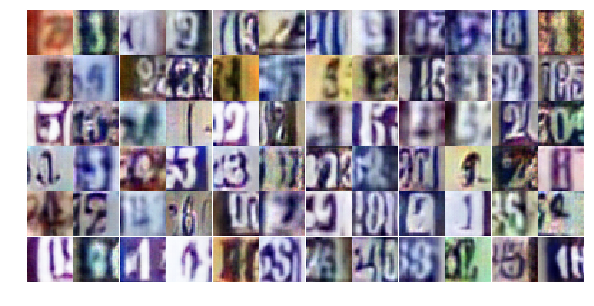

Epoch 16/25... Discriminator Loss: 0.5332... Generator Loss: 1.2068
Epoch 16/25... Discriminator Loss: 0.4034... Generator Loss: 1.6177
Epoch 16/25... Discriminator Loss: 0.6640... Generator Loss: 1.0646
Epoch 16/25... Discriminator Loss: 1.7004... Generator Loss: 0.3005
Epoch 16/25... Discriminator Loss: 0.9046... Generator Loss: 0.7556
Epoch 16/25... Discriminator Loss: 0.4837... Generator Loss: 1.5061
Epoch 16/25... Discriminator Loss: 1.1954... Generator Loss: 0.5634
Epoch 16/25... Discriminator Loss: 1.0888... Generator Loss: 0.5172
Epoch 16/25... Discriminator Loss: 0.9486... Generator Loss: 0.7153
Epoch 16/25... Discriminator Loss: 0.4702... Generator Loss: 1.5087


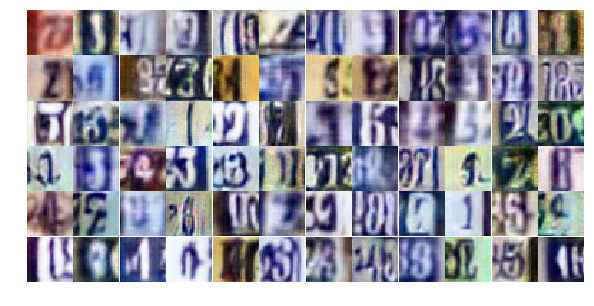

Epoch 16/25... Discriminator Loss: 0.6385... Generator Loss: 1.0856
Epoch 16/25... Discriminator Loss: 0.5444... Generator Loss: 1.2426
Epoch 16/25... Discriminator Loss: 1.6035... Generator Loss: 0.3313
Epoch 16/25... Discriminator Loss: 1.7499... Generator Loss: 0.2937
Epoch 16/25... Discriminator Loss: 0.7845... Generator Loss: 0.8650
Epoch 16/25... Discriminator Loss: 0.8596... Generator Loss: 0.8363
Epoch 16/25... Discriminator Loss: 0.5897... Generator Loss: 2.1092
Epoch 16/25... Discriminator Loss: 0.9509... Generator Loss: 0.7404
Epoch 16/25... Discriminator Loss: 0.6391... Generator Loss: 1.1333
Epoch 16/25... Discriminator Loss: 1.0545... Generator Loss: 0.5704


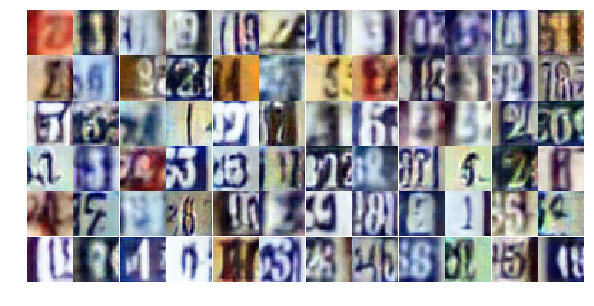

Epoch 16/25... Discriminator Loss: 1.4322... Generator Loss: 0.3855
Epoch 16/25... Discriminator Loss: 0.8331... Generator Loss: 0.7898
Epoch 16/25... Discriminator Loss: 1.6103... Generator Loss: 0.3224
Epoch 16/25... Discriminator Loss: 0.4643... Generator Loss: 1.5177
Epoch 16/25... Discriminator Loss: 0.5092... Generator Loss: 1.6524
Epoch 16/25... Discriminator Loss: 0.5471... Generator Loss: 1.2991
Epoch 17/25... Discriminator Loss: 0.9365... Generator Loss: 0.7359
Epoch 17/25... Discriminator Loss: 0.8294... Generator Loss: 0.9089
Epoch 17/25... Discriminator Loss: 0.4673... Generator Loss: 1.5544
Epoch 17/25... Discriminator Loss: 0.6319... Generator Loss: 1.1397


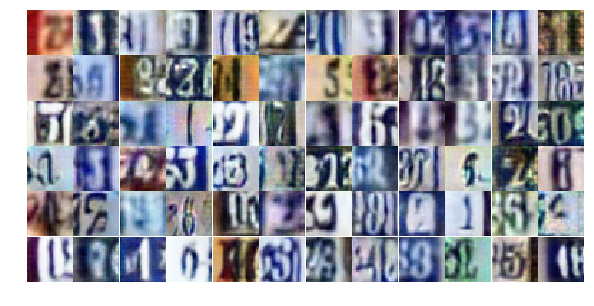

Epoch 17/25... Discriminator Loss: 0.5427... Generator Loss: 1.8086
Epoch 17/25... Discriminator Loss: 0.4035... Generator Loss: 1.6765
Epoch 17/25... Discriminator Loss: 0.8127... Generator Loss: 0.8982
Epoch 17/25... Discriminator Loss: 0.6258... Generator Loss: 1.1273
Epoch 17/25... Discriminator Loss: 0.8574... Generator Loss: 0.7540
Epoch 17/25... Discriminator Loss: 1.1964... Generator Loss: 0.5254
Epoch 17/25... Discriminator Loss: 0.6986... Generator Loss: 1.0972
Epoch 17/25... Discriminator Loss: 0.7018... Generator Loss: 0.9306
Epoch 17/25... Discriminator Loss: 0.3342... Generator Loss: 2.1801
Epoch 17/25... Discriminator Loss: 0.6130... Generator Loss: 1.0619


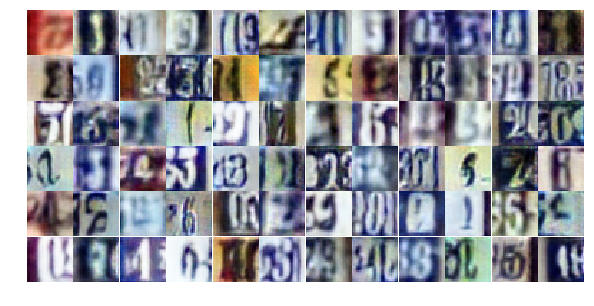

Epoch 17/25... Discriminator Loss: 0.6062... Generator Loss: 1.7374
Epoch 17/25... Discriminator Loss: 0.5901... Generator Loss: 1.7616
Epoch 17/25... Discriminator Loss: 0.6743... Generator Loss: 0.9884
Epoch 17/25... Discriminator Loss: 0.8648... Generator Loss: 1.5842
Epoch 17/25... Discriminator Loss: 0.4989... Generator Loss: 1.3428
Epoch 17/25... Discriminator Loss: 0.9549... Generator Loss: 0.7282
Epoch 17/25... Discriminator Loss: 0.5243... Generator Loss: 1.3839
Epoch 17/25... Discriminator Loss: 0.4894... Generator Loss: 1.4153
Epoch 17/25... Discriminator Loss: 0.6227... Generator Loss: 1.6585
Epoch 17/25... Discriminator Loss: 0.5996... Generator Loss: 1.2132


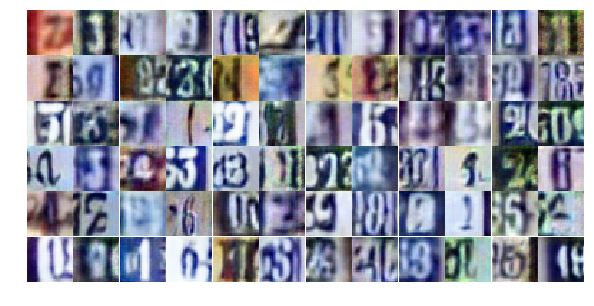

Epoch 17/25... Discriminator Loss: 1.7592... Generator Loss: 0.2608
Epoch 17/25... Discriminator Loss: 0.6069... Generator Loss: 1.2074
Epoch 17/25... Discriminator Loss: 0.5197... Generator Loss: 1.2224
Epoch 17/25... Discriminator Loss: 1.2458... Generator Loss: 0.4748
Epoch 17/25... Discriminator Loss: 0.9360... Generator Loss: 0.7477
Epoch 17/25... Discriminator Loss: 0.4395... Generator Loss: 1.4856
Epoch 17/25... Discriminator Loss: 0.7942... Generator Loss: 0.8463
Epoch 17/25... Discriminator Loss: 0.8048... Generator Loss: 0.8395
Epoch 17/25... Discriminator Loss: 1.1001... Generator Loss: 0.5486
Epoch 17/25... Discriminator Loss: 0.3009... Generator Loss: 2.1629


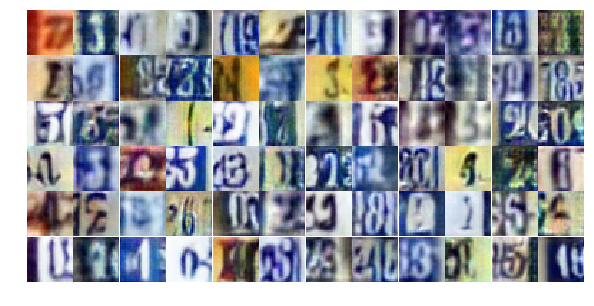

Epoch 17/25... Discriminator Loss: 0.5380... Generator Loss: 1.5103
Epoch 17/25... Discriminator Loss: 1.5194... Generator Loss: 1.2328
Epoch 17/25... Discriminator Loss: 2.2453... Generator Loss: 4.4886
Epoch 17/25... Discriminator Loss: 1.4680... Generator Loss: 1.2850
Epoch 17/25... Discriminator Loss: 0.8224... Generator Loss: 0.8900
Epoch 17/25... Discriminator Loss: 0.7046... Generator Loss: 1.0726
Epoch 17/25... Discriminator Loss: 0.7606... Generator Loss: 1.1684
Epoch 17/25... Discriminator Loss: 0.6281... Generator Loss: 1.1928
Epoch 17/25... Discriminator Loss: 0.3766... Generator Loss: 1.7266
Epoch 17/25... Discriminator Loss: 0.7660... Generator Loss: 0.8768


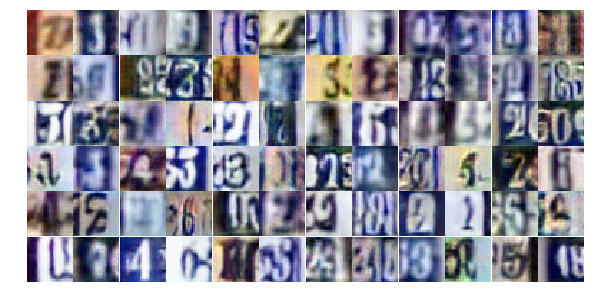

Epoch 17/25... Discriminator Loss: 1.0920... Generator Loss: 0.5919
Epoch 17/25... Discriminator Loss: 0.3674... Generator Loss: 1.5992
Epoch 17/25... Discriminator Loss: 0.7654... Generator Loss: 1.0380
Epoch 17/25... Discriminator Loss: 0.4588... Generator Loss: 1.5790
Epoch 17/25... Discriminator Loss: 0.8181... Generator Loss: 0.8718
Epoch 17/25... Discriminator Loss: 0.9136... Generator Loss: 0.7615
Epoch 17/25... Discriminator Loss: 0.8892... Generator Loss: 0.7478
Epoch 17/25... Discriminator Loss: 0.5411... Generator Loss: 1.3689
Epoch 17/25... Discriminator Loss: 0.8324... Generator Loss: 0.8863
Epoch 17/25... Discriminator Loss: 0.9592... Generator Loss: 0.7523


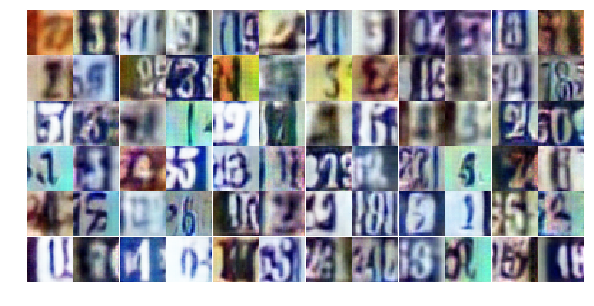

Epoch 17/25... Discriminator Loss: 0.7283... Generator Loss: 1.6104
Epoch 17/25... Discriminator Loss: 0.8052... Generator Loss: 1.2858
Epoch 17/25... Discriminator Loss: 0.6546... Generator Loss: 1.0628
Epoch 17/25... Discriminator Loss: 0.6101... Generator Loss: 1.1276
Epoch 18/25... Discriminator Loss: 1.0270... Generator Loss: 0.6488
Epoch 18/25... Discriminator Loss: 1.2200... Generator Loss: 0.5006
Epoch 18/25... Discriminator Loss: 0.7283... Generator Loss: 1.0036
Epoch 18/25... Discriminator Loss: 0.8537... Generator Loss: 0.7797
Epoch 18/25... Discriminator Loss: 0.9070... Generator Loss: 0.8461
Epoch 18/25... Discriminator Loss: 0.6825... Generator Loss: 1.1843


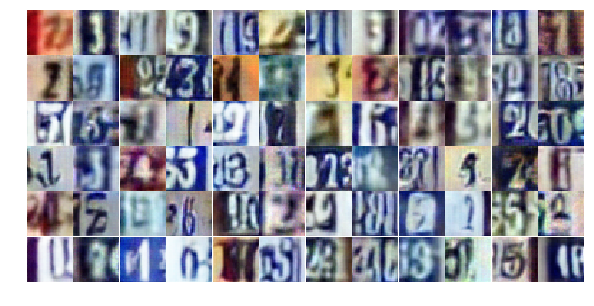

Epoch 18/25... Discriminator Loss: 0.5667... Generator Loss: 1.4103
Epoch 18/25... Discriminator Loss: 1.2915... Generator Loss: 0.4642
Epoch 18/25... Discriminator Loss: 1.0331... Generator Loss: 0.5845
Epoch 18/25... Discriminator Loss: 0.4693... Generator Loss: 1.6955
Epoch 18/25... Discriminator Loss: 0.5951... Generator Loss: 1.1912
Epoch 18/25... Discriminator Loss: 1.0433... Generator Loss: 0.6180
Epoch 18/25... Discriminator Loss: 0.4839... Generator Loss: 1.3267
Epoch 18/25... Discriminator Loss: 0.9834... Generator Loss: 0.7063
Epoch 18/25... Discriminator Loss: 0.6769... Generator Loss: 0.9834
Epoch 18/25... Discriminator Loss: 0.4230... Generator Loss: 1.4297


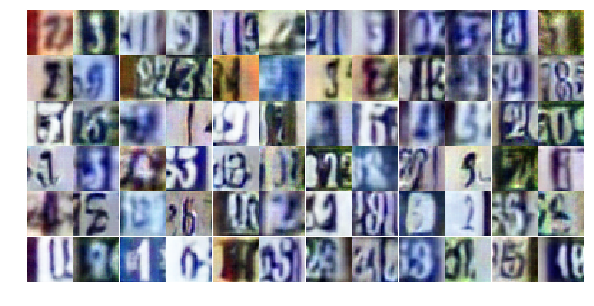

Epoch 18/25... Discriminator Loss: 0.6466... Generator Loss: 1.2533
Epoch 18/25... Discriminator Loss: 0.6701... Generator Loss: 1.3257
Epoch 18/25... Discriminator Loss: 1.2765... Generator Loss: 2.1958
Epoch 18/25... Discriminator Loss: 0.5258... Generator Loss: 1.3304
Epoch 18/25... Discriminator Loss: 0.6479... Generator Loss: 1.0117
Epoch 18/25... Discriminator Loss: 0.9235... Generator Loss: 0.6815
Epoch 18/25... Discriminator Loss: 0.8850... Generator Loss: 0.9259
Epoch 18/25... Discriminator Loss: 0.9317... Generator Loss: 0.7517
Epoch 18/25... Discriminator Loss: 0.6549... Generator Loss: 1.0202
Epoch 18/25... Discriminator Loss: 0.6594... Generator Loss: 0.9522


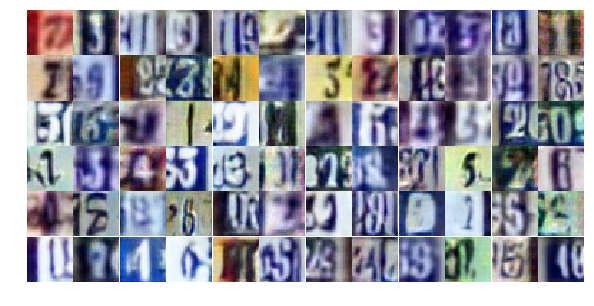

Epoch 18/25... Discriminator Loss: 0.3602... Generator Loss: 1.7740
Epoch 18/25... Discriminator Loss: 0.5426... Generator Loss: 1.4999
Epoch 18/25... Discriminator Loss: 1.0550... Generator Loss: 0.6555
Epoch 18/25... Discriminator Loss: 0.5911... Generator Loss: 1.3777
Epoch 18/25... Discriminator Loss: 0.5673... Generator Loss: 1.1762
Epoch 18/25... Discriminator Loss: 0.4784... Generator Loss: 1.3935
Epoch 18/25... Discriminator Loss: 0.7068... Generator Loss: 0.9714
Epoch 18/25... Discriminator Loss: 0.3909... Generator Loss: 1.9061
Epoch 18/25... Discriminator Loss: 0.5796... Generator Loss: 1.1226
Epoch 18/25... Discriminator Loss: 0.6410... Generator Loss: 1.1976


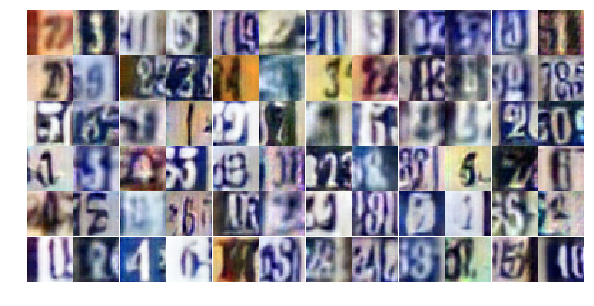

Epoch 18/25... Discriminator Loss: 0.6816... Generator Loss: 1.3800
Epoch 18/25... Discriminator Loss: 0.6416... Generator Loss: 1.1309
Epoch 18/25... Discriminator Loss: 0.6352... Generator Loss: 1.1023
Epoch 18/25... Discriminator Loss: 0.4981... Generator Loss: 1.6629
Epoch 18/25... Discriminator Loss: 0.8360... Generator Loss: 0.8779
Epoch 18/25... Discriminator Loss: 0.6309... Generator Loss: 1.0541
Epoch 18/25... Discriminator Loss: 0.7911... Generator Loss: 0.9041
Epoch 18/25... Discriminator Loss: 1.8203... Generator Loss: 3.1272
Epoch 18/25... Discriminator Loss: 0.8053... Generator Loss: 0.8666
Epoch 18/25... Discriminator Loss: 0.3580... Generator Loss: 1.8593


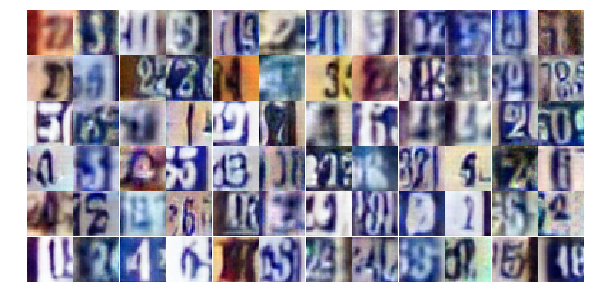

Epoch 18/25... Discriminator Loss: 0.6642... Generator Loss: 1.1037
Epoch 18/25... Discriminator Loss: 0.6483... Generator Loss: 1.4251
Epoch 18/25... Discriminator Loss: 0.6401... Generator Loss: 1.2205
Epoch 18/25... Discriminator Loss: 0.9337... Generator Loss: 0.7346
Epoch 18/25... Discriminator Loss: 0.5893... Generator Loss: 1.1324
Epoch 18/25... Discriminator Loss: 0.6959... Generator Loss: 1.0695
Epoch 18/25... Discriminator Loss: 0.4829... Generator Loss: 1.2769
Epoch 18/25... Discriminator Loss: 0.4598... Generator Loss: 1.6551
Epoch 18/25... Discriminator Loss: 0.8778... Generator Loss: 0.8022
Epoch 18/25... Discriminator Loss: 0.8153... Generator Loss: 0.8111


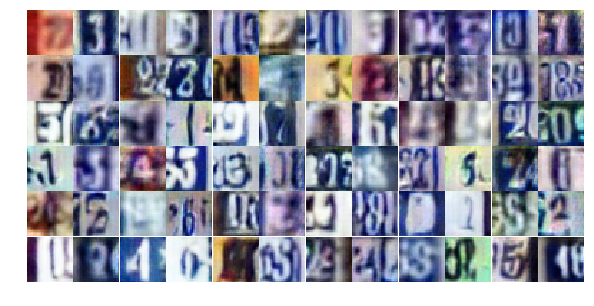

Epoch 18/25... Discriminator Loss: 0.8448... Generator Loss: 3.3343
Epoch 19/25... Discriminator Loss: 1.3151... Generator Loss: 2.7676
Epoch 19/25... Discriminator Loss: 1.3082... Generator Loss: 0.4710
Epoch 19/25... Discriminator Loss: 0.7952... Generator Loss: 0.8925
Epoch 19/25... Discriminator Loss: 0.7327... Generator Loss: 0.9121
Epoch 19/25... Discriminator Loss: 0.9340... Generator Loss: 0.7169
Epoch 19/25... Discriminator Loss: 0.4682... Generator Loss: 1.8147
Epoch 19/25... Discriminator Loss: 1.7243... Generator Loss: 0.3408
Epoch 19/25... Discriminator Loss: 0.7763... Generator Loss: 1.6398
Epoch 19/25... Discriminator Loss: 0.7243... Generator Loss: 1.1397


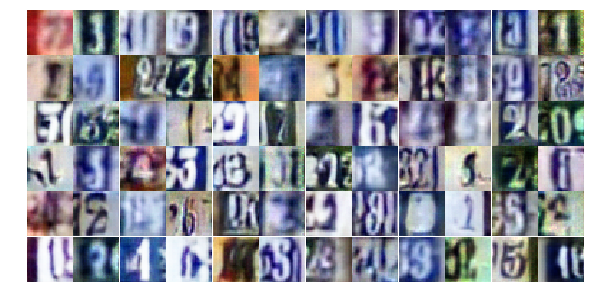

Epoch 19/25... Discriminator Loss: 0.6332... Generator Loss: 1.0443
Epoch 19/25... Discriminator Loss: 0.8696... Generator Loss: 0.8453
Epoch 19/25... Discriminator Loss: 0.7323... Generator Loss: 1.3612
Epoch 19/25... Discriminator Loss: 0.9470... Generator Loss: 0.6979
Epoch 19/25... Discriminator Loss: 0.9696... Generator Loss: 0.6466
Epoch 19/25... Discriminator Loss: 0.5654... Generator Loss: 1.4450
Epoch 19/25... Discriminator Loss: 0.8936... Generator Loss: 0.7793
Epoch 19/25... Discriminator Loss: 0.6120... Generator Loss: 1.1338
Epoch 19/25... Discriminator Loss: 0.6151... Generator Loss: 1.7853
Epoch 19/25... Discriminator Loss: 1.0326... Generator Loss: 0.6846


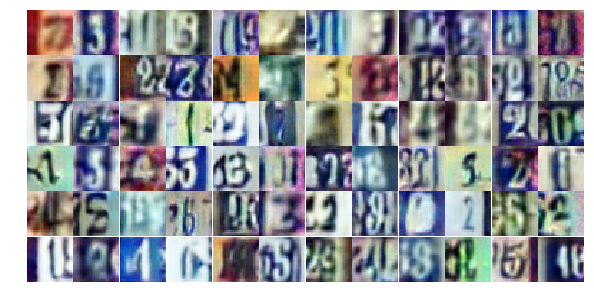

Epoch 19/25... Discriminator Loss: 0.6673... Generator Loss: 0.9880
Epoch 19/25... Discriminator Loss: 1.1443... Generator Loss: 0.6185
Epoch 19/25... Discriminator Loss: 1.4905... Generator Loss: 0.3804
Epoch 19/25... Discriminator Loss: 0.9134... Generator Loss: 0.7432
Epoch 19/25... Discriminator Loss: 1.3919... Generator Loss: 0.4426
Epoch 19/25... Discriminator Loss: 0.7803... Generator Loss: 0.9343
Epoch 19/25... Discriminator Loss: 0.8227... Generator Loss: 0.8152
Epoch 19/25... Discriminator Loss: 0.5309... Generator Loss: 1.3152
Epoch 19/25... Discriminator Loss: 0.7265... Generator Loss: 0.9144
Epoch 19/25... Discriminator Loss: 1.3290... Generator Loss: 0.4008


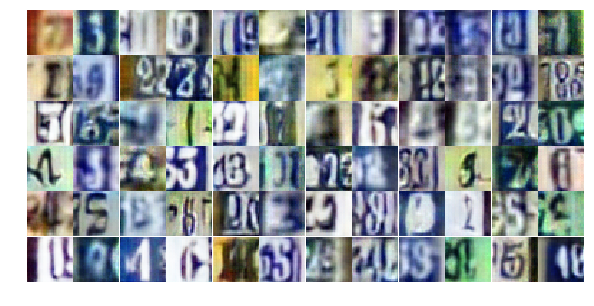

Epoch 19/25... Discriminator Loss: 0.8822... Generator Loss: 0.8044
Epoch 19/25... Discriminator Loss: 1.0480... Generator Loss: 0.6526
Epoch 19/25... Discriminator Loss: 1.2354... Generator Loss: 0.4721
Epoch 19/25... Discriminator Loss: 0.7059... Generator Loss: 0.9571
Epoch 19/25... Discriminator Loss: 0.9116... Generator Loss: 0.8110
Epoch 19/25... Discriminator Loss: 1.1553... Generator Loss: 0.5824
Epoch 19/25... Discriminator Loss: 0.7928... Generator Loss: 0.9930
Epoch 19/25... Discriminator Loss: 0.4709... Generator Loss: 2.2276
Epoch 19/25... Discriminator Loss: 0.8327... Generator Loss: 0.8711
Epoch 19/25... Discriminator Loss: 0.5150... Generator Loss: 1.7193


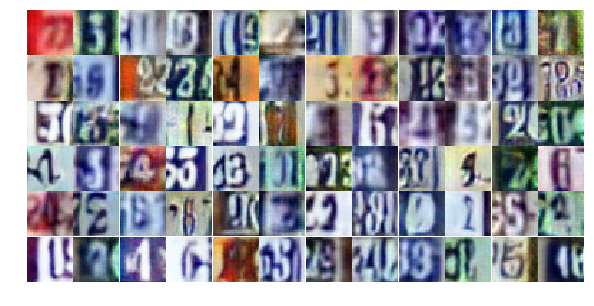

Epoch 19/25... Discriminator Loss: 0.4002... Generator Loss: 1.4700
Epoch 19/25... Discriminator Loss: 1.0015... Generator Loss: 0.7072
Epoch 19/25... Discriminator Loss: 1.0473... Generator Loss: 0.6285
Epoch 19/25... Discriminator Loss: 0.6008... Generator Loss: 1.2156
Epoch 19/25... Discriminator Loss: 1.0476... Generator Loss: 0.6598
Epoch 19/25... Discriminator Loss: 1.7077... Generator Loss: 0.5436
Epoch 19/25... Discriminator Loss: 0.8063... Generator Loss: 1.5198
Epoch 19/25... Discriminator Loss: 0.6770... Generator Loss: 1.1934
Epoch 19/25... Discriminator Loss: 0.6148... Generator Loss: 1.1825
Epoch 19/25... Discriminator Loss: 1.1179... Generator Loss: 0.6308


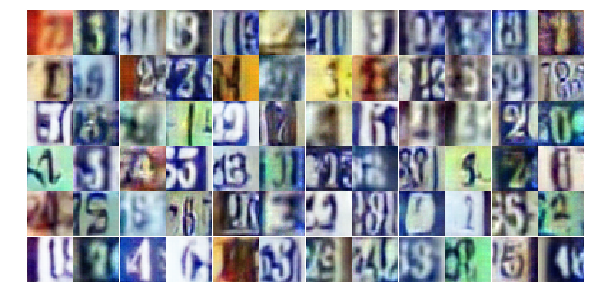

Epoch 19/25... Discriminator Loss: 0.9063... Generator Loss: 0.7341
Epoch 19/25... Discriminator Loss: 0.7485... Generator Loss: 0.9042
Epoch 19/25... Discriminator Loss: 0.5842... Generator Loss: 1.8076
Epoch 19/25... Discriminator Loss: 0.8609... Generator Loss: 0.8001
Epoch 19/25... Discriminator Loss: 0.8449... Generator Loss: 0.8863
Epoch 19/25... Discriminator Loss: 0.7685... Generator Loss: 0.9594
Epoch 19/25... Discriminator Loss: 1.3821... Generator Loss: 0.3794
Epoch 19/25... Discriminator Loss: 0.4704... Generator Loss: 1.7662
Epoch 20/25... Discriminator Loss: 0.7639... Generator Loss: 0.9319
Epoch 20/25... Discriminator Loss: 0.6918... Generator Loss: 1.1446


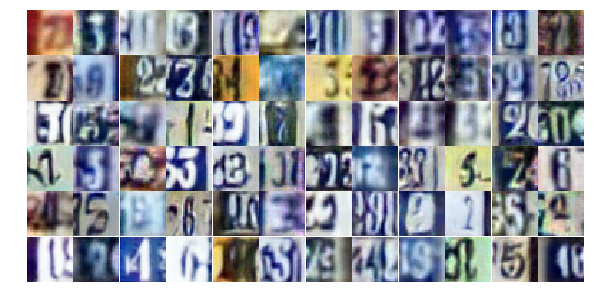

Epoch 20/25... Discriminator Loss: 0.5662... Generator Loss: 1.2583
Epoch 20/25... Discriminator Loss: 0.9302... Generator Loss: 0.7580
Epoch 20/25... Discriminator Loss: 1.2610... Generator Loss: 0.5314
Epoch 20/25... Discriminator Loss: 1.5679... Generator Loss: 0.3503
Epoch 20/25... Discriminator Loss: 0.5011... Generator Loss: 1.2673
Epoch 20/25... Discriminator Loss: 0.5186... Generator Loss: 1.5523
Epoch 20/25... Discriminator Loss: 0.7395... Generator Loss: 1.0695
Epoch 20/25... Discriminator Loss: 0.5824... Generator Loss: 1.4280
Epoch 20/25... Discriminator Loss: 0.7638... Generator Loss: 0.9902
Epoch 20/25... Discriminator Loss: 0.5682... Generator Loss: 1.1823


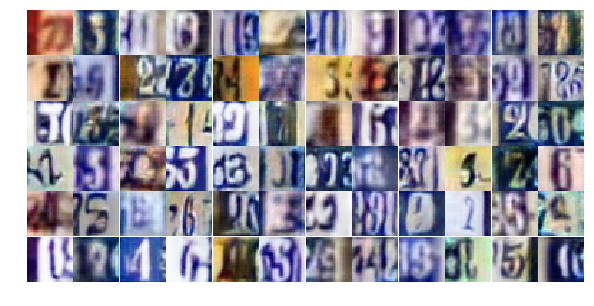

Epoch 20/25... Discriminator Loss: 1.2160... Generator Loss: 0.6296
Epoch 20/25... Discriminator Loss: 0.7552... Generator Loss: 1.2513
Epoch 20/25... Discriminator Loss: 0.6707... Generator Loss: 1.3082
Epoch 20/25... Discriminator Loss: 0.8084... Generator Loss: 2.0689
Epoch 20/25... Discriminator Loss: 1.1234... Generator Loss: 0.5859
Epoch 20/25... Discriminator Loss: 1.7391... Generator Loss: 2.1068
Epoch 20/25... Discriminator Loss: 0.8465... Generator Loss: 0.9750
Epoch 20/25... Discriminator Loss: 0.8310... Generator Loss: 0.8131
Epoch 20/25... Discriminator Loss: 0.5399... Generator Loss: 1.2674
Epoch 20/25... Discriminator Loss: 1.0267... Generator Loss: 0.6689


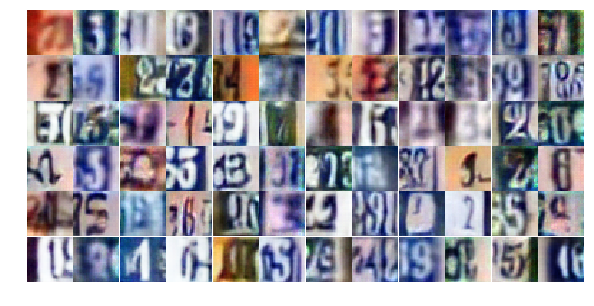

Epoch 20/25... Discriminator Loss: 0.7019... Generator Loss: 1.0234
Epoch 20/25... Discriminator Loss: 0.6594... Generator Loss: 1.0494
Epoch 20/25... Discriminator Loss: 0.3461... Generator Loss: 1.7591
Epoch 20/25... Discriminator Loss: 1.2547... Generator Loss: 0.4993
Epoch 20/25... Discriminator Loss: 1.1458... Generator Loss: 0.6356
Epoch 20/25... Discriminator Loss: 0.4780... Generator Loss: 1.4784
Epoch 20/25... Discriminator Loss: 0.6359... Generator Loss: 1.8997
Epoch 20/25... Discriminator Loss: 1.4347... Generator Loss: 0.4071
Epoch 20/25... Discriminator Loss: 1.2065... Generator Loss: 0.5462
Epoch 20/25... Discriminator Loss: 0.5445... Generator Loss: 1.1542


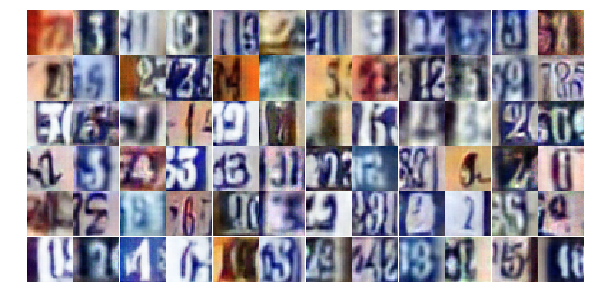

Epoch 20/25... Discriminator Loss: 0.8581... Generator Loss: 0.8417
Epoch 20/25... Discriminator Loss: 0.5112... Generator Loss: 1.2612
Epoch 20/25... Discriminator Loss: 1.6301... Generator Loss: 0.3590
Epoch 20/25... Discriminator Loss: 1.3068... Generator Loss: 0.4895
Epoch 20/25... Discriminator Loss: 1.3074... Generator Loss: 0.5351
Epoch 20/25... Discriminator Loss: 0.6555... Generator Loss: 1.0761
Epoch 20/25... Discriminator Loss: 0.6734... Generator Loss: 1.0158
Epoch 20/25... Discriminator Loss: 0.4763... Generator Loss: 1.5538
Epoch 20/25... Discriminator Loss: 0.7364... Generator Loss: 1.0496
Epoch 20/25... Discriminator Loss: 1.0754... Generator Loss: 0.6594


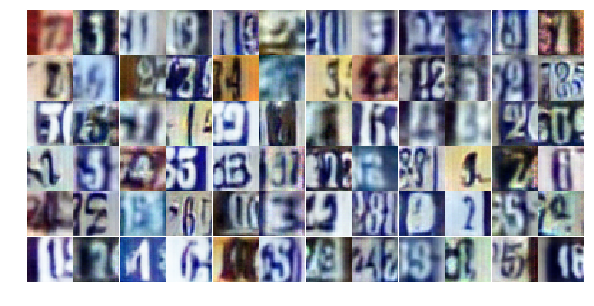

Epoch 20/25... Discriminator Loss: 0.9046... Generator Loss: 0.7725
Epoch 20/25... Discriminator Loss: 0.7506... Generator Loss: 0.9760
Epoch 20/25... Discriminator Loss: 0.6100... Generator Loss: 1.3881
Epoch 20/25... Discriminator Loss: 1.0457... Generator Loss: 0.7647
Epoch 20/25... Discriminator Loss: 0.9742... Generator Loss: 0.7382
Epoch 20/25... Discriminator Loss: 1.1792... Generator Loss: 0.5370
Epoch 20/25... Discriminator Loss: 1.2015... Generator Loss: 0.5731
Epoch 20/25... Discriminator Loss: 0.4272... Generator Loss: 1.4952
Epoch 20/25... Discriminator Loss: 0.5464... Generator Loss: 1.2944
Epoch 20/25... Discriminator Loss: 0.6193... Generator Loss: 1.1365


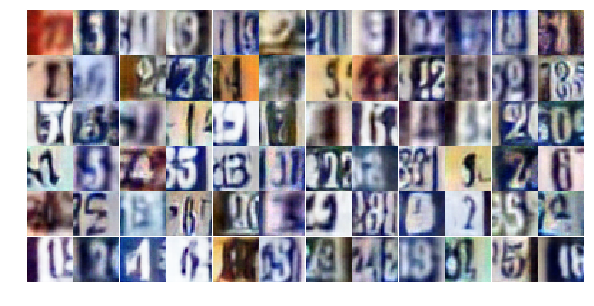

Epoch 20/25... Discriminator Loss: 0.5683... Generator Loss: 1.1865
Epoch 20/25... Discriminator Loss: 0.6160... Generator Loss: 1.6477
Epoch 20/25... Discriminator Loss: 0.4533... Generator Loss: 2.2222
Epoch 20/25... Discriminator Loss: 1.2484... Generator Loss: 0.5670
Epoch 20/25... Discriminator Loss: 0.6635... Generator Loss: 1.2008
Epoch 20/25... Discriminator Loss: 0.5295... Generator Loss: 1.3631
Epoch 21/25... Discriminator Loss: 0.6716... Generator Loss: 1.5885
Epoch 21/25... Discriminator Loss: 0.6684... Generator Loss: 1.3156
Epoch 21/25... Discriminator Loss: 1.3509... Generator Loss: 0.4165
Epoch 21/25... Discriminator Loss: 0.8991... Generator Loss: 0.7737


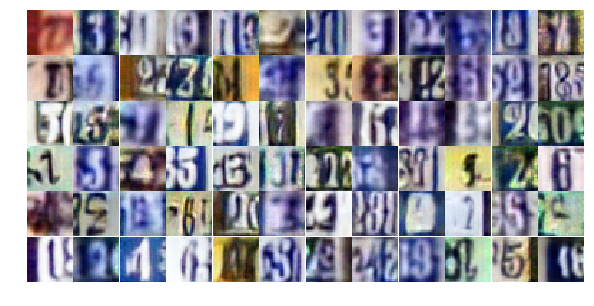

Epoch 21/25... Discriminator Loss: 0.7818... Generator Loss: 0.9979
Epoch 21/25... Discriminator Loss: 1.8040... Generator Loss: 0.2885
Epoch 21/25... Discriminator Loss: 0.3750... Generator Loss: 1.9373
Epoch 21/25... Discriminator Loss: 0.4994... Generator Loss: 1.2555
Epoch 21/25... Discriminator Loss: 0.7172... Generator Loss: 1.0146
Epoch 21/25... Discriminator Loss: 0.6159... Generator Loss: 1.1084
Epoch 21/25... Discriminator Loss: 0.9061... Generator Loss: 0.7994
Epoch 21/25... Discriminator Loss: 1.0926... Generator Loss: 0.5780
Epoch 21/25... Discriminator Loss: 0.5433... Generator Loss: 1.2618
Epoch 21/25... Discriminator Loss: 0.9609... Generator Loss: 0.7371


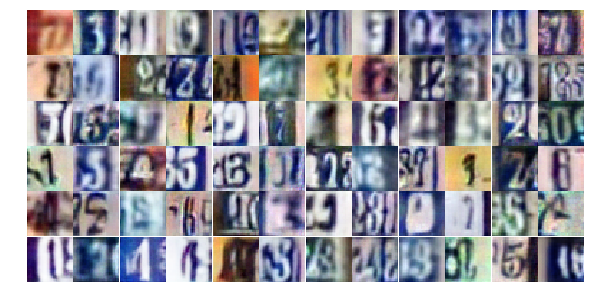

Epoch 21/25... Discriminator Loss: 0.4524... Generator Loss: 1.3906
Epoch 21/25... Discriminator Loss: 0.7630... Generator Loss: 0.8395
Epoch 21/25... Discriminator Loss: 1.8266... Generator Loss: 0.3331
Epoch 21/25... Discriminator Loss: 1.4764... Generator Loss: 3.1743
Epoch 21/25... Discriminator Loss: 1.0797... Generator Loss: 1.0400
Epoch 21/25... Discriminator Loss: 1.9929... Generator Loss: 0.2376
Epoch 21/25... Discriminator Loss: 1.1848... Generator Loss: 0.6037
Epoch 21/25... Discriminator Loss: 0.6184... Generator Loss: 1.3169
Epoch 21/25... Discriminator Loss: 0.7528... Generator Loss: 1.0180
Epoch 21/25... Discriminator Loss: 0.8090... Generator Loss: 0.8697


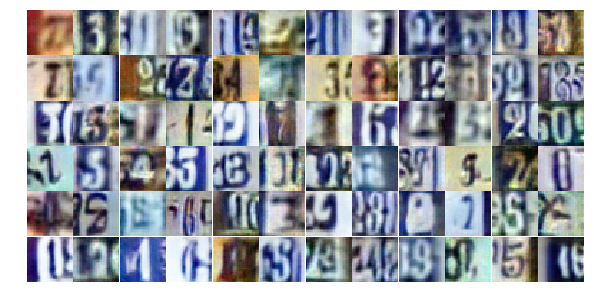

Epoch 21/25... Discriminator Loss: 1.2726... Generator Loss: 0.5024
Epoch 21/25... Discriminator Loss: 0.5015... Generator Loss: 1.4270
Epoch 21/25... Discriminator Loss: 0.8669... Generator Loss: 0.8549
Epoch 21/25... Discriminator Loss: 0.8744... Generator Loss: 0.8746
Epoch 21/25... Discriminator Loss: 0.7402... Generator Loss: 1.7040
Epoch 21/25... Discriminator Loss: 1.2307... Generator Loss: 0.5655
Epoch 21/25... Discriminator Loss: 0.5802... Generator Loss: 1.2062
Epoch 21/25... Discriminator Loss: 1.2219... Generator Loss: 0.5572
Epoch 21/25... Discriminator Loss: 1.1344... Generator Loss: 0.5233
Epoch 21/25... Discriminator Loss: 1.3379... Generator Loss: 0.4827


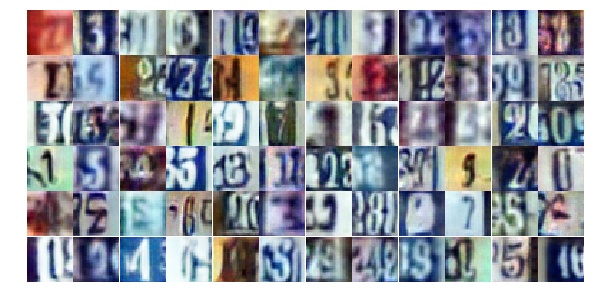

Epoch 21/25... Discriminator Loss: 1.2188... Generator Loss: 0.4917
Epoch 21/25... Discriminator Loss: 0.7220... Generator Loss: 0.9731
Epoch 21/25... Discriminator Loss: 1.3499... Generator Loss: 0.4185
Epoch 21/25... Discriminator Loss: 0.3962... Generator Loss: 1.6653
Epoch 21/25... Discriminator Loss: 0.5388... Generator Loss: 1.3672
Epoch 21/25... Discriminator Loss: 0.6751... Generator Loss: 1.0170
Epoch 21/25... Discriminator Loss: 0.6268... Generator Loss: 1.4012
Epoch 21/25... Discriminator Loss: 1.0647... Generator Loss: 0.6253
Epoch 21/25... Discriminator Loss: 0.6052... Generator Loss: 1.1263
Epoch 21/25... Discriminator Loss: 0.3600... Generator Loss: 1.8445


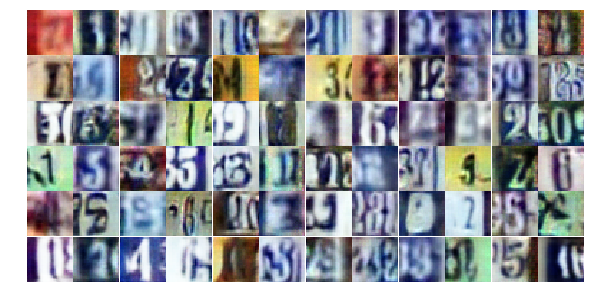

Epoch 21/25... Discriminator Loss: 1.0816... Generator Loss: 0.6152
Epoch 21/25... Discriminator Loss: 1.4270... Generator Loss: 0.4522
Epoch 21/25... Discriminator Loss: 0.9626... Generator Loss: 0.6838
Epoch 21/25... Discriminator Loss: 0.7158... Generator Loss: 1.0349
Epoch 21/25... Discriminator Loss: 0.4731... Generator Loss: 1.3682
Epoch 21/25... Discriminator Loss: 0.7285... Generator Loss: 1.0796
Epoch 21/25... Discriminator Loss: 0.8778... Generator Loss: 0.7852
Epoch 21/25... Discriminator Loss: 1.1983... Generator Loss: 0.6142
Epoch 21/25... Discriminator Loss: 1.0306... Generator Loss: 0.7156
Epoch 21/25... Discriminator Loss: 0.5091... Generator Loss: 1.3332


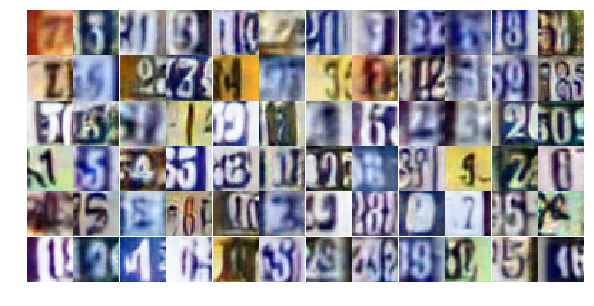

Epoch 21/25... Discriminator Loss: 0.5101... Generator Loss: 1.7553
Epoch 21/25... Discriminator Loss: 0.6080... Generator Loss: 1.6955
Epoch 21/25... Discriminator Loss: 0.6674... Generator Loss: 1.1665
Epoch 22/25... Discriminator Loss: 0.8583... Generator Loss: 2.1216
Epoch 22/25... Discriminator Loss: 0.8786... Generator Loss: 0.9017
Epoch 22/25... Discriminator Loss: 0.7527... Generator Loss: 0.9371
Epoch 22/25... Discriminator Loss: 0.5610... Generator Loss: 1.3261
Epoch 22/25... Discriminator Loss: 0.4708... Generator Loss: 1.4316
Epoch 22/25... Discriminator Loss: 0.8780... Generator Loss: 0.8174
Epoch 22/25... Discriminator Loss: 0.7272... Generator Loss: 1.0472


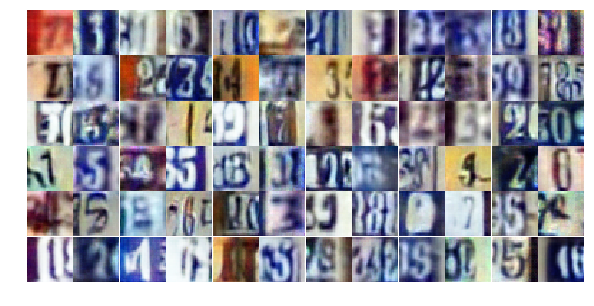

Epoch 22/25... Discriminator Loss: 0.5256... Generator Loss: 1.5073
Epoch 22/25... Discriminator Loss: 0.6903... Generator Loss: 1.1273
Epoch 22/25... Discriminator Loss: 1.3462... Generator Loss: 0.4862
Epoch 22/25... Discriminator Loss: 0.5105... Generator Loss: 1.3675
Epoch 22/25... Discriminator Loss: 1.0108... Generator Loss: 0.6781
Epoch 22/25... Discriminator Loss: 0.5397... Generator Loss: 1.2403
Epoch 22/25... Discriminator Loss: 0.6816... Generator Loss: 0.9666
Epoch 22/25... Discriminator Loss: 0.5737... Generator Loss: 1.1230
Epoch 22/25... Discriminator Loss: 0.8127... Generator Loss: 0.8813
Epoch 22/25... Discriminator Loss: 1.8801... Generator Loss: 0.2481


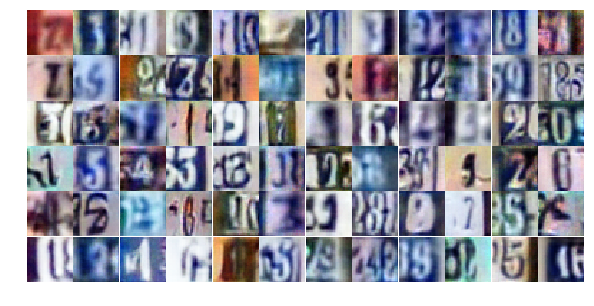

Epoch 22/25... Discriminator Loss: 0.6991... Generator Loss: 3.0374
Epoch 22/25... Discriminator Loss: 0.4679... Generator Loss: 1.6032
Epoch 22/25... Discriminator Loss: 1.0954... Generator Loss: 0.6579
Epoch 22/25... Discriminator Loss: 0.5052... Generator Loss: 1.3401
Epoch 22/25... Discriminator Loss: 0.6809... Generator Loss: 3.0790
Epoch 22/25... Discriminator Loss: 1.2000... Generator Loss: 0.6117
Epoch 22/25... Discriminator Loss: 0.6488... Generator Loss: 1.5378
Epoch 22/25... Discriminator Loss: 0.4926... Generator Loss: 1.2877
Epoch 22/25... Discriminator Loss: 0.4543... Generator Loss: 1.5241
Epoch 22/25... Discriminator Loss: 1.0611... Generator Loss: 0.6787


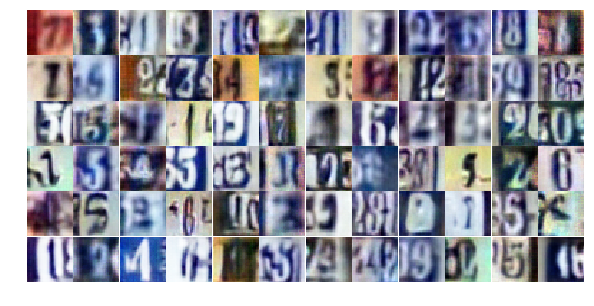

Epoch 22/25... Discriminator Loss: 0.3980... Generator Loss: 1.7335
Epoch 22/25... Discriminator Loss: 0.4598... Generator Loss: 1.6393
Epoch 22/25... Discriminator Loss: 0.7002... Generator Loss: 1.8683
Epoch 22/25... Discriminator Loss: 0.7671... Generator Loss: 0.8774
Epoch 22/25... Discriminator Loss: 1.0279... Generator Loss: 0.6315
Epoch 22/25... Discriminator Loss: 1.0143... Generator Loss: 0.6566
Epoch 22/25... Discriminator Loss: 1.5131... Generator Loss: 0.4018
Epoch 22/25... Discriminator Loss: 0.5820... Generator Loss: 1.1642
Epoch 22/25... Discriminator Loss: 1.1625... Generator Loss: 0.6544
Epoch 22/25... Discriminator Loss: 1.1840... Generator Loss: 0.5521


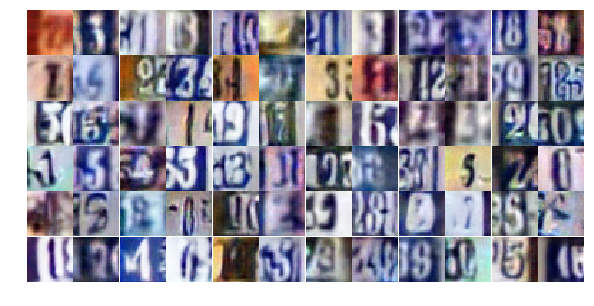

Epoch 22/25... Discriminator Loss: 0.7522... Generator Loss: 0.9551
Epoch 22/25... Discriminator Loss: 0.4639... Generator Loss: 1.4316
Epoch 22/25... Discriminator Loss: 0.4654... Generator Loss: 1.3225
Epoch 22/25... Discriminator Loss: 0.8511... Generator Loss: 0.7849
Epoch 22/25... Discriminator Loss: 0.4080... Generator Loss: 1.4523
Epoch 22/25... Discriminator Loss: 0.4823... Generator Loss: 1.3002
Epoch 22/25... Discriminator Loss: 0.6298... Generator Loss: 1.3923
Epoch 22/25... Discriminator Loss: 1.3052... Generator Loss: 0.4618
Epoch 22/25... Discriminator Loss: 1.1046... Generator Loss: 0.8201
Epoch 22/25... Discriminator Loss: 1.1924... Generator Loss: 0.5679


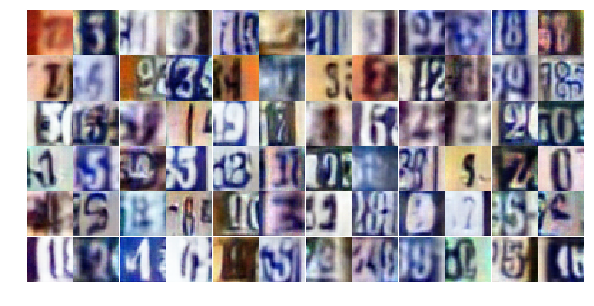

Epoch 22/25... Discriminator Loss: 0.9308... Generator Loss: 0.7649
Epoch 22/25... Discriminator Loss: 0.4801... Generator Loss: 2.5662
Epoch 22/25... Discriminator Loss: 0.8164... Generator Loss: 0.8705
Epoch 22/25... Discriminator Loss: 0.7208... Generator Loss: 1.0822
Epoch 22/25... Discriminator Loss: 0.6097... Generator Loss: 1.0696
Epoch 22/25... Discriminator Loss: 0.7671... Generator Loss: 1.0064
Epoch 22/25... Discriminator Loss: 1.3710... Generator Loss: 0.4833
Epoch 22/25... Discriminator Loss: 0.6621... Generator Loss: 1.0696
Epoch 22/25... Discriminator Loss: 0.7955... Generator Loss: 1.8921
Epoch 22/25... Discriminator Loss: 0.6393... Generator Loss: 1.1306


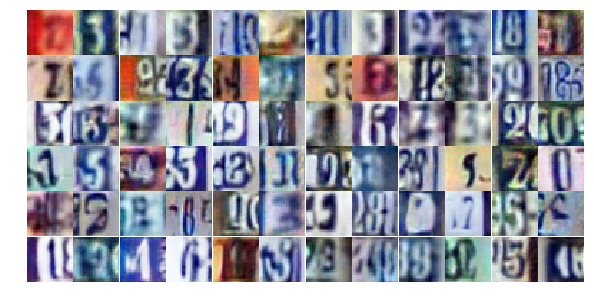

Epoch 23/25... Discriminator Loss: 0.5109... Generator Loss: 1.3240
Epoch 23/25... Discriminator Loss: 0.3987... Generator Loss: 1.6297
Epoch 23/25... Discriminator Loss: 0.6115... Generator Loss: 1.1176
Epoch 23/25... Discriminator Loss: 0.7998... Generator Loss: 0.7930
Epoch 23/25... Discriminator Loss: 1.0441... Generator Loss: 0.6253
Epoch 23/25... Discriminator Loss: 1.0731... Generator Loss: 0.6713
Epoch 23/25... Discriminator Loss: 0.8853... Generator Loss: 0.8326
Epoch 23/25... Discriminator Loss: 0.6401... Generator Loss: 1.0103
Epoch 23/25... Discriminator Loss: 0.7366... Generator Loss: 0.9532
Epoch 23/25... Discriminator Loss: 0.3732... Generator Loss: 1.7059


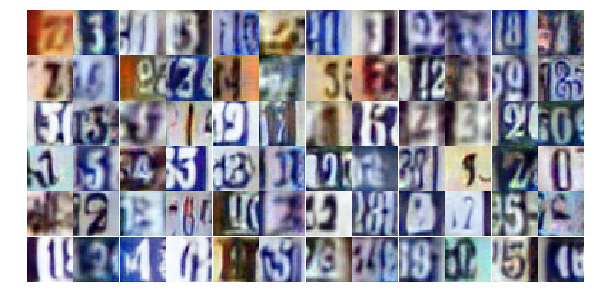

Epoch 23/25... Discriminator Loss: 0.6347... Generator Loss: 1.1350
Epoch 23/25... Discriminator Loss: 0.9180... Generator Loss: 0.7347
Epoch 23/25... Discriminator Loss: 0.8012... Generator Loss: 0.8908
Epoch 23/25... Discriminator Loss: 0.5899... Generator Loss: 2.2804
Epoch 23/25... Discriminator Loss: 0.4638... Generator Loss: 1.3770
Epoch 23/25... Discriminator Loss: 0.9524... Generator Loss: 0.7456
Epoch 23/25... Discriminator Loss: 0.9005... Generator Loss: 0.7828
Epoch 23/25... Discriminator Loss: 0.5661... Generator Loss: 2.0134
Epoch 23/25... Discriminator Loss: 0.7806... Generator Loss: 0.9564
Epoch 23/25... Discriminator Loss: 0.7236... Generator Loss: 0.9818


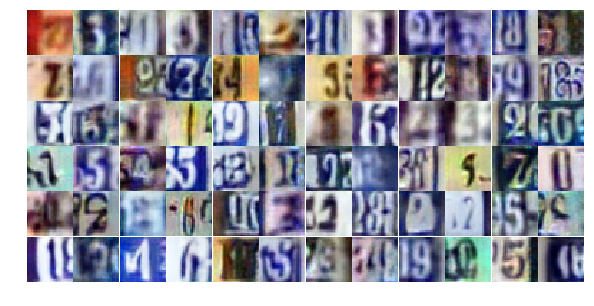

Epoch 23/25... Discriminator Loss: 1.5566... Generator Loss: 0.4148
Epoch 23/25... Discriminator Loss: 0.4933... Generator Loss: 1.2794
Epoch 23/25... Discriminator Loss: 1.1335... Generator Loss: 0.5885
Epoch 23/25... Discriminator Loss: 0.8608... Generator Loss: 0.8076
Epoch 23/25... Discriminator Loss: 0.7713... Generator Loss: 1.0824
Epoch 23/25... Discriminator Loss: 0.6064... Generator Loss: 1.3500
Epoch 23/25... Discriminator Loss: 0.6866... Generator Loss: 0.9720
Epoch 23/25... Discriminator Loss: 0.8980... Generator Loss: 0.7451
Epoch 23/25... Discriminator Loss: 0.5271... Generator Loss: 1.4687
Epoch 23/25... Discriminator Loss: 0.8510... Generator Loss: 1.2800


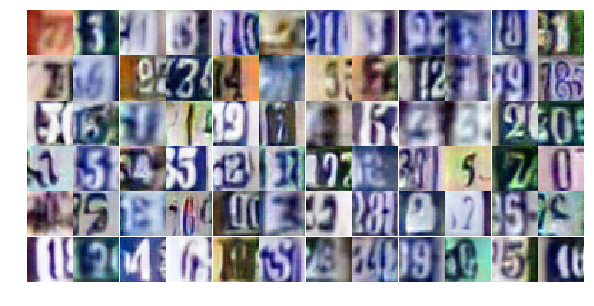

Epoch 23/25... Discriminator Loss: 0.6304... Generator Loss: 1.0549
Epoch 23/25... Discriminator Loss: 0.4601... Generator Loss: 1.4539
Epoch 23/25... Discriminator Loss: 0.6978... Generator Loss: 1.1730
Epoch 23/25... Discriminator Loss: 1.2624... Generator Loss: 0.5242
Epoch 23/25... Discriminator Loss: 1.1924... Generator Loss: 0.5957
Epoch 23/25... Discriminator Loss: 0.8545... Generator Loss: 0.8286
Epoch 23/25... Discriminator Loss: 1.2342... Generator Loss: 0.5069
Epoch 23/25... Discriminator Loss: 0.7010... Generator Loss: 1.1469
Epoch 23/25... Discriminator Loss: 0.8591... Generator Loss: 1.0038
Epoch 23/25... Discriminator Loss: 0.5097... Generator Loss: 1.3142


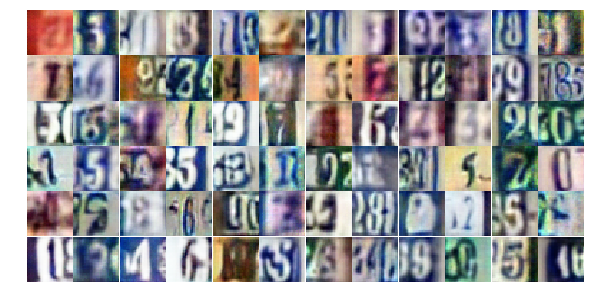

Epoch 23/25... Discriminator Loss: 0.8225... Generator Loss: 0.9558
Epoch 23/25... Discriminator Loss: 0.6172... Generator Loss: 1.1755
Epoch 23/25... Discriminator Loss: 1.2791... Generator Loss: 0.4953
Epoch 23/25... Discriminator Loss: 0.5141... Generator Loss: 1.4752
Epoch 23/25... Discriminator Loss: 1.1696... Generator Loss: 2.9799
Epoch 23/25... Discriminator Loss: 1.7550... Generator Loss: 3.6825
Epoch 23/25... Discriminator Loss: 1.2553... Generator Loss: 0.6175
Epoch 23/25... Discriminator Loss: 0.8721... Generator Loss: 1.1686
Epoch 23/25... Discriminator Loss: 0.8430... Generator Loss: 1.1814
Epoch 23/25... Discriminator Loss: 0.8054... Generator Loss: 0.8991


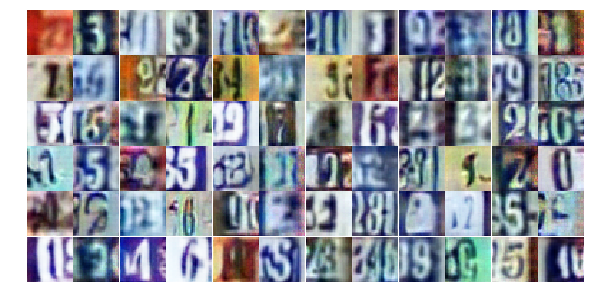

Epoch 23/25... Discriminator Loss: 0.8201... Generator Loss: 0.9669
Epoch 23/25... Discriminator Loss: 0.8241... Generator Loss: 0.8702
Epoch 23/25... Discriminator Loss: 1.2188... Generator Loss: 0.6304
Epoch 23/25... Discriminator Loss: 0.5111... Generator Loss: 1.2588
Epoch 23/25... Discriminator Loss: 0.9037... Generator Loss: 0.7237
Epoch 23/25... Discriminator Loss: 0.5463... Generator Loss: 1.4891
Epoch 23/25... Discriminator Loss: 0.9776... Generator Loss: 1.1076
Epoch 24/25... Discriminator Loss: 1.0385... Generator Loss: 0.6470
Epoch 24/25... Discriminator Loss: 0.6143... Generator Loss: 1.3149
Epoch 24/25... Discriminator Loss: 0.7530... Generator Loss: 1.4305


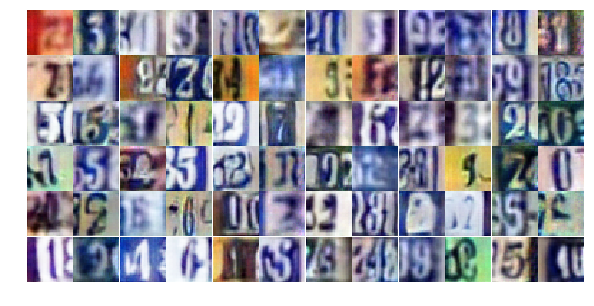

Epoch 24/25... Discriminator Loss: 0.5162... Generator Loss: 1.2457
Epoch 24/25... Discriminator Loss: 0.6276... Generator Loss: 1.1228
Epoch 24/25... Discriminator Loss: 0.8543... Generator Loss: 0.8223
Epoch 24/25... Discriminator Loss: 1.0763... Generator Loss: 0.7225
Epoch 24/25... Discriminator Loss: 0.7710... Generator Loss: 0.9455
Epoch 24/25... Discriminator Loss: 0.5251... Generator Loss: 1.4917
Epoch 24/25... Discriminator Loss: 0.8438... Generator Loss: 0.8080
Epoch 24/25... Discriminator Loss: 1.6205... Generator Loss: 0.3252
Epoch 24/25... Discriminator Loss: 0.3522... Generator Loss: 1.6399
Epoch 24/25... Discriminator Loss: 0.4439... Generator Loss: 1.6066


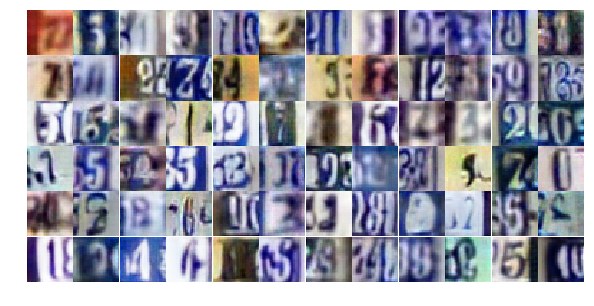

Epoch 24/25... Discriminator Loss: 0.9268... Generator Loss: 0.7646
Epoch 24/25... Discriminator Loss: 1.1661... Generator Loss: 0.5563
Epoch 24/25... Discriminator Loss: 1.1233... Generator Loss: 0.6314
Epoch 24/25... Discriminator Loss: 0.3804... Generator Loss: 1.4900
Epoch 24/25... Discriminator Loss: 0.5772... Generator Loss: 2.6068
Epoch 24/25... Discriminator Loss: 0.8939... Generator Loss: 1.0522
Epoch 24/25... Discriminator Loss: 0.4453... Generator Loss: 1.8879
Epoch 24/25... Discriminator Loss: 0.8865... Generator Loss: 0.8277
Epoch 24/25... Discriminator Loss: 0.7803... Generator Loss: 1.0042
Epoch 24/25... Discriminator Loss: 0.7719... Generator Loss: 1.1979


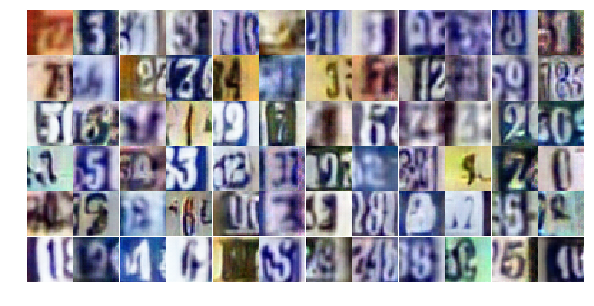

Epoch 24/25... Discriminator Loss: 0.8166... Generator Loss: 0.8467
Epoch 24/25... Discriminator Loss: 0.6196... Generator Loss: 1.0630
Epoch 24/25... Discriminator Loss: 0.5792... Generator Loss: 1.0916
Epoch 24/25... Discriminator Loss: 1.1949... Generator Loss: 0.6195
Epoch 24/25... Discriminator Loss: 0.3928... Generator Loss: 1.7025
Epoch 24/25... Discriminator Loss: 0.5268... Generator Loss: 1.2716
Epoch 24/25... Discriminator Loss: 0.3111... Generator Loss: 1.6924
Epoch 24/25... Discriminator Loss: 0.7067... Generator Loss: 1.1311
Epoch 24/25... Discriminator Loss: 0.7462... Generator Loss: 1.0004
Epoch 24/25... Discriminator Loss: 0.9033... Generator Loss: 0.8868


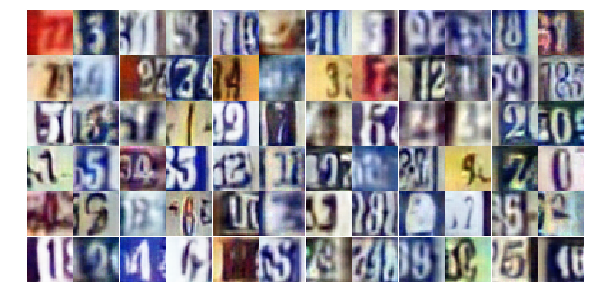

Epoch 24/25... Discriminator Loss: 0.5737... Generator Loss: 1.1673
Epoch 24/25... Discriminator Loss: 0.3794... Generator Loss: 1.7232
Epoch 24/25... Discriminator Loss: 0.8673... Generator Loss: 0.8610
Epoch 24/25... Discriminator Loss: 1.7293... Generator Loss: 0.2900
Epoch 24/25... Discriminator Loss: 1.1635... Generator Loss: 0.5197
Epoch 24/25... Discriminator Loss: 0.8199... Generator Loss: 0.8225
Epoch 24/25... Discriminator Loss: 1.1833... Generator Loss: 0.5395
Epoch 24/25... Discriminator Loss: 0.7548... Generator Loss: 0.8740
Epoch 24/25... Discriminator Loss: 0.6703... Generator Loss: 1.1806
Epoch 24/25... Discriminator Loss: 0.7123... Generator Loss: 1.3475


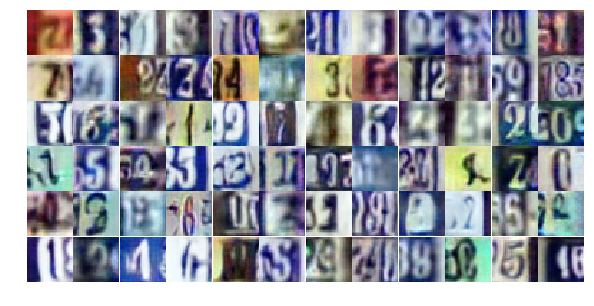

Epoch 24/25... Discriminator Loss: 0.7188... Generator Loss: 1.0201
Epoch 24/25... Discriminator Loss: 1.9990... Generator Loss: 0.3219
Epoch 24/25... Discriminator Loss: 0.8094... Generator Loss: 1.1783
Epoch 24/25... Discriminator Loss: 1.0889... Generator Loss: 2.6390
Epoch 24/25... Discriminator Loss: 2.8884... Generator Loss: 0.1325
Epoch 24/25... Discriminator Loss: 0.6845... Generator Loss: 1.3919
Epoch 24/25... Discriminator Loss: 0.9000... Generator Loss: 0.8229
Epoch 24/25... Discriminator Loss: 0.6384... Generator Loss: 1.1817
Epoch 24/25... Discriminator Loss: 1.0664... Generator Loss: 0.5975
Epoch 24/25... Discriminator Loss: 1.0619... Generator Loss: 0.7289


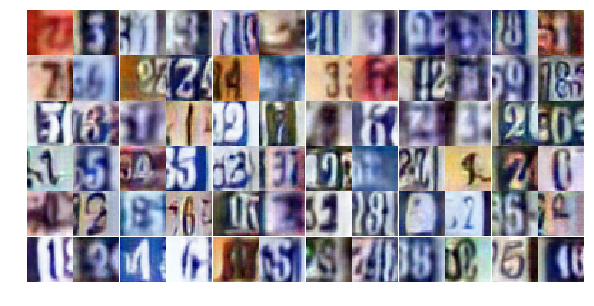

Epoch 24/25... Discriminator Loss: 1.1679... Generator Loss: 0.5641
Epoch 24/25... Discriminator Loss: 1.8057... Generator Loss: 0.3155
Epoch 24/25... Discriminator Loss: 1.0774... Generator Loss: 0.5775
Epoch 24/25... Discriminator Loss: 0.6783... Generator Loss: 1.0842
Epoch 24/25... Discriminator Loss: 1.1186... Generator Loss: 0.5737
Epoch 25/25... Discriminator Loss: 0.5507... Generator Loss: 1.5220
Epoch 25/25... Discriminator Loss: 0.5427... Generator Loss: 1.3515
Epoch 25/25... Discriminator Loss: 0.6600... Generator Loss: 1.1642
Epoch 25/25... Discriminator Loss: 0.8817... Generator Loss: 0.7949
Epoch 25/25... Discriminator Loss: 1.0466... Generator Loss: 0.6589


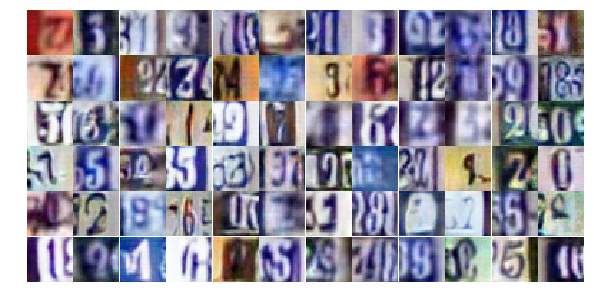

Epoch 25/25... Discriminator Loss: 1.0376... Generator Loss: 0.6998
Epoch 25/25... Discriminator Loss: 1.3750... Generator Loss: 0.4434
Epoch 25/25... Discriminator Loss: 0.7602... Generator Loss: 0.8251
Epoch 25/25... Discriminator Loss: 0.6491... Generator Loss: 1.3034
Epoch 25/25... Discriminator Loss: 0.8829... Generator Loss: 0.8281
Epoch 25/25... Discriminator Loss: 0.7742... Generator Loss: 0.9143
Epoch 25/25... Discriminator Loss: 0.6785... Generator Loss: 1.0735
Epoch 25/25... Discriminator Loss: 0.8073... Generator Loss: 0.9684
Epoch 25/25... Discriminator Loss: 0.4322... Generator Loss: 1.6396
Epoch 25/25... Discriminator Loss: 0.9180... Generator Loss: 0.7454


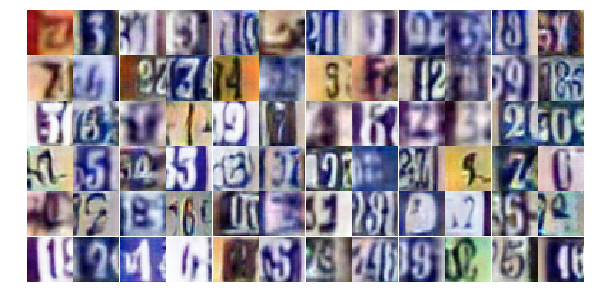

Epoch 25/25... Discriminator Loss: 0.5938... Generator Loss: 1.3809
Epoch 25/25... Discriminator Loss: 0.6499... Generator Loss: 2.9810
Epoch 25/25... Discriminator Loss: 1.1513... Generator Loss: 0.5222
Epoch 25/25... Discriminator Loss: 0.8634... Generator Loss: 0.8872
Epoch 25/25... Discriminator Loss: 0.7596... Generator Loss: 0.9367
Epoch 25/25... Discriminator Loss: 0.4289... Generator Loss: 1.6704
Epoch 25/25... Discriminator Loss: 0.7590... Generator Loss: 0.9493
Epoch 25/25... Discriminator Loss: 0.7880... Generator Loss: 0.9560
Epoch 25/25... Discriminator Loss: 0.3660... Generator Loss: 1.7463
Epoch 25/25... Discriminator Loss: 0.7481... Generator Loss: 0.9704


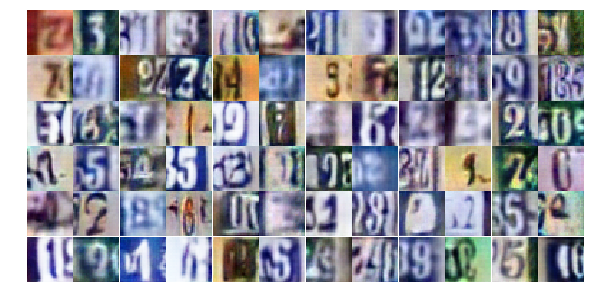

Epoch 25/25... Discriminator Loss: 0.9964... Generator Loss: 0.6479
Epoch 25/25... Discriminator Loss: 0.6661... Generator Loss: 1.0408
Epoch 25/25... Discriminator Loss: 1.0504... Generator Loss: 0.7478
Epoch 25/25... Discriminator Loss: 0.6100... Generator Loss: 1.2878
Epoch 25/25... Discriminator Loss: 1.0369... Generator Loss: 0.6247
Epoch 25/25... Discriminator Loss: 0.6642... Generator Loss: 0.9662
Epoch 25/25... Discriminator Loss: 0.9088... Generator Loss: 0.8697
Epoch 25/25... Discriminator Loss: 1.0327... Generator Loss: 0.6279
Epoch 25/25... Discriminator Loss: 0.9063... Generator Loss: 0.7031
Epoch 25/25... Discriminator Loss: 0.5231... Generator Loss: 1.4548


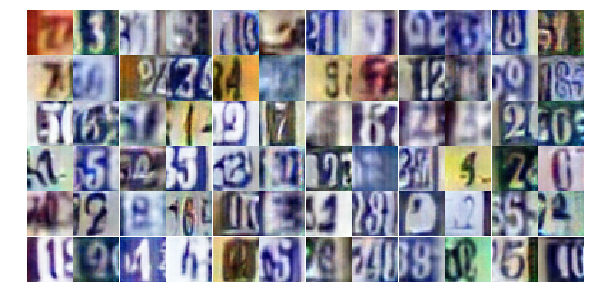

Epoch 25/25... Discriminator Loss: 2.5648... Generator Loss: 0.3729
Epoch 25/25... Discriminator Loss: 0.9323... Generator Loss: 3.0726
Epoch 25/25... Discriminator Loss: 1.1190... Generator Loss: 0.6365
Epoch 25/25... Discriminator Loss: 0.6134... Generator Loss: 1.1939
Epoch 25/25... Discriminator Loss: 1.0577... Generator Loss: 0.7010
Epoch 25/25... Discriminator Loss: 1.1203... Generator Loss: 0.6727
Epoch 25/25... Discriminator Loss: 0.6210... Generator Loss: 1.3021
Epoch 25/25... Discriminator Loss: 0.6946... Generator Loss: 1.0985
Epoch 25/25... Discriminator Loss: 1.4872... Generator Loss: 0.3867
Epoch 25/25... Discriminator Loss: 0.5659... Generator Loss: 1.2831


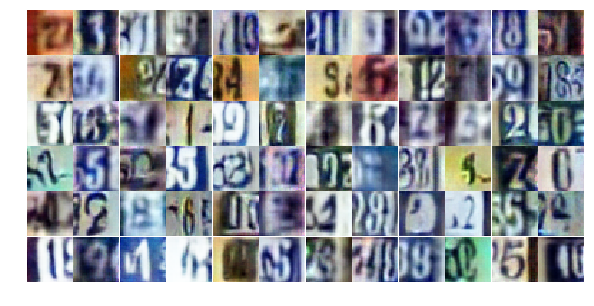

Epoch 25/25... Discriminator Loss: 0.9893... Generator Loss: 0.7180
Epoch 25/25... Discriminator Loss: 0.7230... Generator Loss: 0.9312
Epoch 25/25... Discriminator Loss: 0.8426... Generator Loss: 0.9278
Epoch 25/25... Discriminator Loss: 0.8263... Generator Loss: 0.8267
Epoch 25/25... Discriminator Loss: 0.7637... Generator Loss: 0.9761
Epoch 25/25... Discriminator Loss: 0.5445... Generator Loss: 1.1866
Epoch 25/25... Discriminator Loss: 0.9773... Generator Loss: 0.6854
Epoch 25/25... Discriminator Loss: 0.7662... Generator Loss: 0.9884


In [ ]:
# Load the data and train the network here
dataset = Dataset(trainset, testset)
losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

In [ ]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

In [ ]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))